In [1]:
%load_ext autoreload
%autoreload 2
import sys
import os
sys.path.insert(0, 'Pytorch-UNet')
sys.path.insert(0, 'utils')
sys.path.insert(0, 'models')
from vae_model_large import VAE, loss_function

# import tensorflow_hub as hub
# import tensorflow as tf
import numpy as np
import wandb
import matplotlib.pyplot as plt
import numpy as np
import torch
import argparse
from plotting_utils import plot_pytorch_images, make_grid
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torchvision

from misc import merge
from unet.unet_model import UNet
from torch.nn import functional as F

from tempfile import mkdtemp
import os.path as path

torch.manual_seed(0);

In [2]:
parser = argparse.ArgumentParser()
parser.add_argument("--num_datapoints", help="num datapoints", default=10000, type=int)
parser.add_argument("--z_dim", help="z dimension", default=85, type=int)
parser.add_argument("--device", help="gpu id", default=0, type=int)
parser.add_argument("--nb_epochs", help="number of epochs", default=500, type=int)
parser.add_argument("--start_epoch", help="epoch to start training from (requires checkpoints)", default=0, type=int)
parser.add_argument("--save_interval", help="epochs to save model", default=10, type=int)
parser.add_argument("--run_seed", help="run seed of TCVAE", default=100, type=int)
parser.add_argument("--lr", help="learning rate", default=.0001, type=float)
parser.add_argument("--wd", help="weight decay", default=4e-3, type=float)
parser.add_argument("--low_resolution", help="low resolution", default=32, type=int)
parser.add_argument("--resolution", help="resolution", default=64, type=int)
parser.add_argument("--batch_size", help="batch size", default=32, type=int)
parser.add_argument("--has_validation", help="If True, will use validation set", default=True, type=bool)
parser.add_argument("--validation_size", help="Validation set size", default=1000, type=int)

args = parser.parse_args([])
num_datapoints=args.num_datapoints
resolution = args.resolution
device = args.device

log = True
if log:
    wandb.init(project="UNET_imagenet", name="UNET_imagenet_{}-->{}".format(args.low_resolution, args.resolution))
    wandb.config.update(args)


# device = torch.device("cuda:0" if (torch.cuda.is_available() and args.device > -1) else "cpu")
print("z_dim: {}".format(args.z_dim))
print("GPU: {}".format(device))
print("start_epoch: {}".format(args.start_epoch))
print("save_interval: {}".format(args.save_interval))

wandb: Wandb version 0.8.34 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


z_dim: 85
GPU: 0
start_epoch: 0
save_interval: 10


In [6]:
dataroot="/hdd/imagenet/10c/"
num_samples = num_datapoints + args.validation_size

full_dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(256),
                               transforms.CenterCrop(256),
                               transforms.ToTensor()
                           ]))
# torch_data_loader = torch.utils.data.DataLoader(full_dataset, batch_size=32, shuffle=True, num_workers=4, drop_last=True)


torch_dataset,torch_val_dataset,_ = torch.utils.data.random_split(full_dataset, [num_datapoints,args.validation_size,full_dataset.__len__()-num_samples])
print(full_dataset)
torch_data_loader = torch.utils.data.DataLoader(torch_dataset, batch_size=args.batch_size, shuffle=True, num_workers=4, drop_last=True)

if args.has_validation:
    torch_val_data_loader = torch.utils.data.DataLoader(torch_val_dataset, batch_size=args.batch_size, drop_last=True, shuffle=False)
    


Dataset ImageFolder
    Number of datapoints: 11593
    Root location: /hdd/imagenet/10c/
    StandardTransform
Transform: Compose(
               Resize(size=256, interpolation=PIL.Image.BILINEAR)
               CenterCrop(size=(256, 256))
               ToTensor()
           )


# Instantiating and Training DSVAE

In [21]:
model = UNet(n_channels=3, n_classes=3, bilinear=True)
optimizer = torch.optim.Adam(params=model.parameters(), lr=args.lr, weight_decay=0)

Training for 500 epochs...


wandb: Wandb version 0.8.34 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade
/root/anaconda3/envs/tensorflow_gpu/lib/python3.7/site-packages/torch/nn/functional.py:2506: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


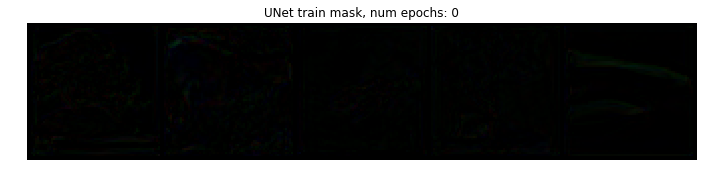

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


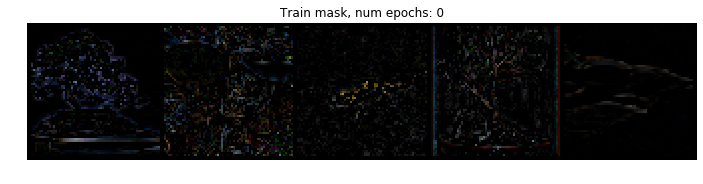

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


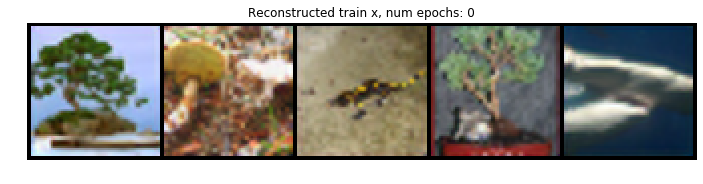

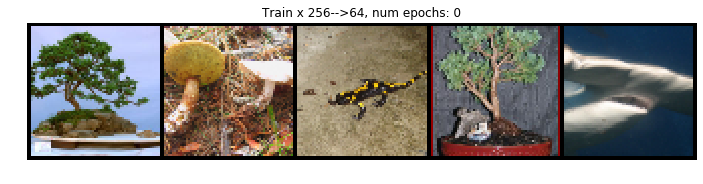

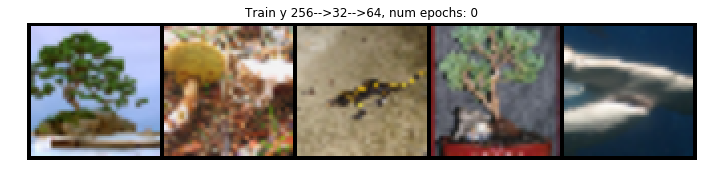

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


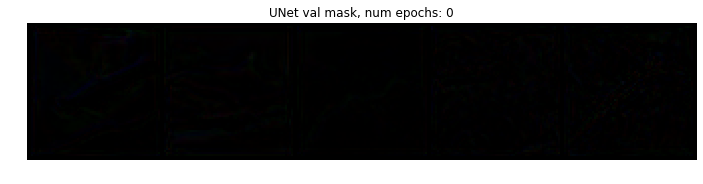

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


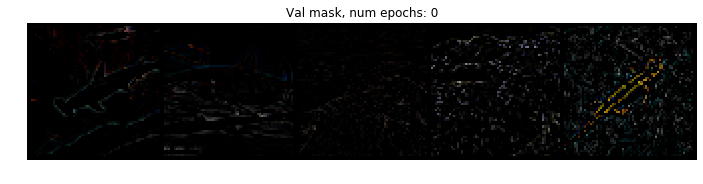

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


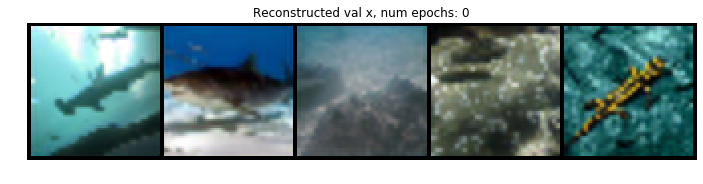

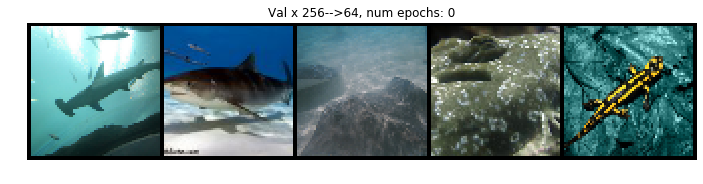

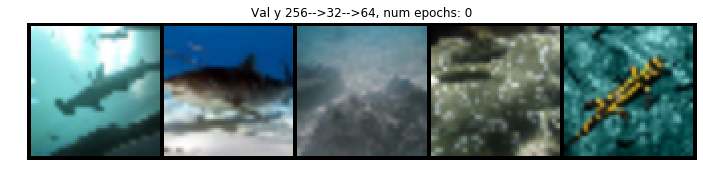

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


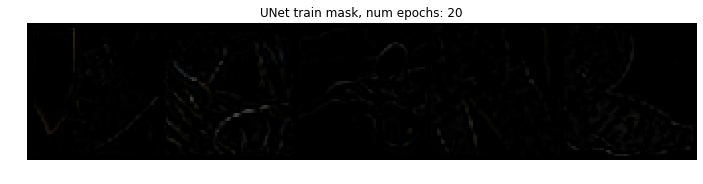

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


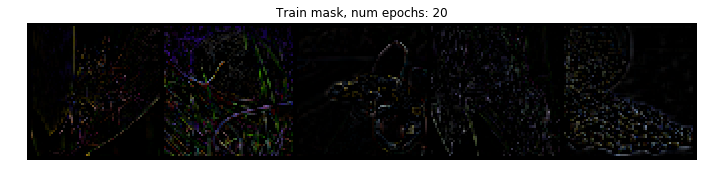

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


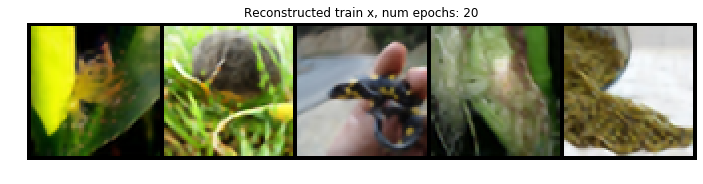

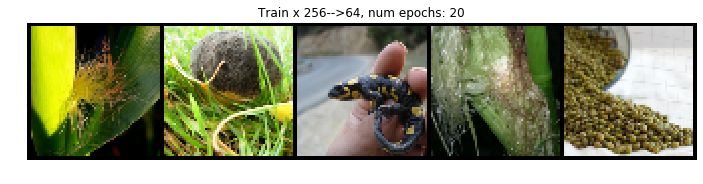

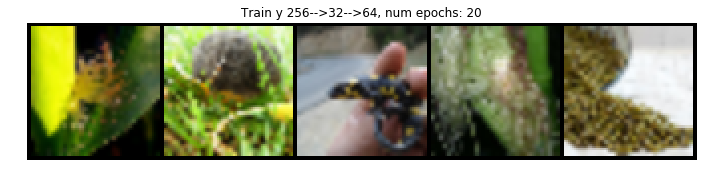

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


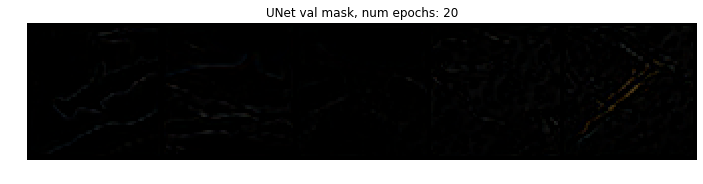

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


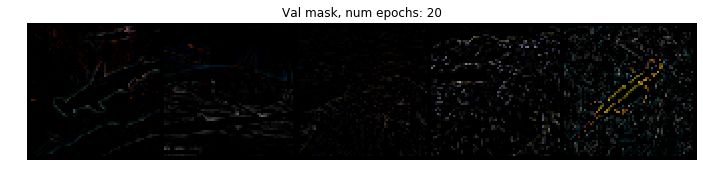

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


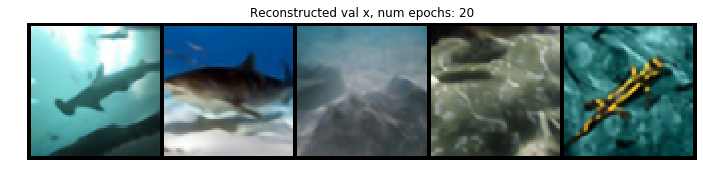

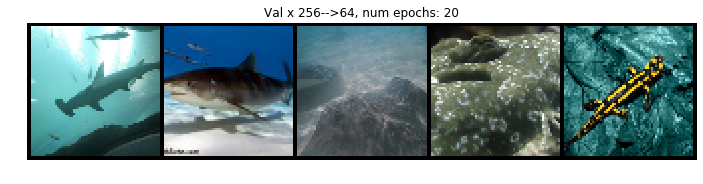

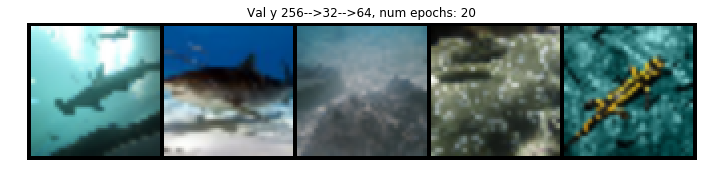

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


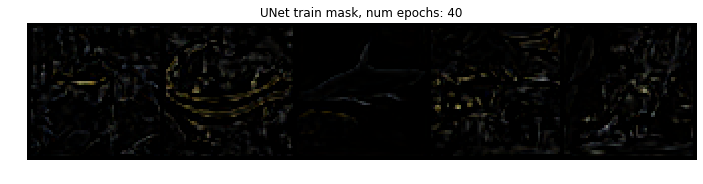

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


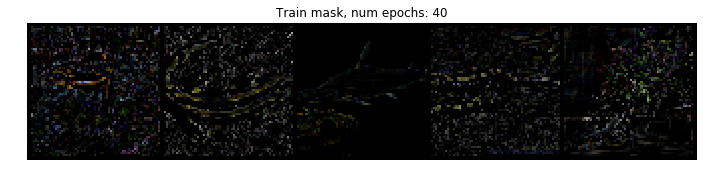

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


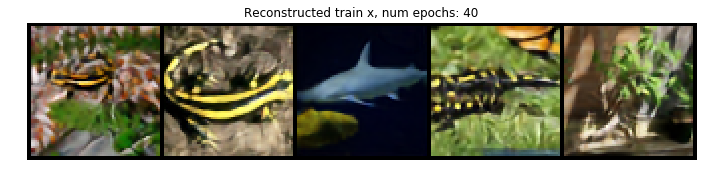

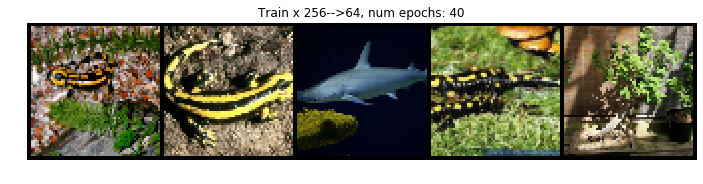

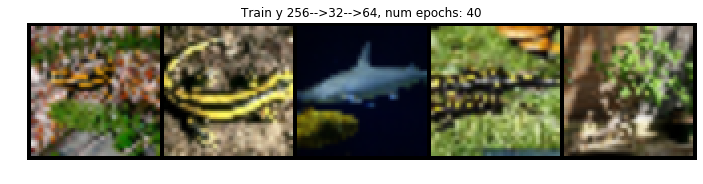

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


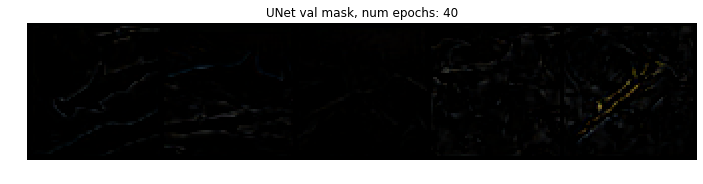

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


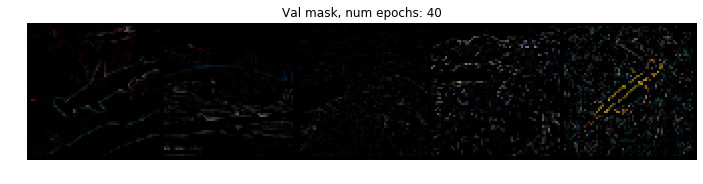

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


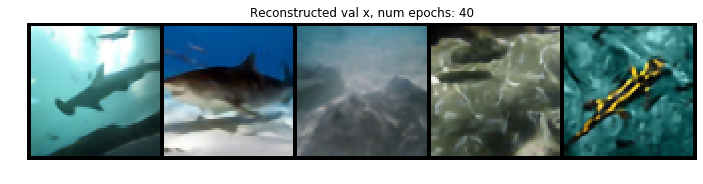

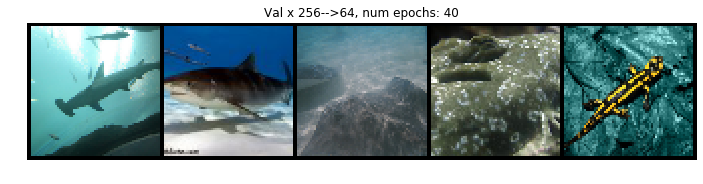

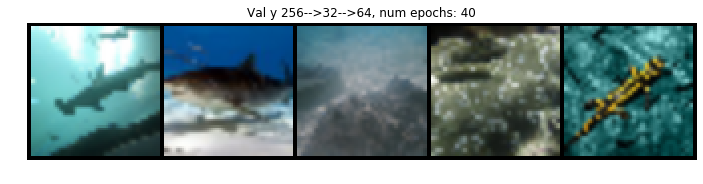

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


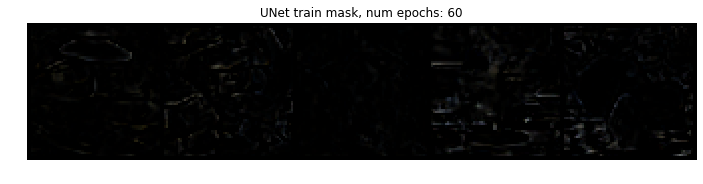

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


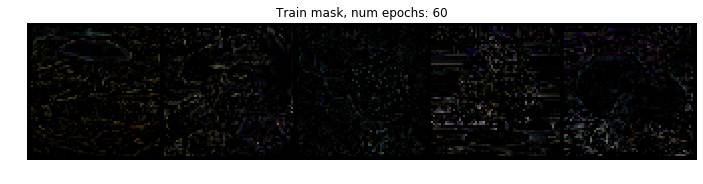

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


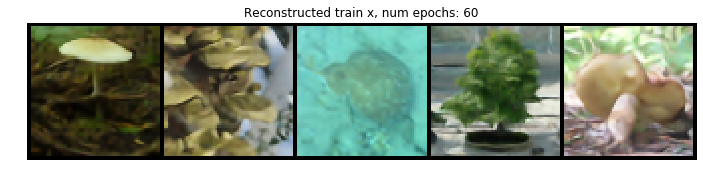

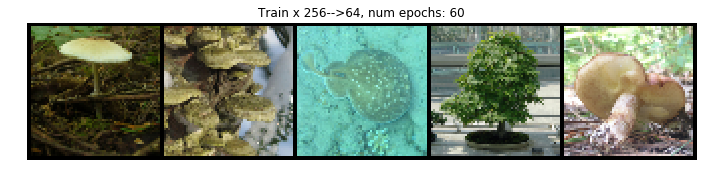

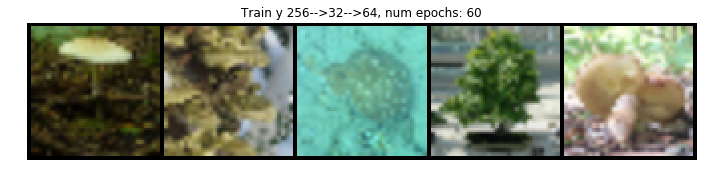

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


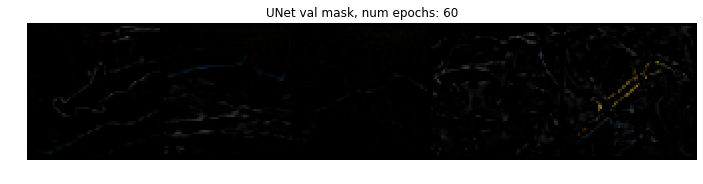

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


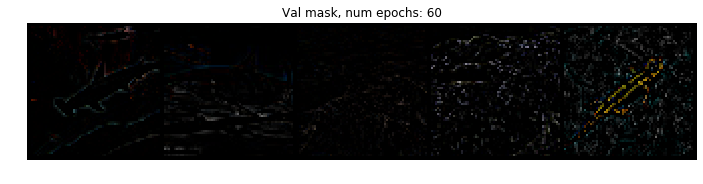

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


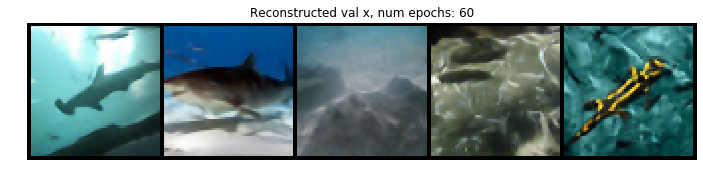

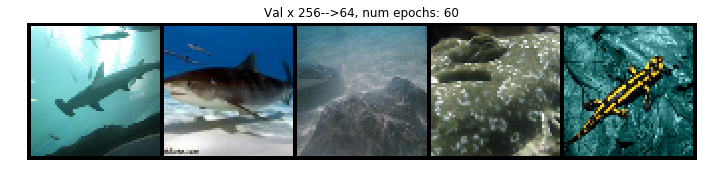

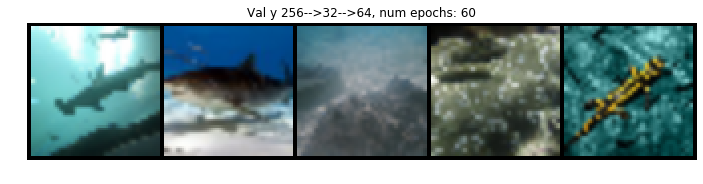

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


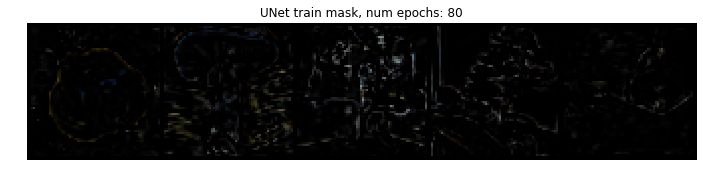

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


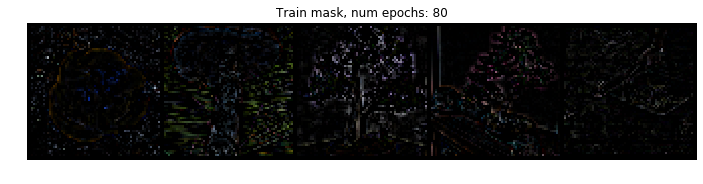

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


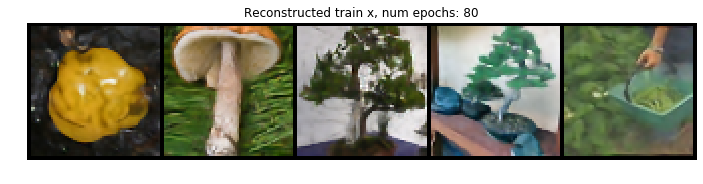

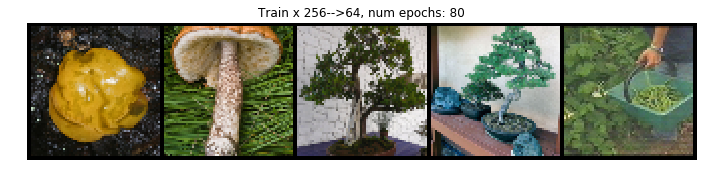

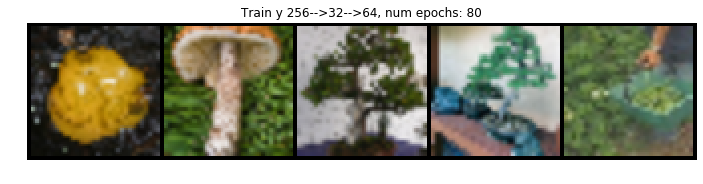

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


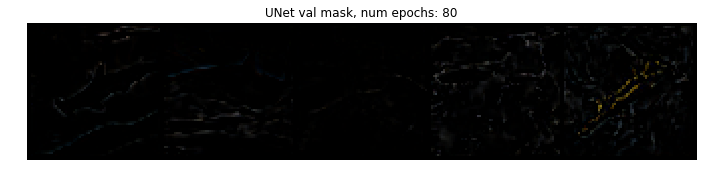

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


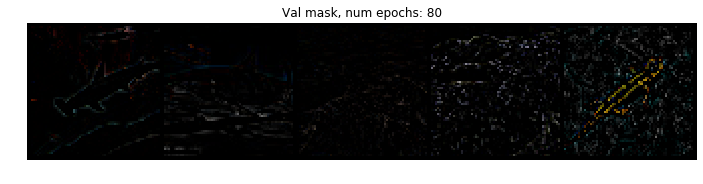

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


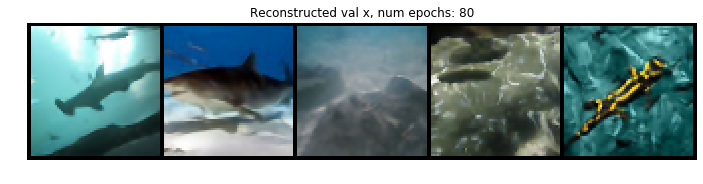

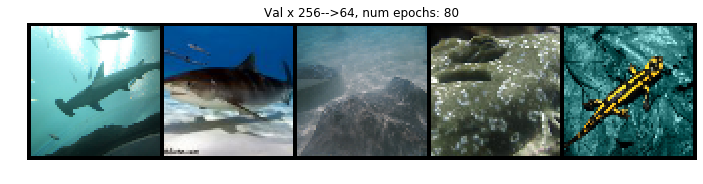

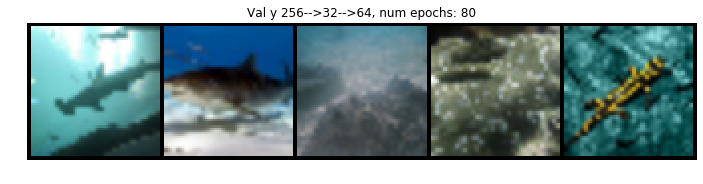

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


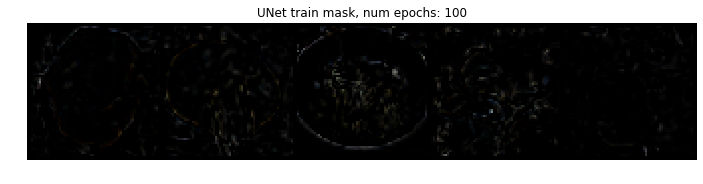

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


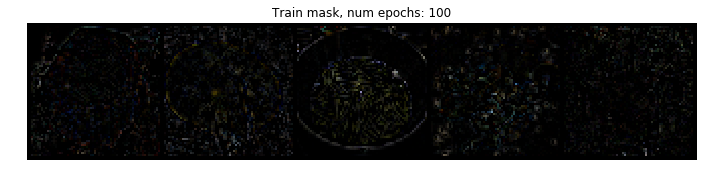

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


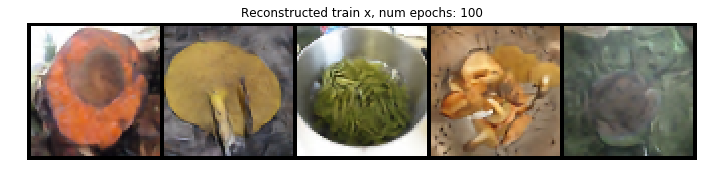

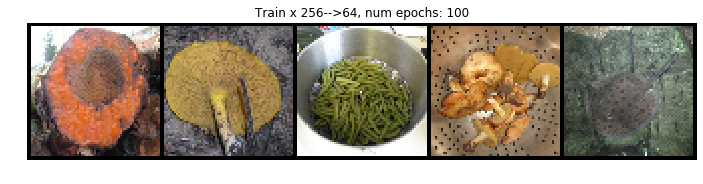

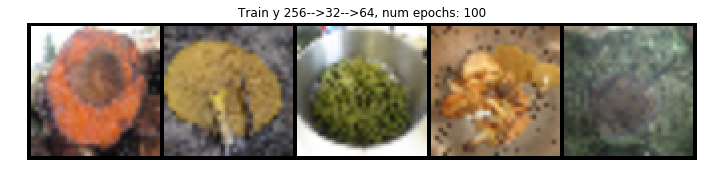

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


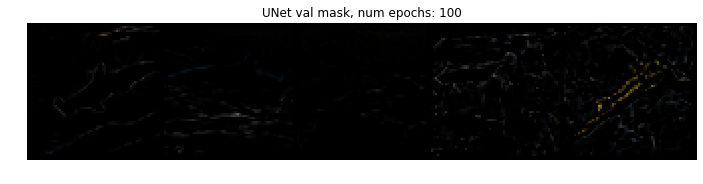

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


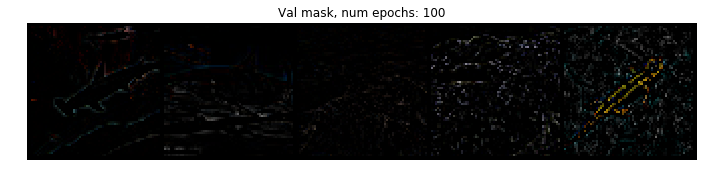

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


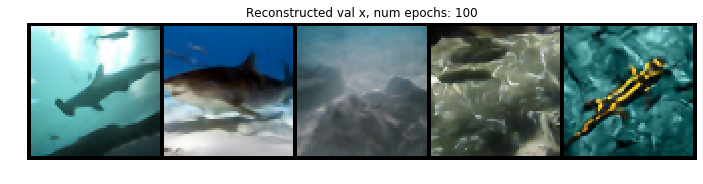

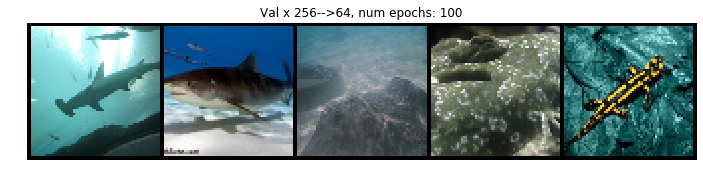

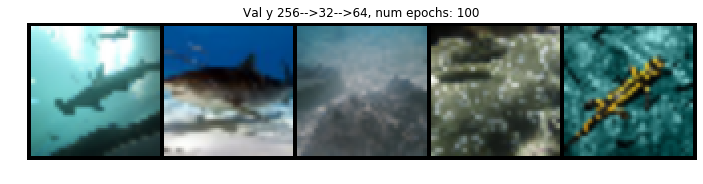

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


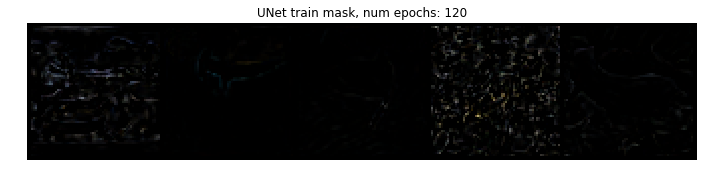

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


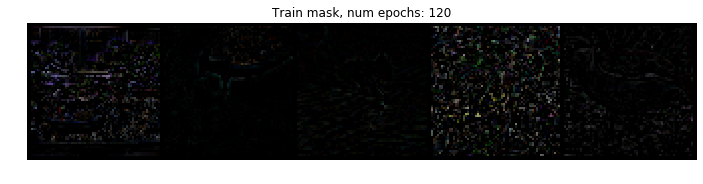

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


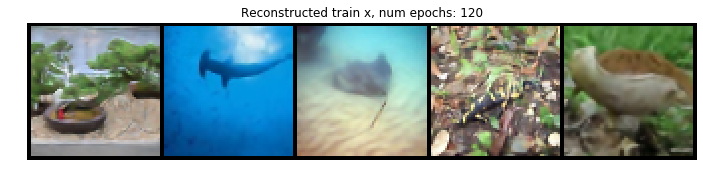

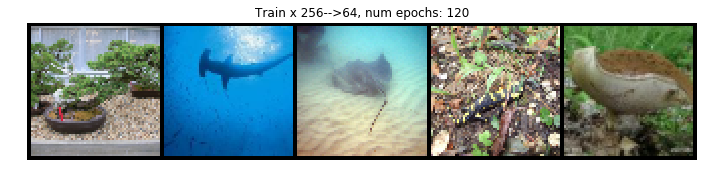

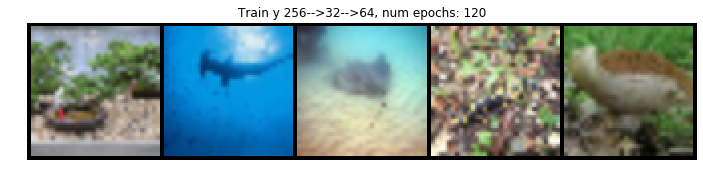

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


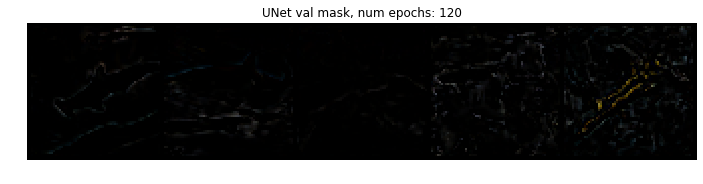

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


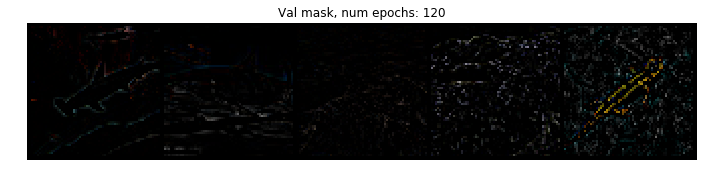

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


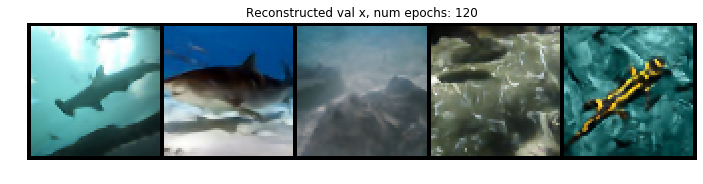

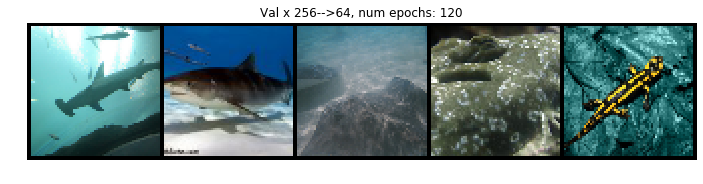

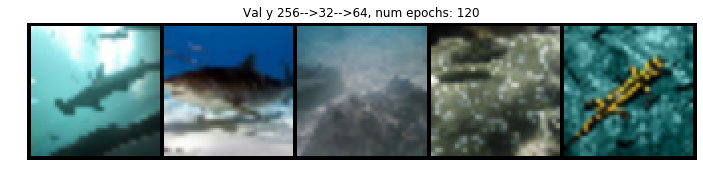

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


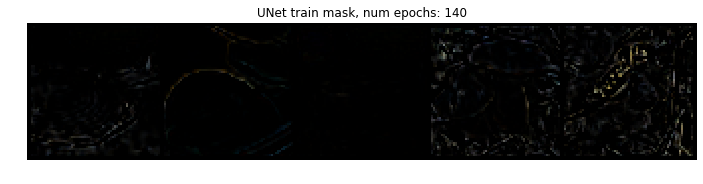

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


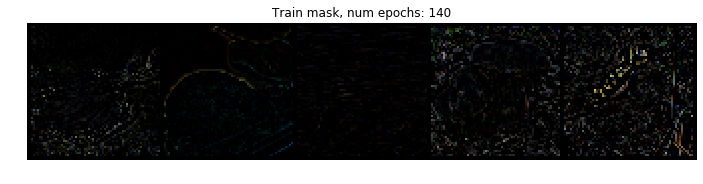

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


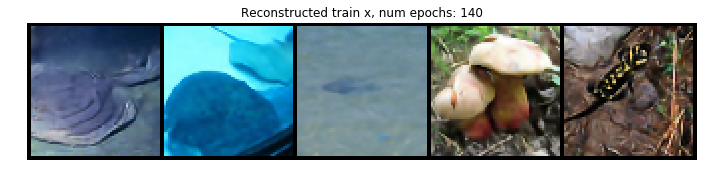

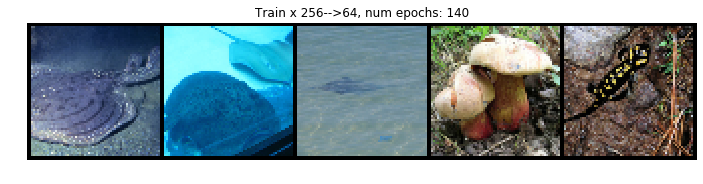

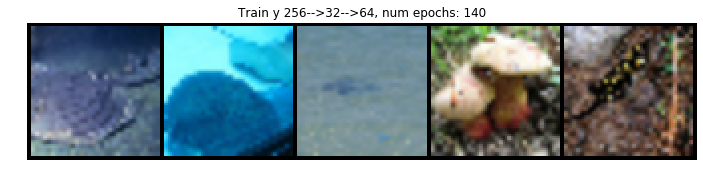

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


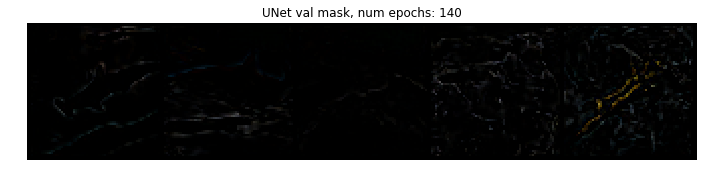

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


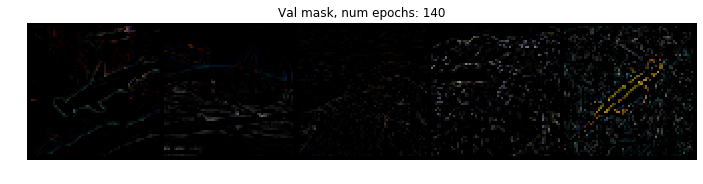

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


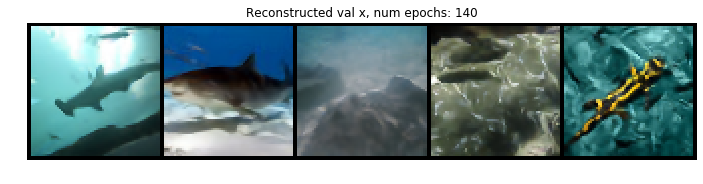

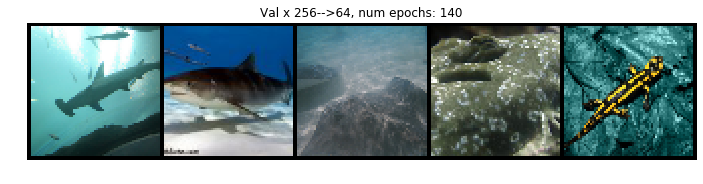

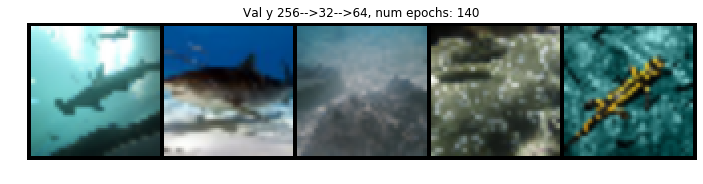

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


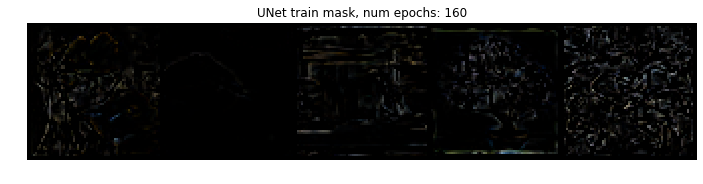

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


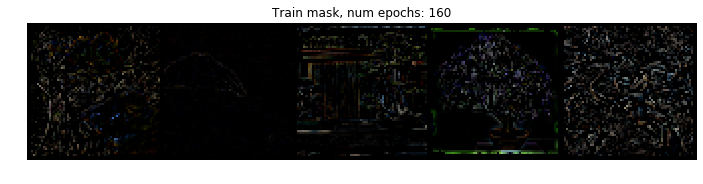

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


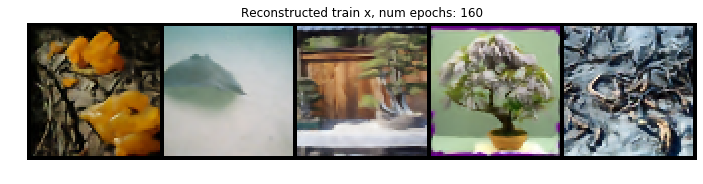

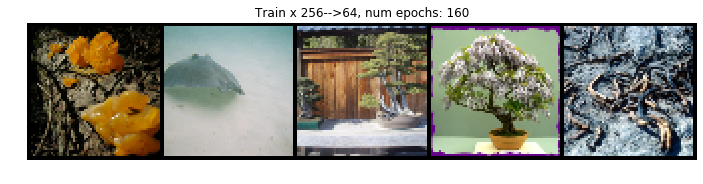

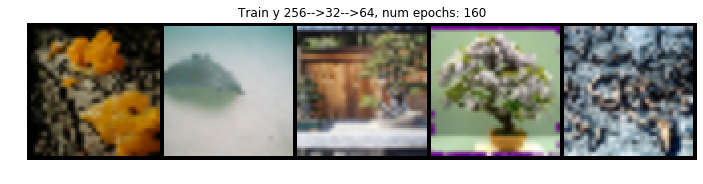

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


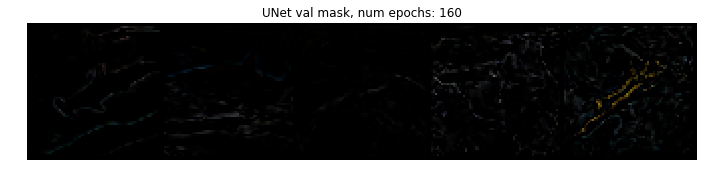

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


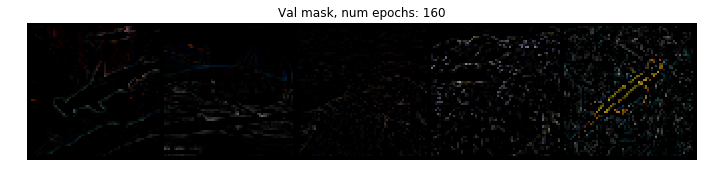

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


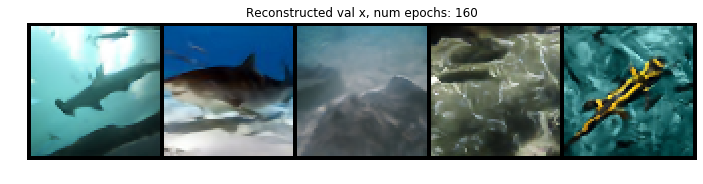

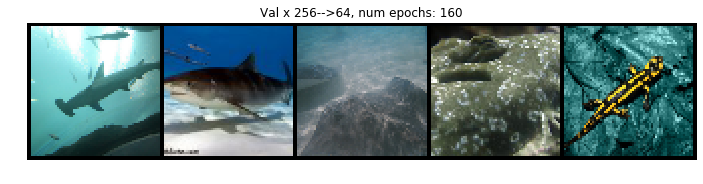

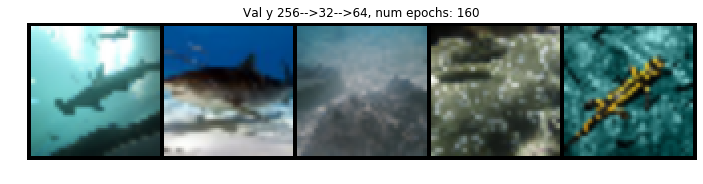

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


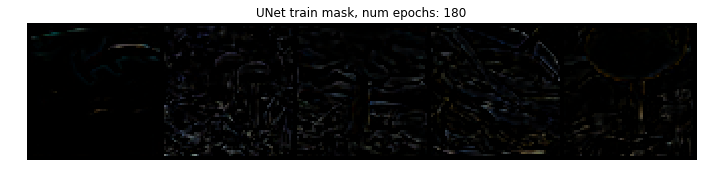

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


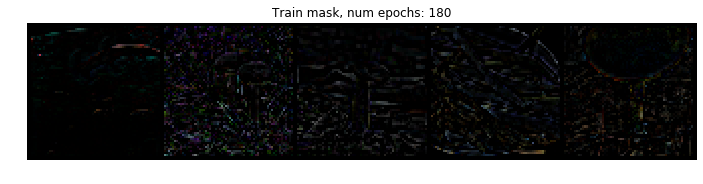

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


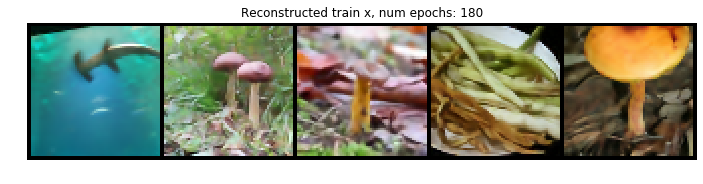

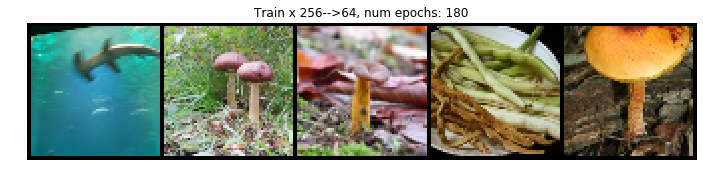

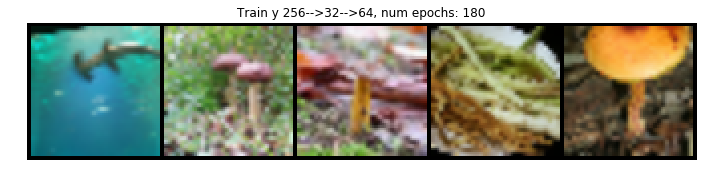

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


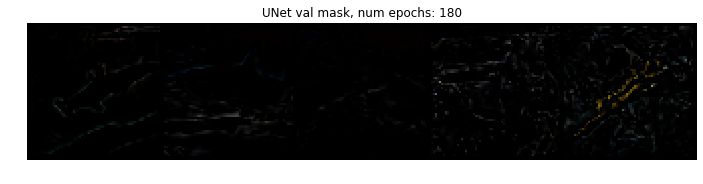

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


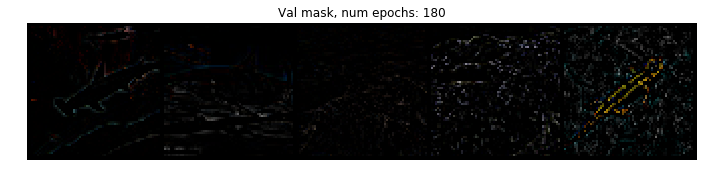

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


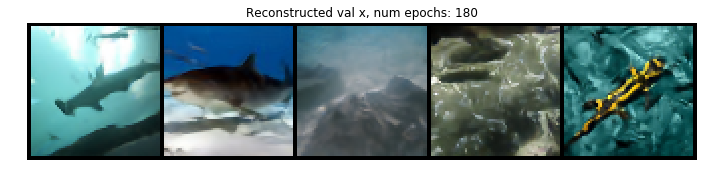

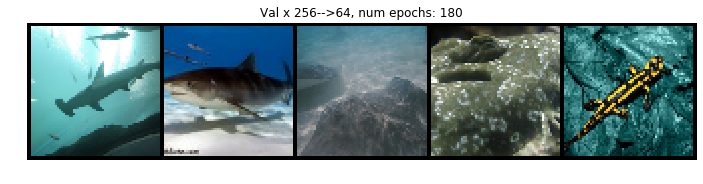

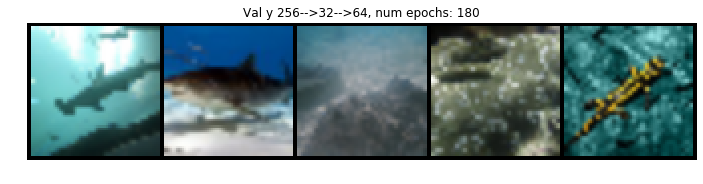

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


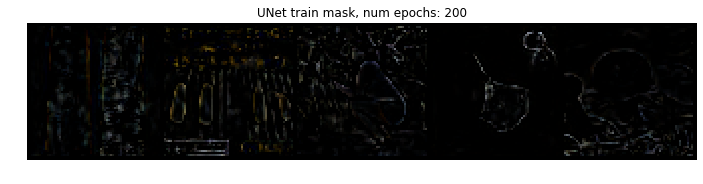

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


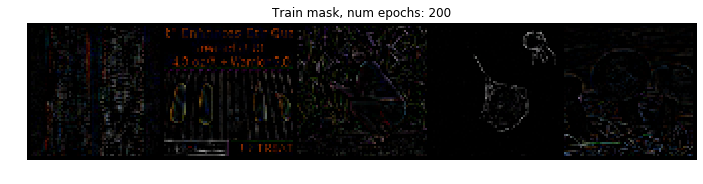

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


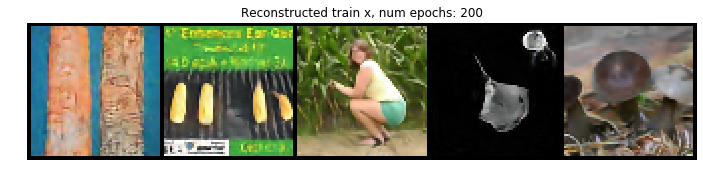

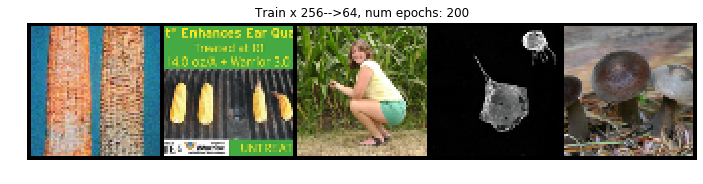

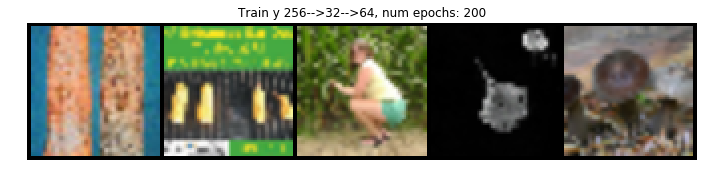

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


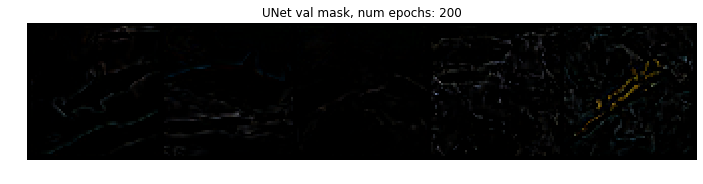

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


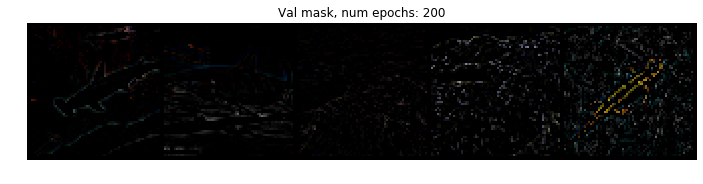

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


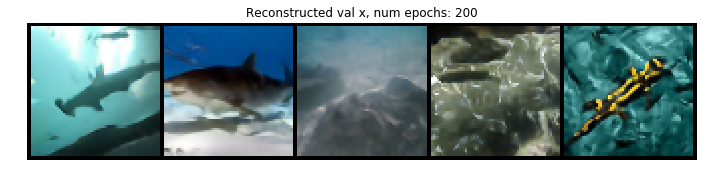

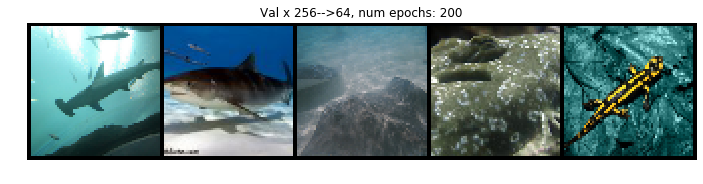

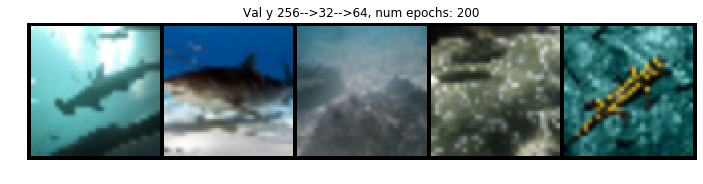

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


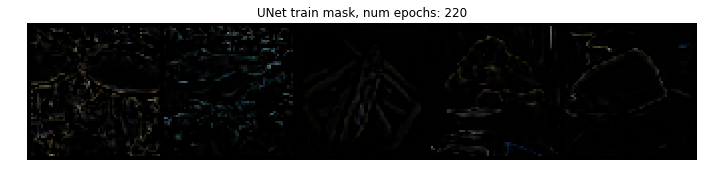

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


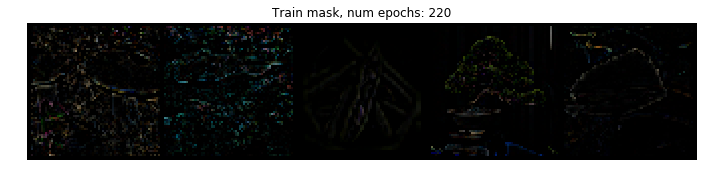

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


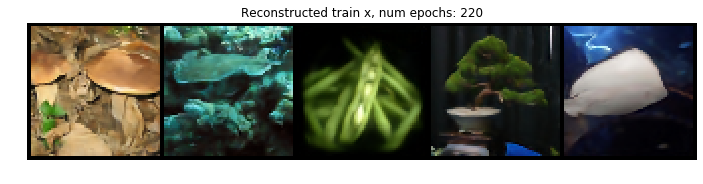

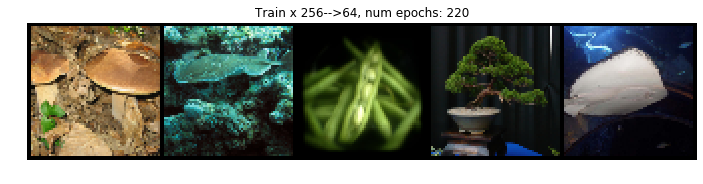

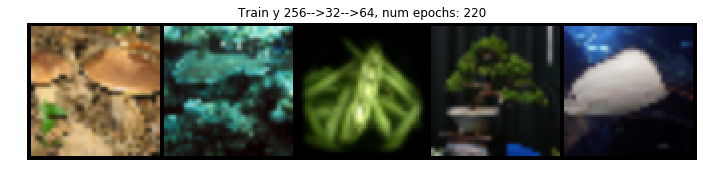

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


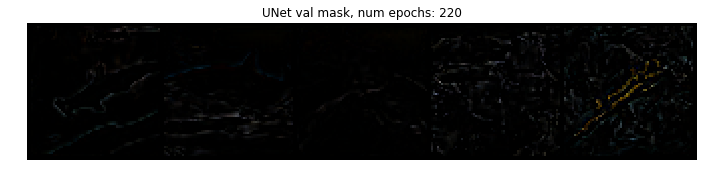

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


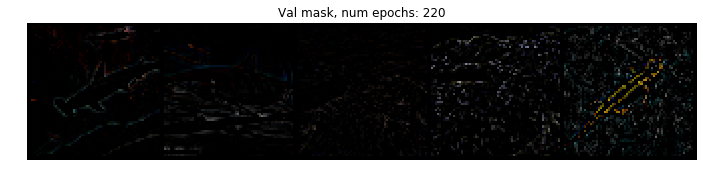

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


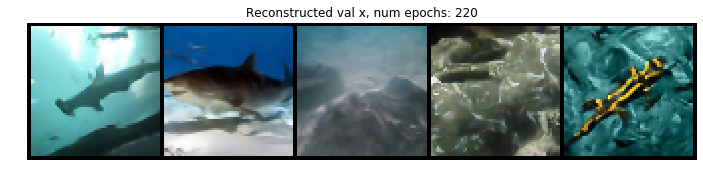

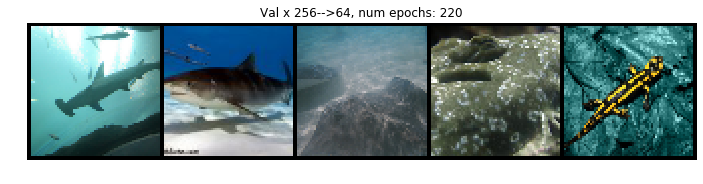

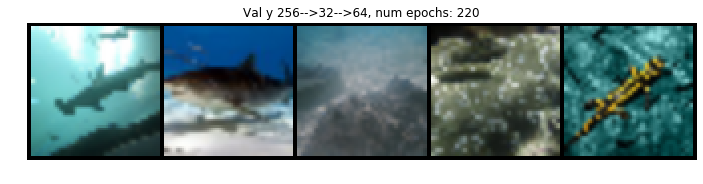

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


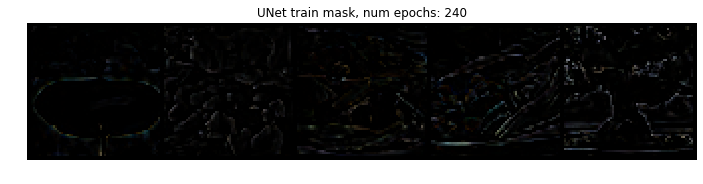

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


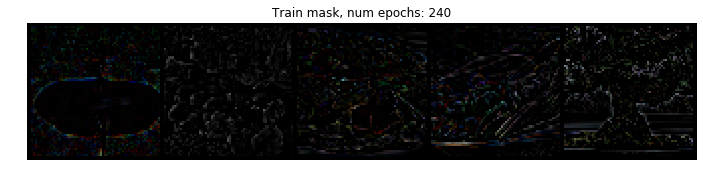

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


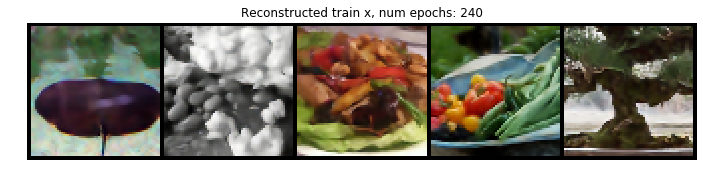

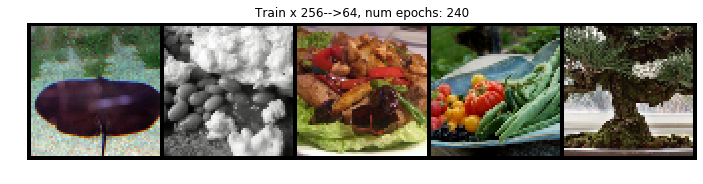

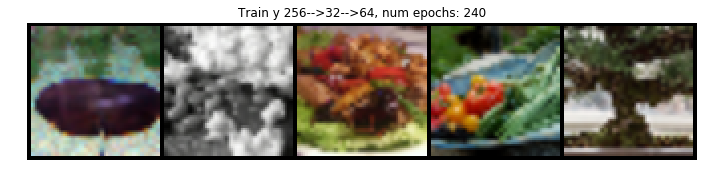

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


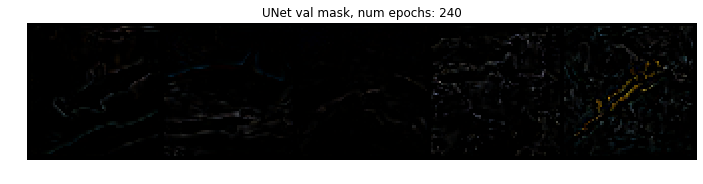

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


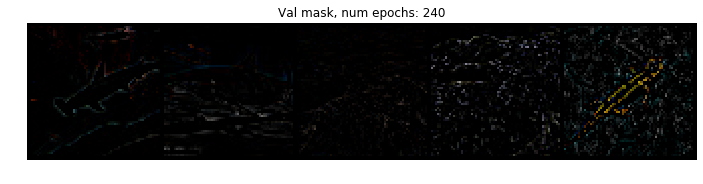

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


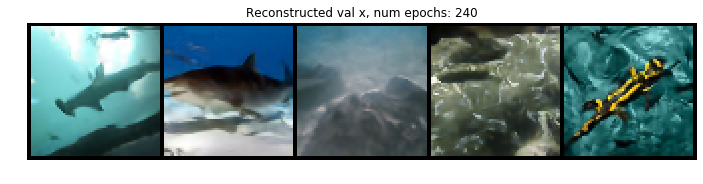

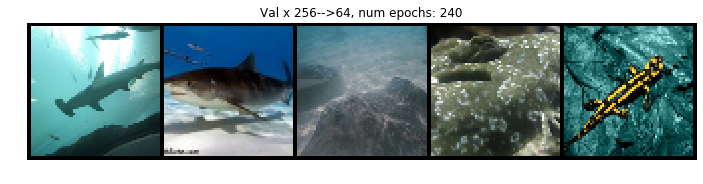

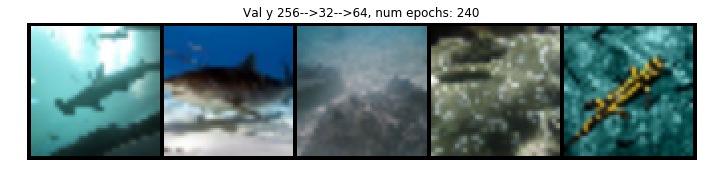

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


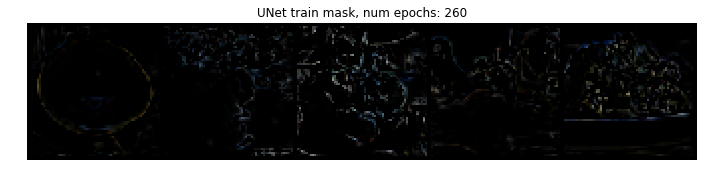

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


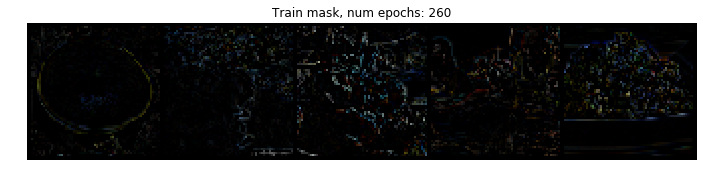

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


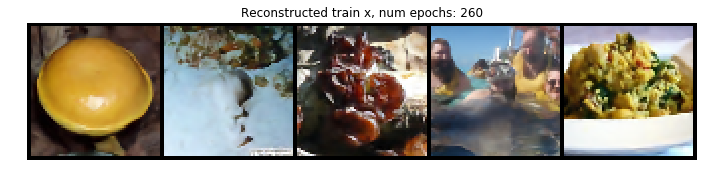

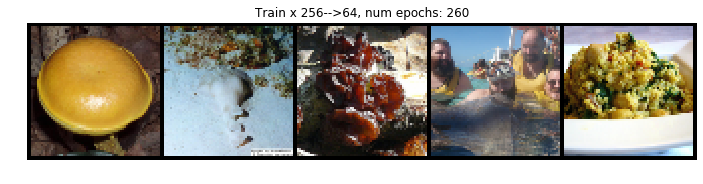

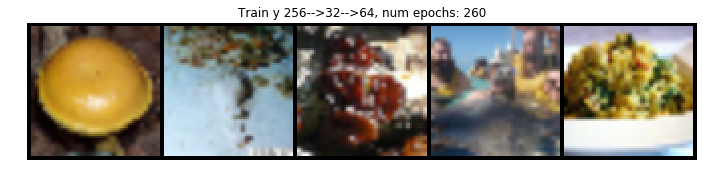

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


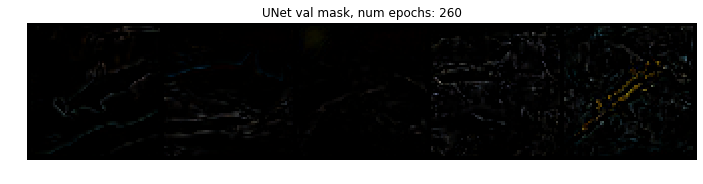

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


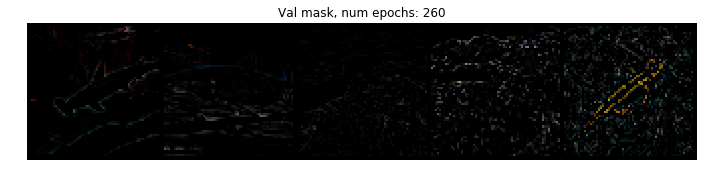

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


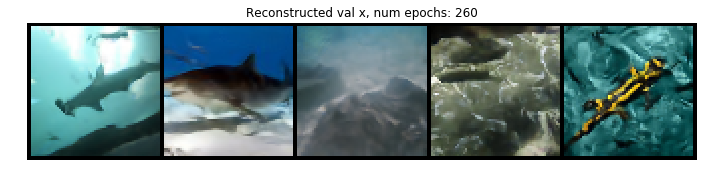

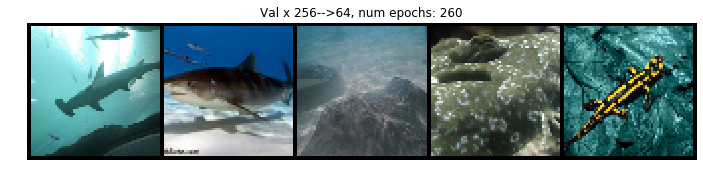

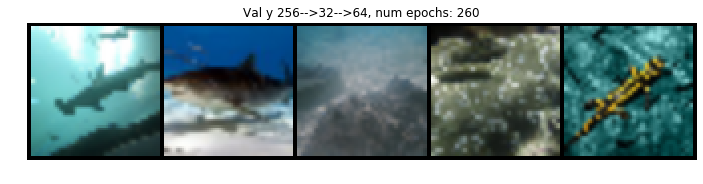

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


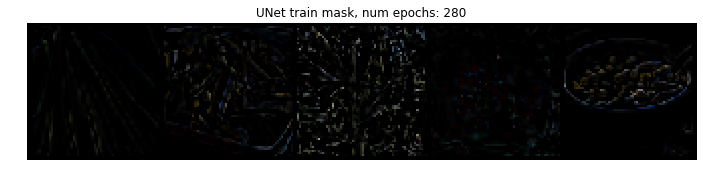

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


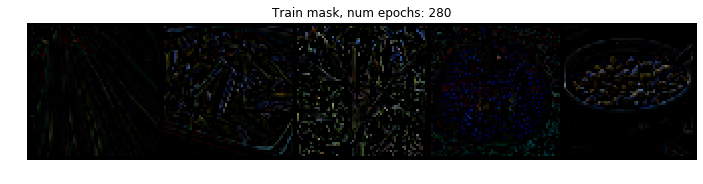

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


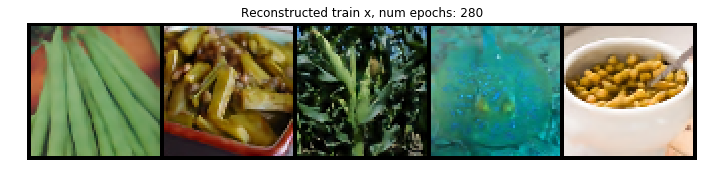

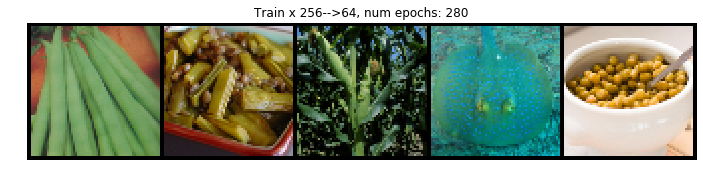

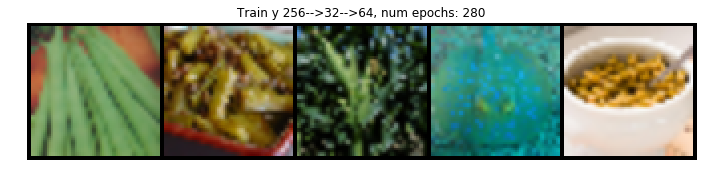

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


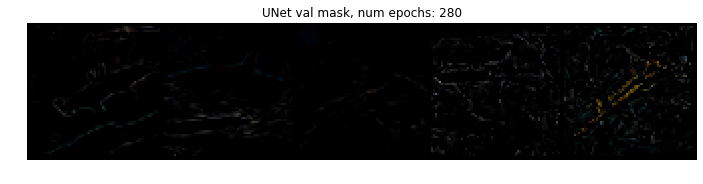

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


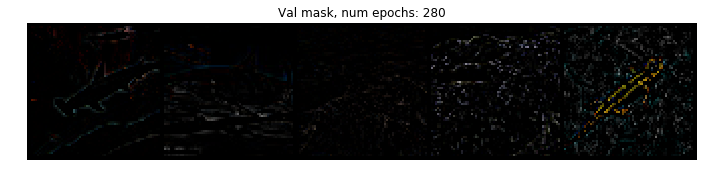

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


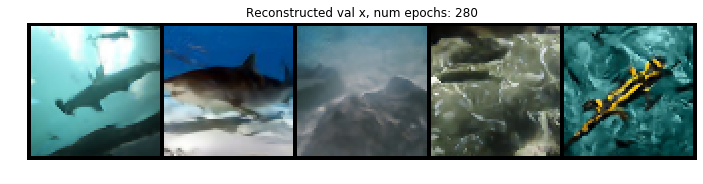

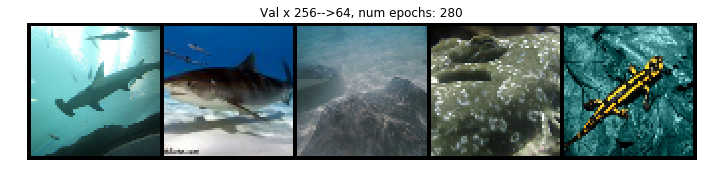

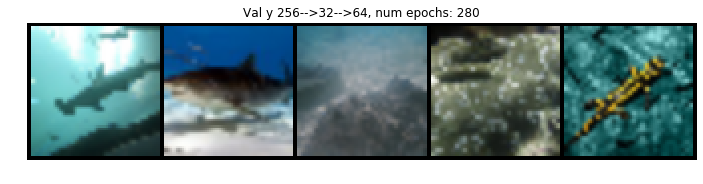

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


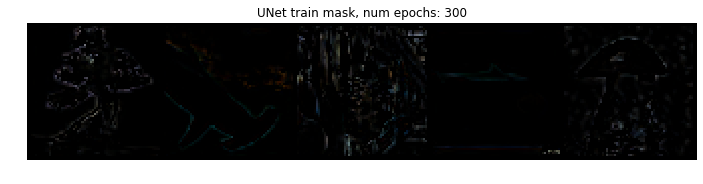

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


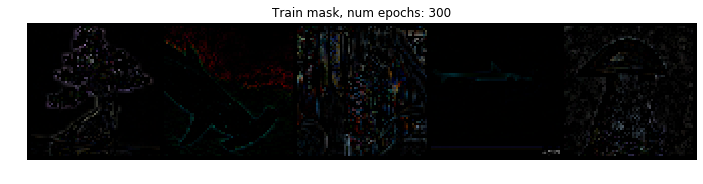

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


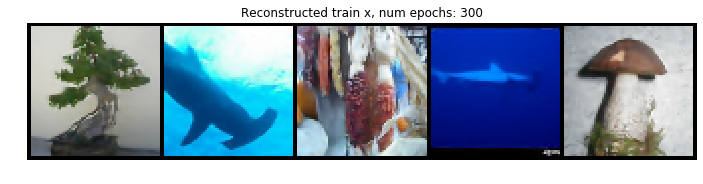

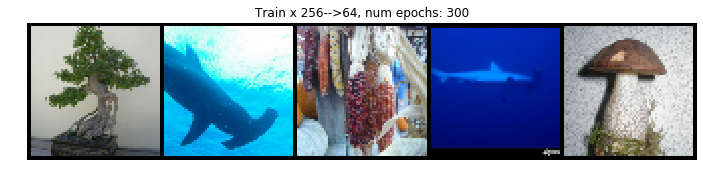

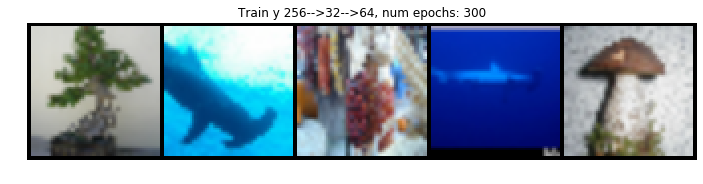

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


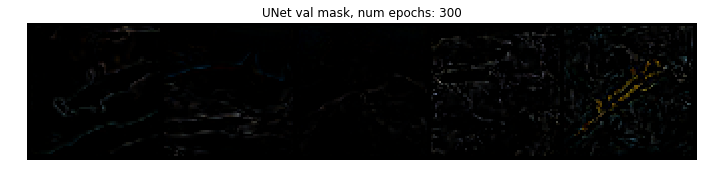

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


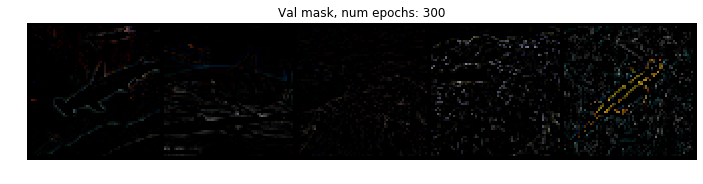

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


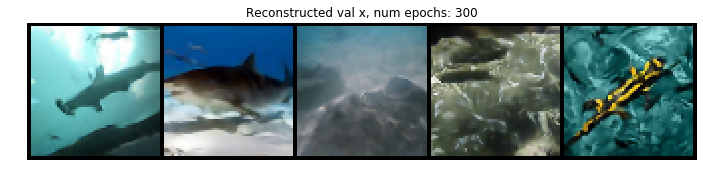

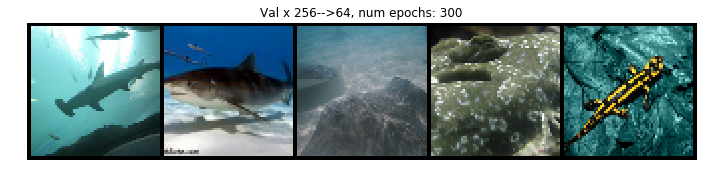

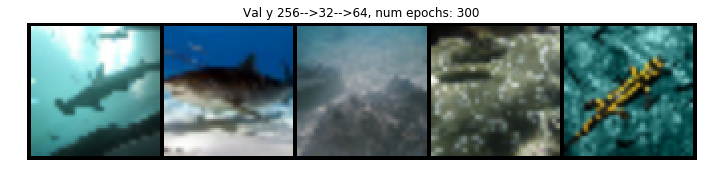

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


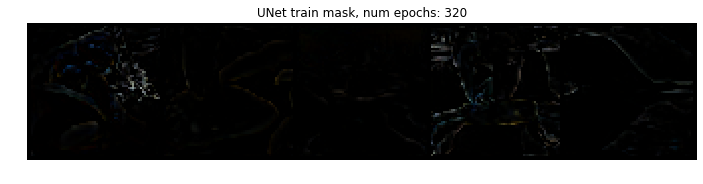

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


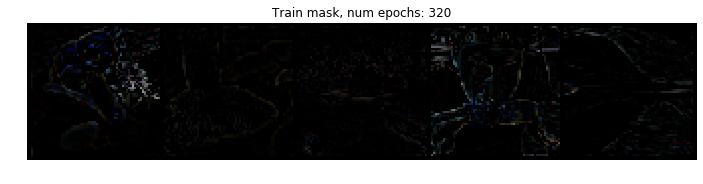

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


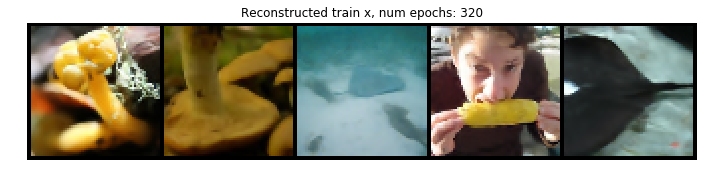

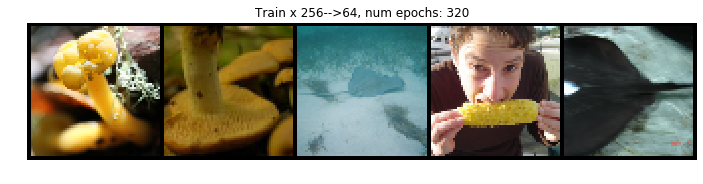

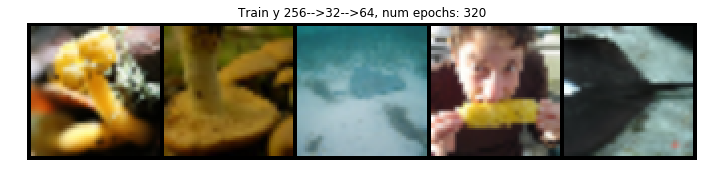

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


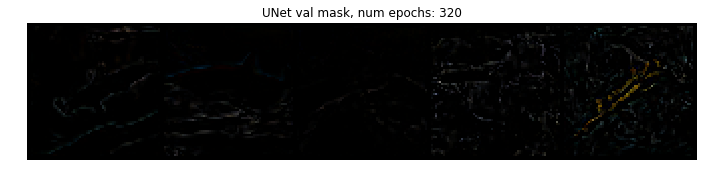

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


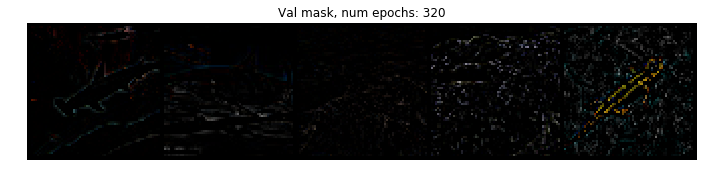

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


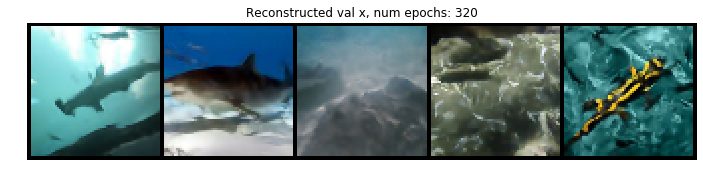

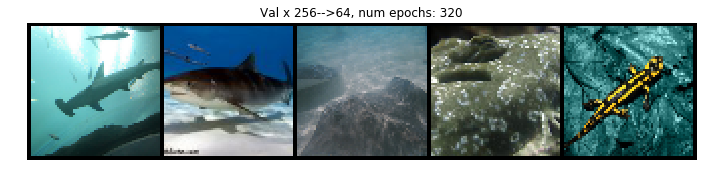

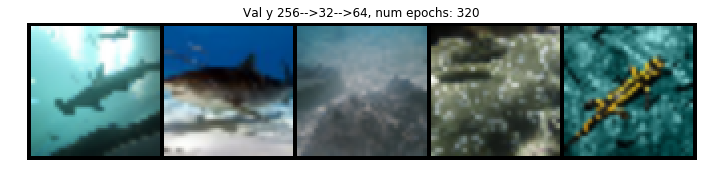

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


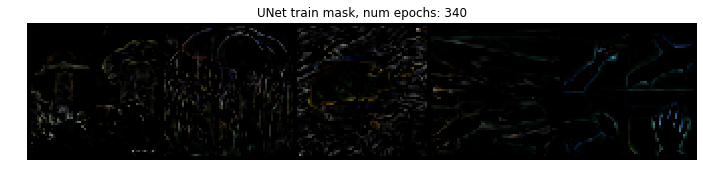

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


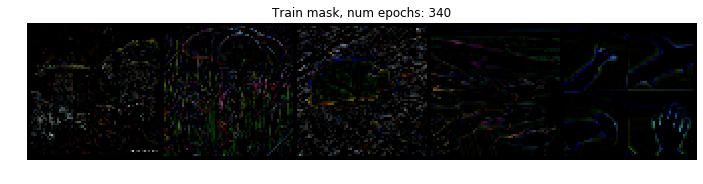

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


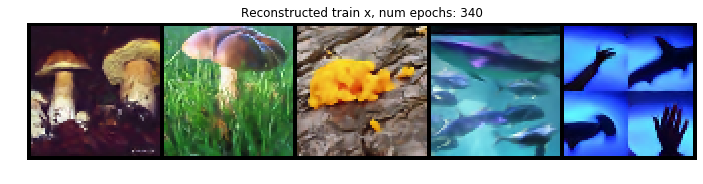

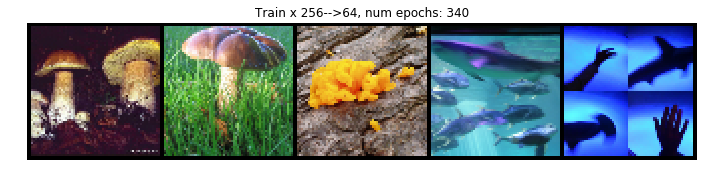

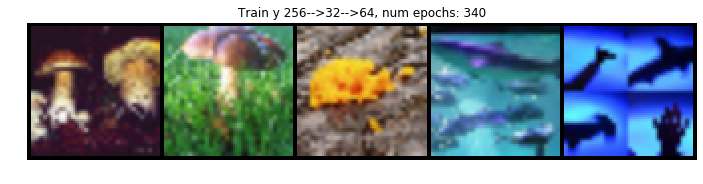

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


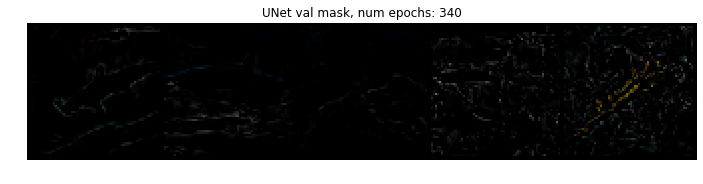

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


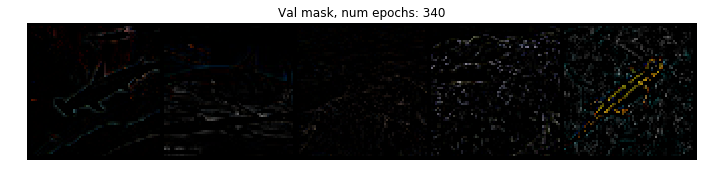

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


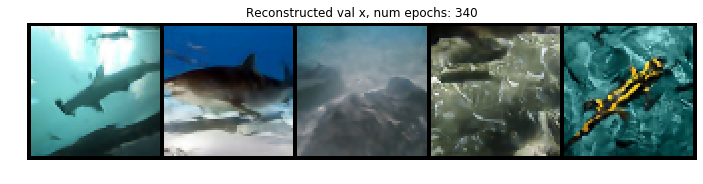

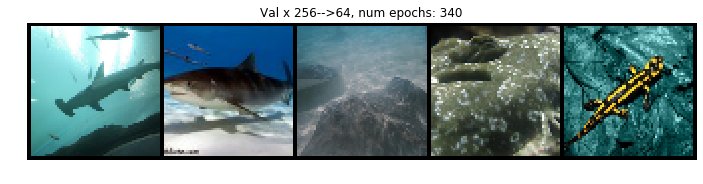

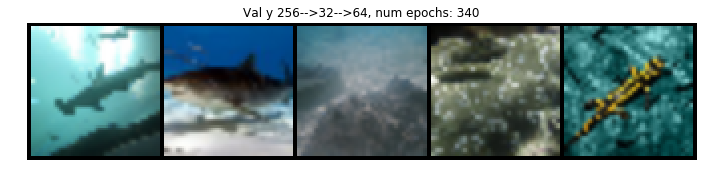

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


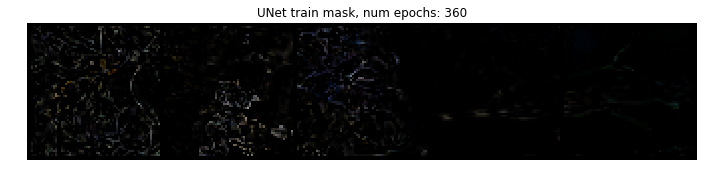

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


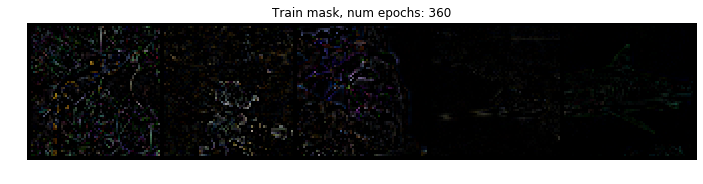

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


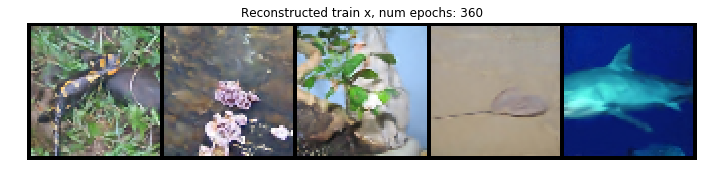

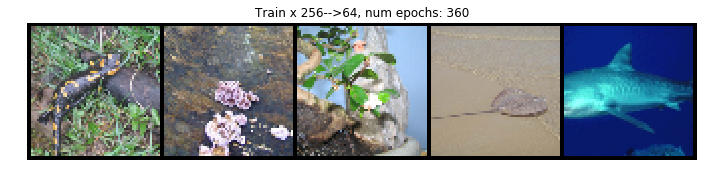

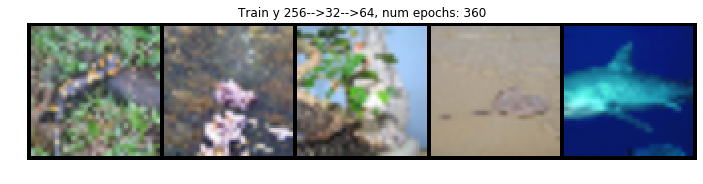

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


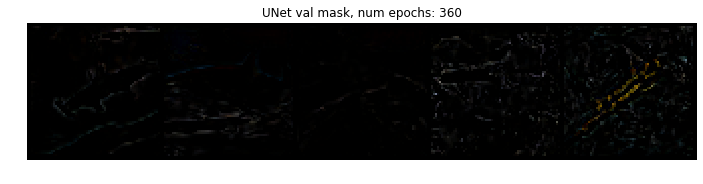

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


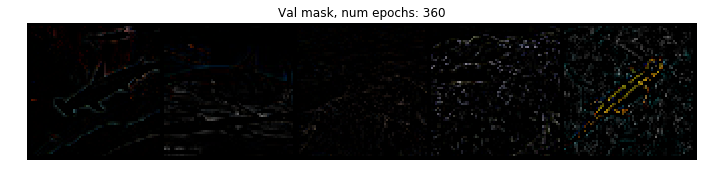

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


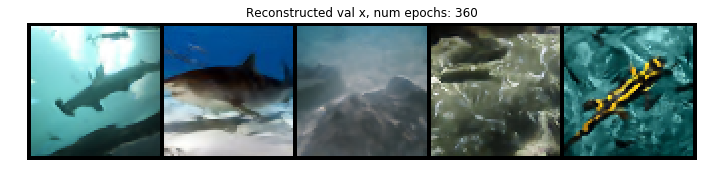

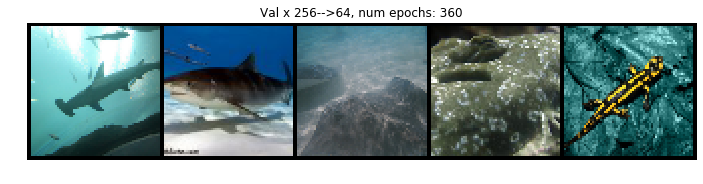

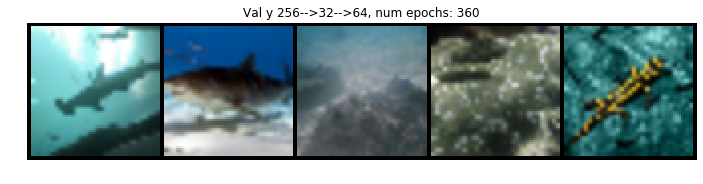

requests_with_retry encountered retryable exception: 500 Server Error: Internal Server Error for url: https://api.wandb.ai/files/churwitz/UNET_imagenet/n1syf3zx/file_stream. args: ('https://api.wandb.ai/files/churwitz/UNET_imagenet/n1syf3zx/file_stream',), kwargs: {'json': {'complete': False, 'failed': False}}
requests_with_retry encountered retryable exception: 500 Server Error: Internal Server Error for url: https://api.wandb.ai/files/churwitz/UNET_imagenet/n1syf3zx/file_stream. args: ('https://api.wandb.ai/files/churwitz/UNET_imagenet/n1syf3zx/file_stream',), kwargs: {'json': {'complete': False, 'failed': False}}
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


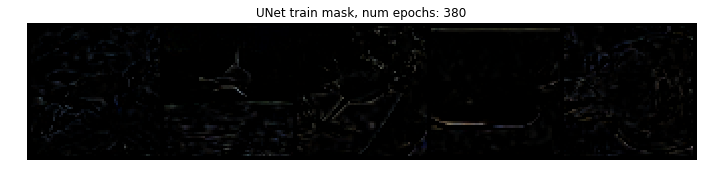

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


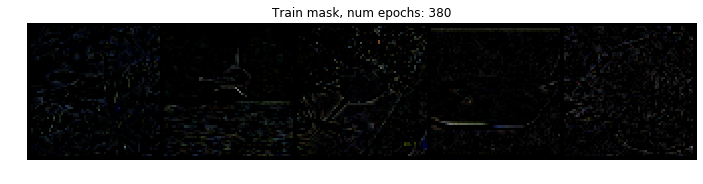

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


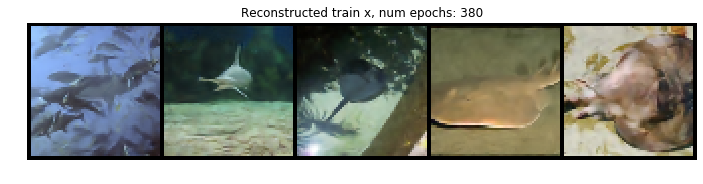

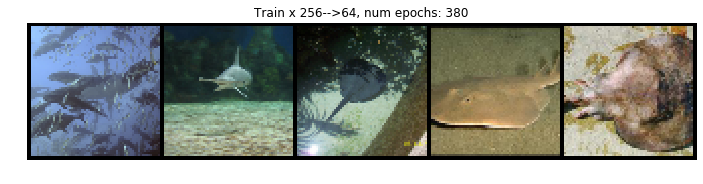

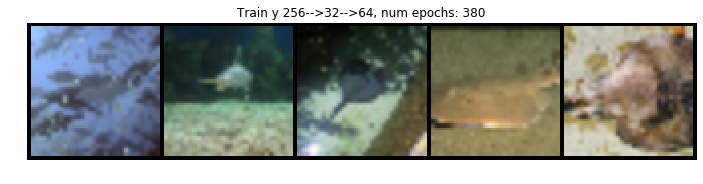

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


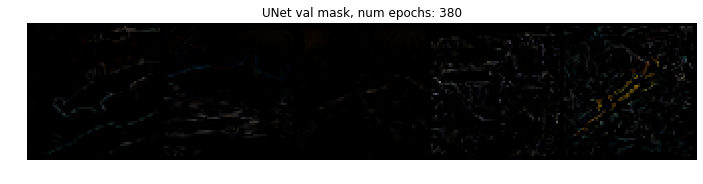

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


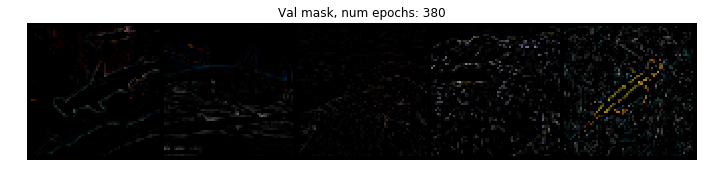

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


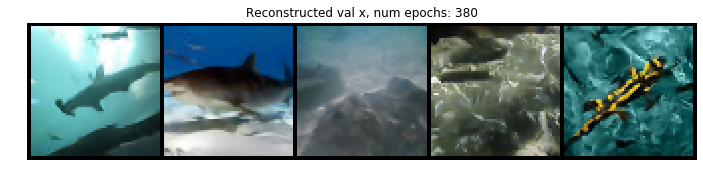

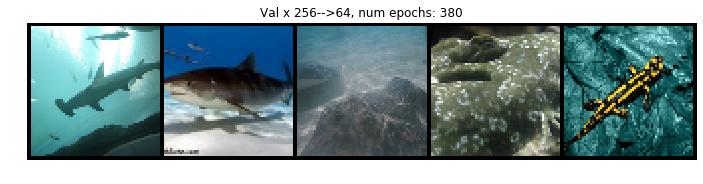

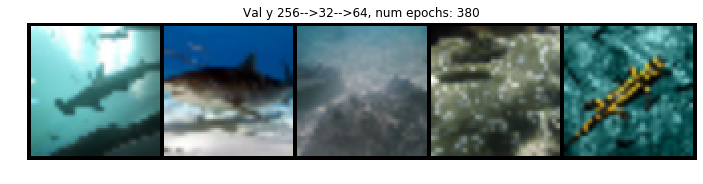

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


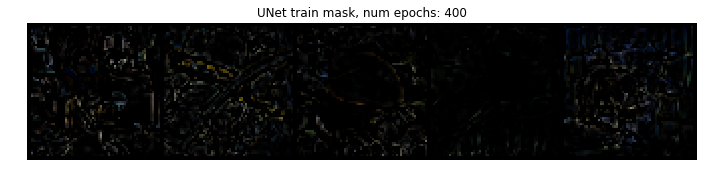

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


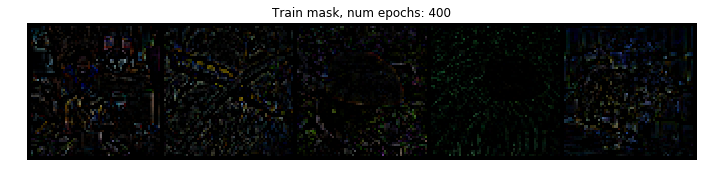

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


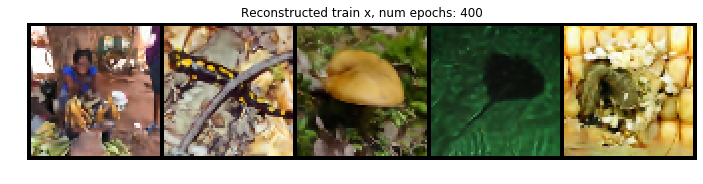

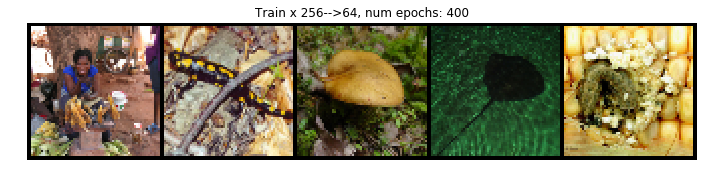

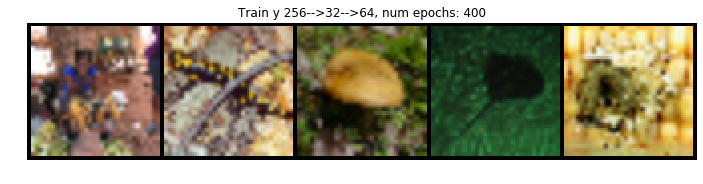

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


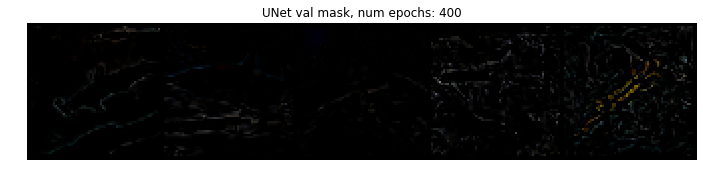

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


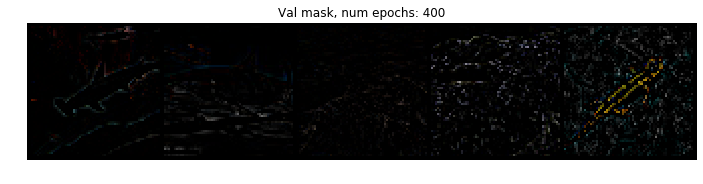

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


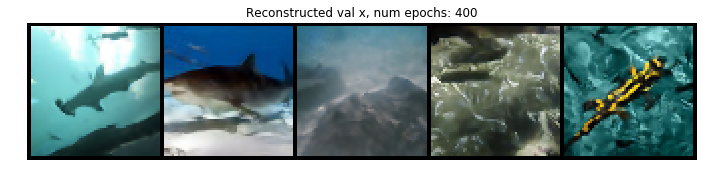

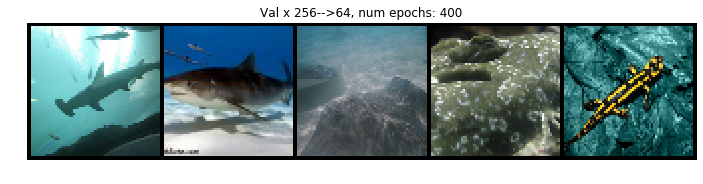

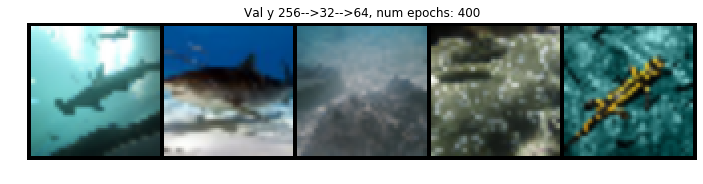

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


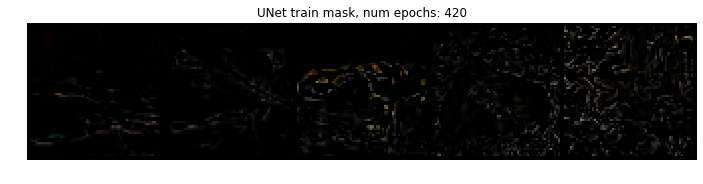

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


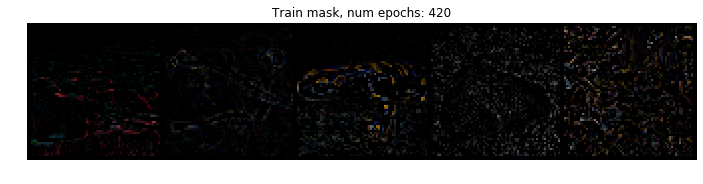

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


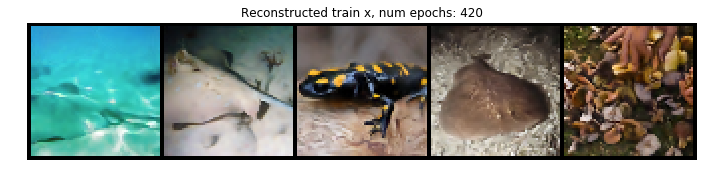

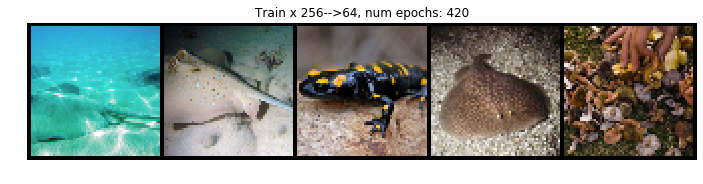

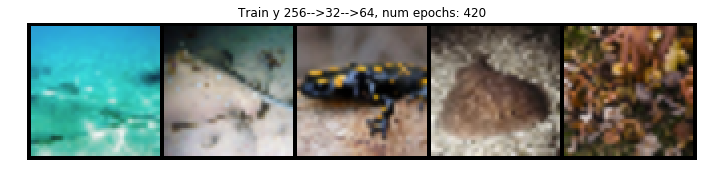

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


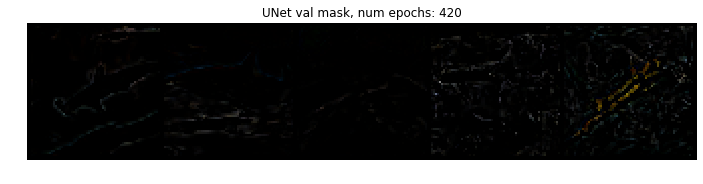

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


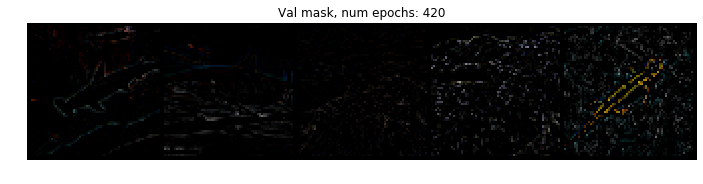

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


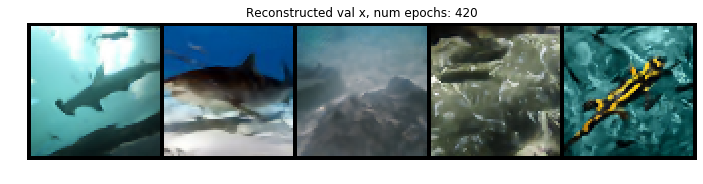

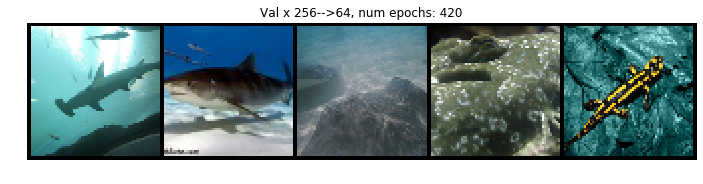

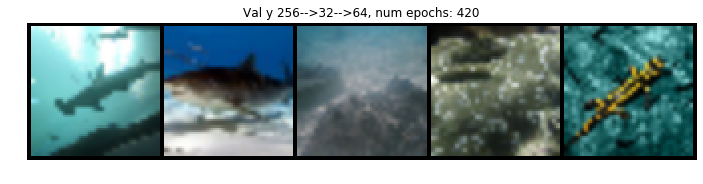

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


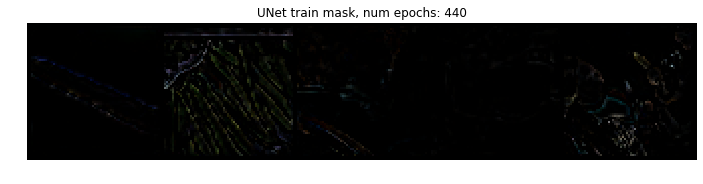

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


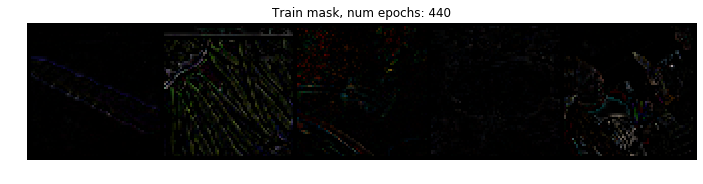

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


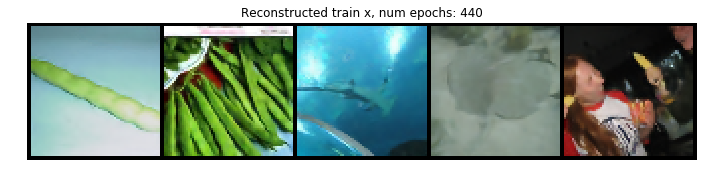

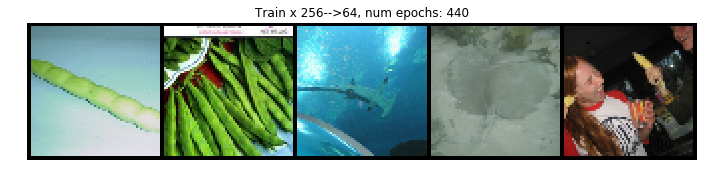

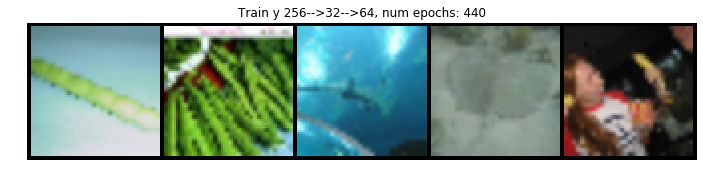

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


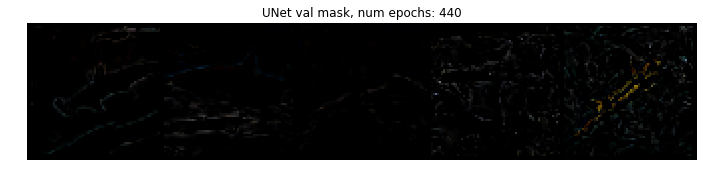

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


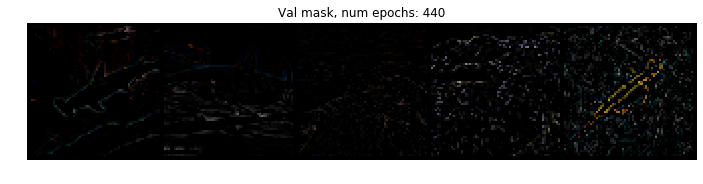

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


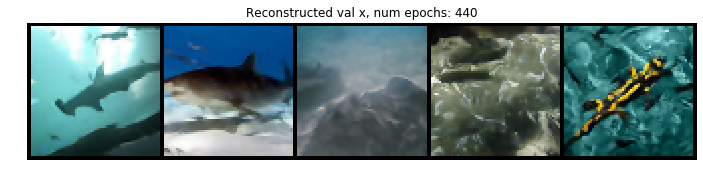

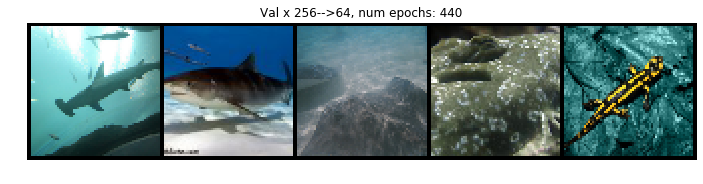

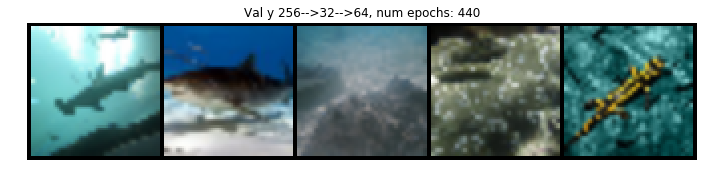

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


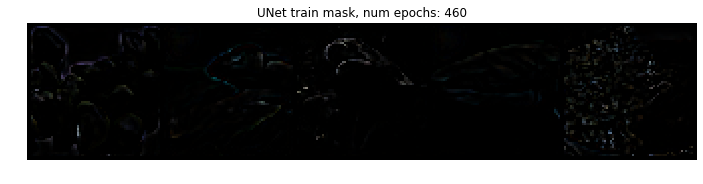

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


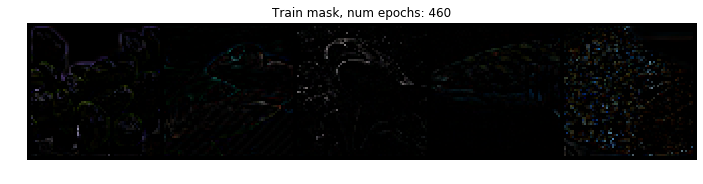

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


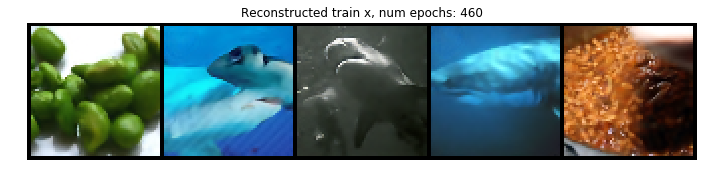

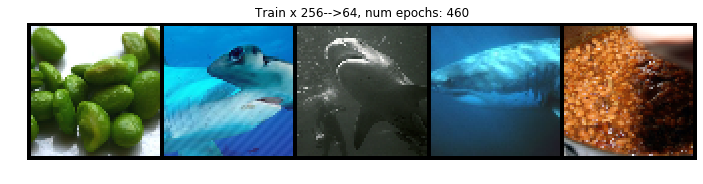

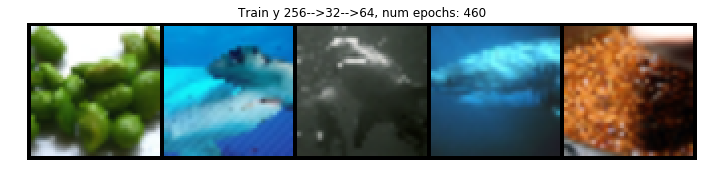

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


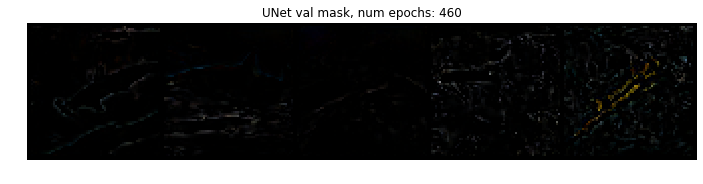

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


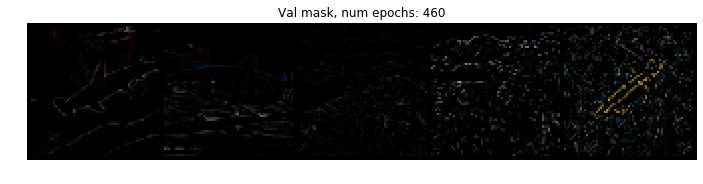

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


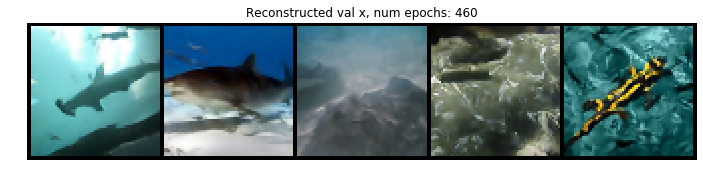

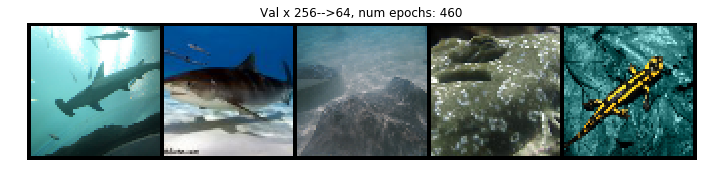

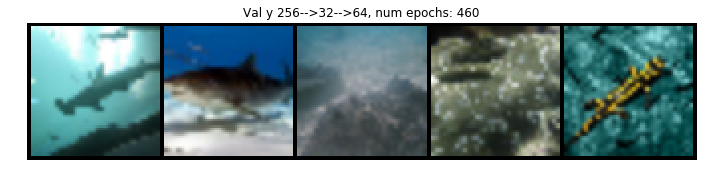

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


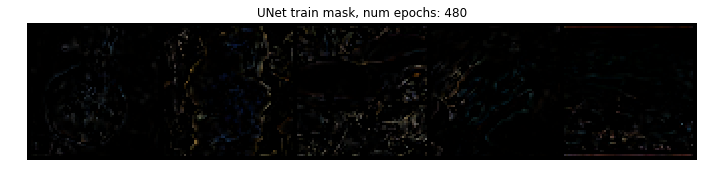

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


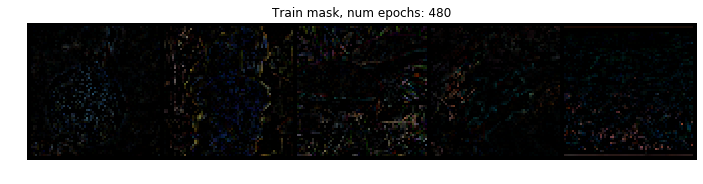

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


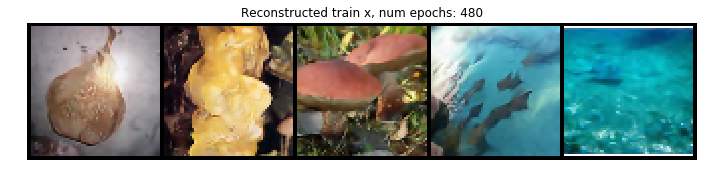

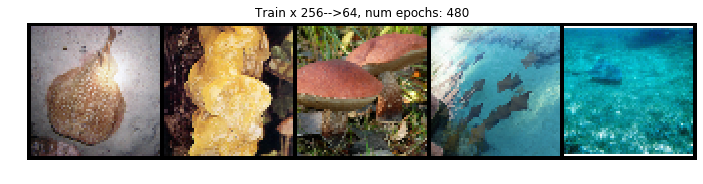

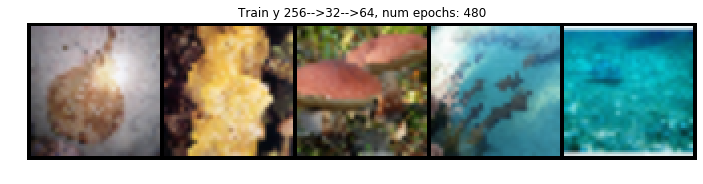

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


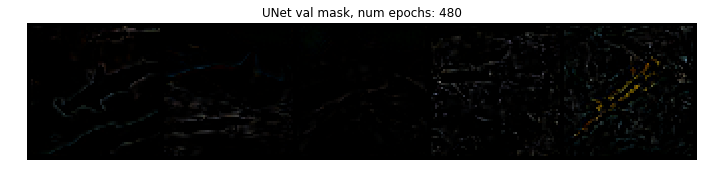

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


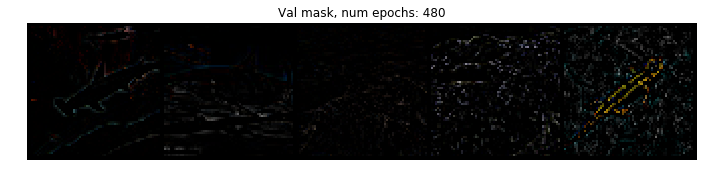

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


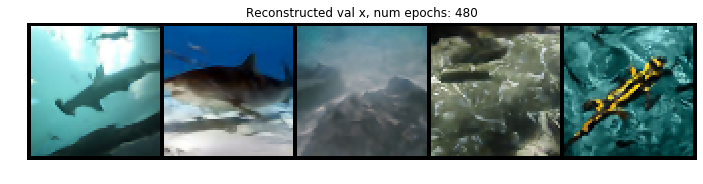

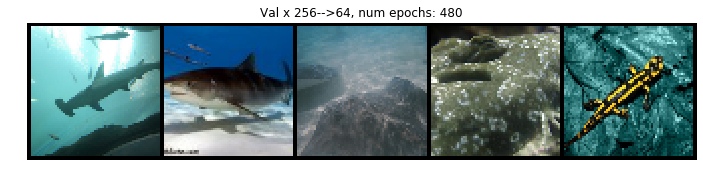

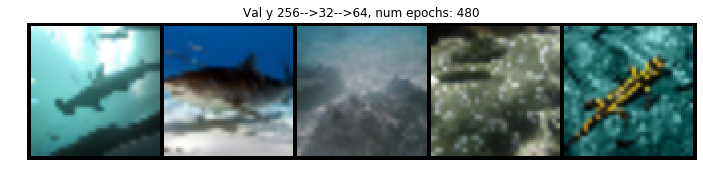

In [22]:
model.train()
model.to(device)
normal = torch.distributions.Normal(0,1)
# reconstruction_function = torch.nn.BCELoss(reduction='sum')
loss_func = torch.nn.MSELoss(reduction='sum')
print("Training for {} epochs...".format(500))
for n in range(0, 500):
    train_loss = 0
    train_recon_loss = 0
    train_kl_loss = 0
    num_examples = 0
    for (i, X) in enumerate(torch_data_loader):
        hr_image = X[0]
        y = F.interpolate(F.interpolate(hr_image, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
        x = F.interpolate(hr_image, args.resolution, mode="bilinear")

        optimizer.zero_grad()
        
        x = x.to(device)
        y = y.to(device)
        x_mask = x - y 
        x_mask_hat = model(y)
        x_hat = y + x_mask_hat
        loss = loss_func(x_mask_hat, x_mask)
        train_loss += loss.item()
#         train_recon_loss += recon_loss.item()
#         train_kl_loss += kl_loss.item()
        num_examples += x_hat.shape[0]
        loss.backward()
        optimizer.step()
    if log:
        wandb.log({'train_loss':train_loss/num_examples})
    
    if args.has_validation:
        model.eval()
        val_loss = 0
        num_examples = 0
        for (i, X) in enumerate(torch_val_data_loader):
            hr_image_val = X[0]
            y_val = F.interpolate(F.interpolate(hr_image_val, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
            x_val = F.interpolate(hr_image_val, args.resolution, mode="bilinear")
            x_val = x_val.to(device)
            y_val = y_val.to(device)
            
            x_mask_val = x_val - y_val
            x_mask_hat_val = model(y_val)
            x_hat_val = y_val + x_mask_hat_val
            loss_val = loss_func(x_mask_hat_val, x_mask_val)
            val_loss += loss_val.item()
            num_examples += x_hat_val.shape[0]
        if log:
            wandb.log({'val_loss':val_loss/num_examples})
        model.train()


    if n%20 ==0:
        model.eval() #evaluate model
                    
        fig = make_grid(x_mask_hat[:5], num_images=5, title='UNet train mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'UNet train mask':fig})
            
        fig = make_grid(x_mask[:5], num_images=5, title='Train mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train mask':fig})   
            
        fig = make_grid(x_hat[:5], num_images=5, title='Reconstructed train x, num epochs: {}'.format(n))
        if log:
            wandb.log({'Reconstructed train x':fig})
            
        fig = make_grid(x[:5], num_images=5, title='Train x 256-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train x 256-->64':fig})
            
        fig = make_grid(y[:5], num_images=5, title='Train y 256-->32-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train y 256-->32-->64':fig})
            
        fig = make_grid(x_mask_hat_val[:5], num_images=5, title='UNet val mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'UNet mask':fig})
            
        fig = make_grid(x_mask_val[:5], num_images=5, title='Val mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train mask':fig})   
            
        fig = make_grid(x_hat_val[:5], num_images=5, title='Reconstructed val x, num epochs: {}'.format(n))
        if log:
            wandb.log({'Reconstructed val x':fig})
            
        fig = make_grid(x_val[:5], num_images=5, title='Val x 256-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Val x 256-->64':fig})
            
        fig = make_grid(y_val[:5], num_images=5, title='Val y 256-->32-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Val y 256-->32-->64':fig})
        
            
        model.train() #back to training model

Training for 500 epochs...


/root/anaconda3/envs/tensorflow_gpu/lib/python3.7/site-packages/torch/nn/functional.py:2506: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
wandb: Wandb version 0.8.34 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade
/root/anaconda3/envs/tensorflow_gpu/lib/python3.7/site-packages/torch/nn/functional.py:2506: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


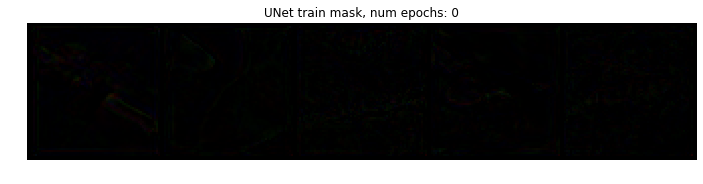

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


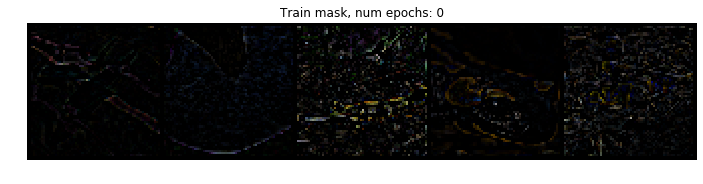

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


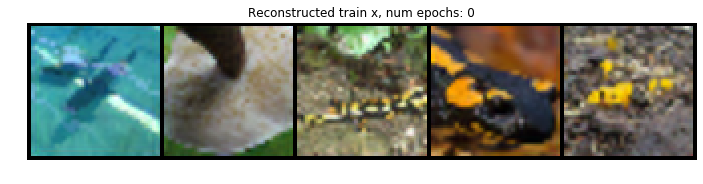

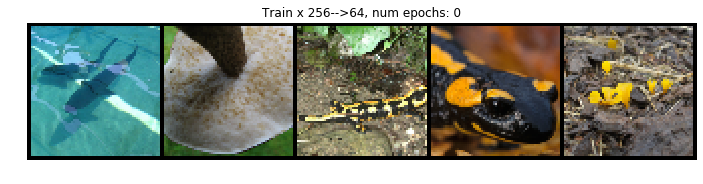

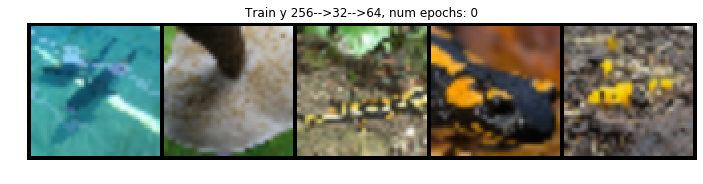

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


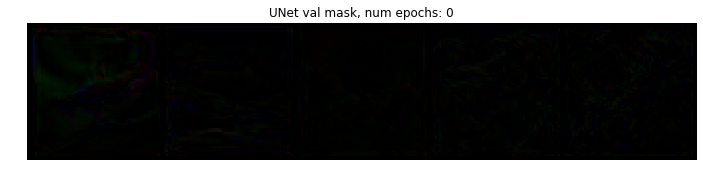

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


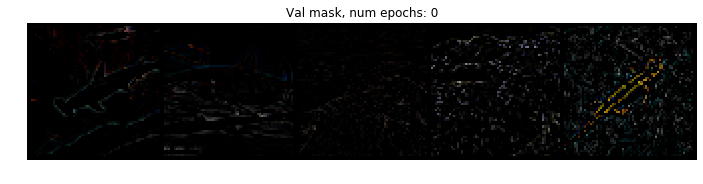

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


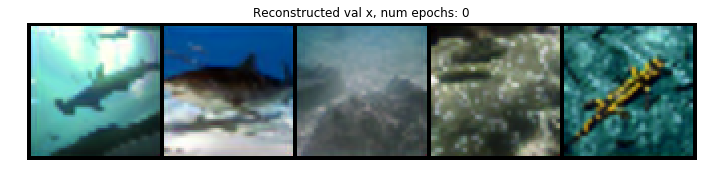

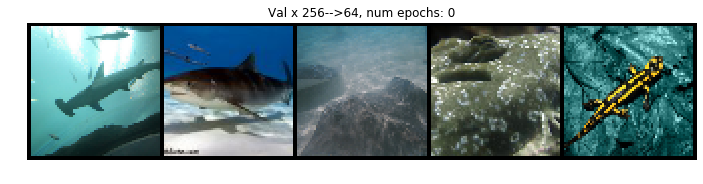

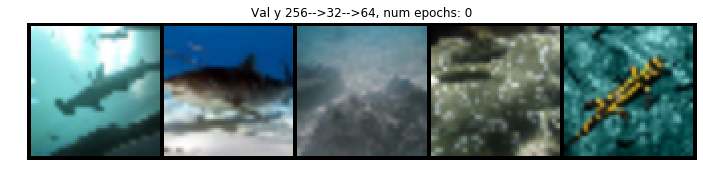

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


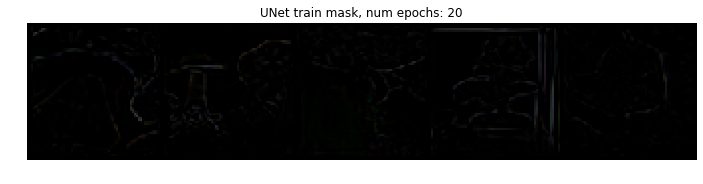

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


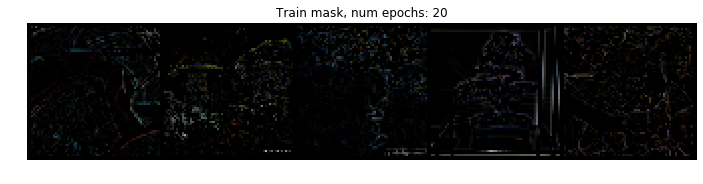

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


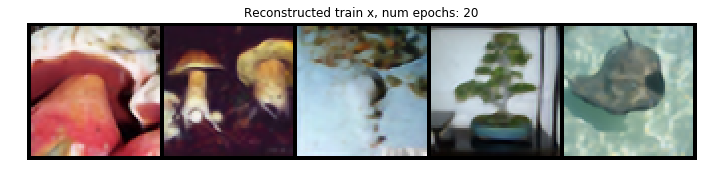

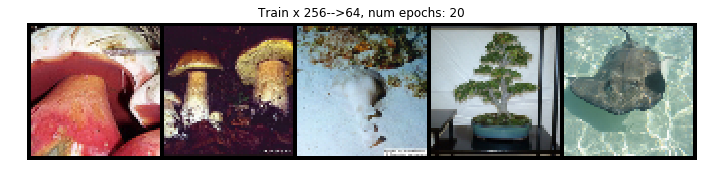

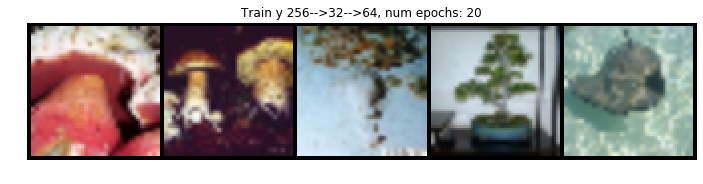

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


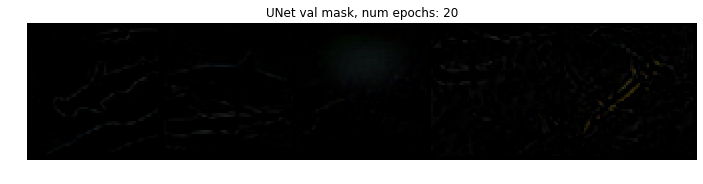

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


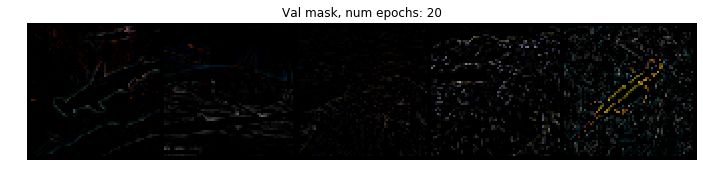

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


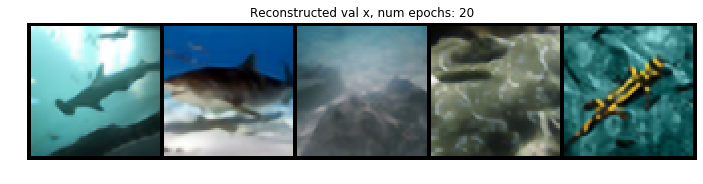

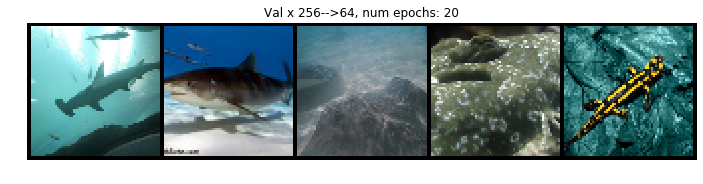

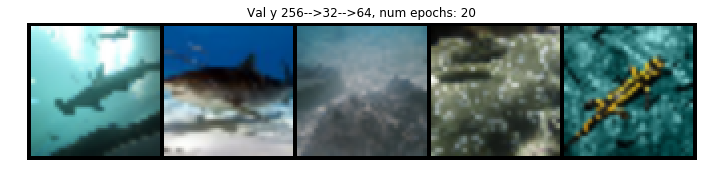

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


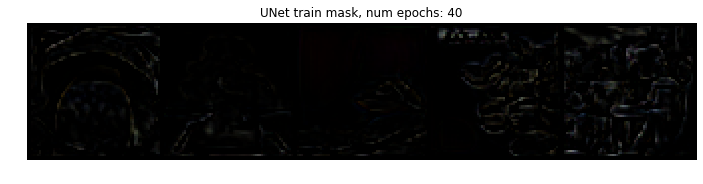

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


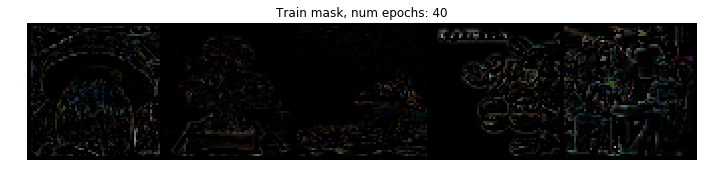

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


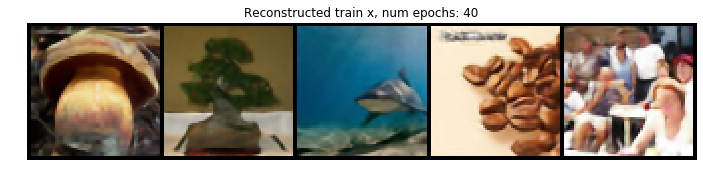

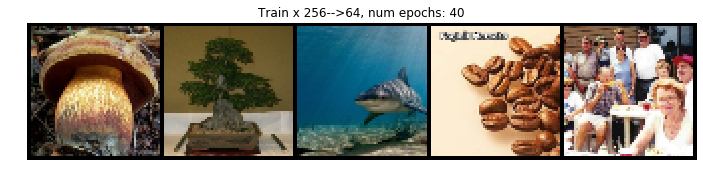

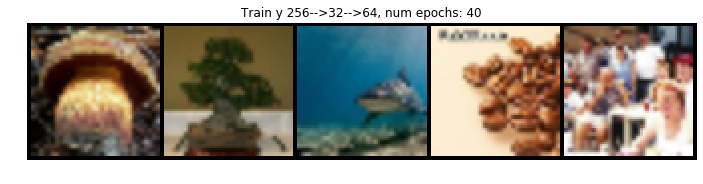

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


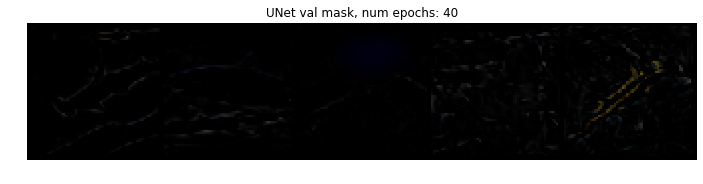

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


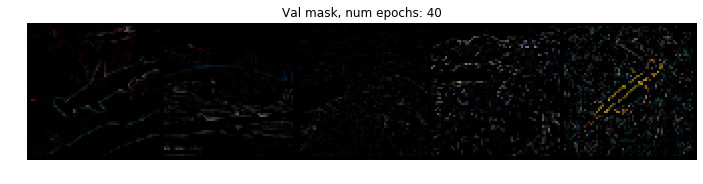

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


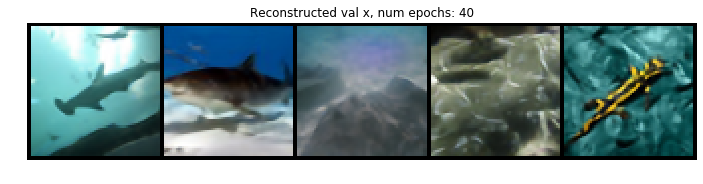

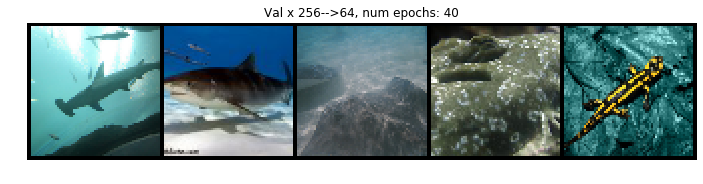

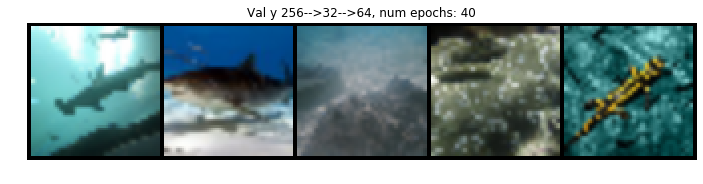

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


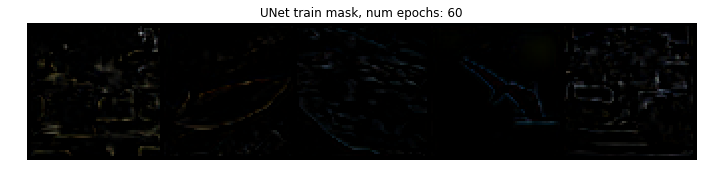

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


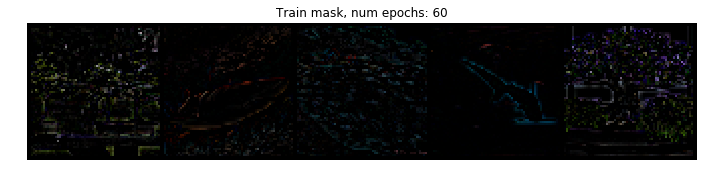

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


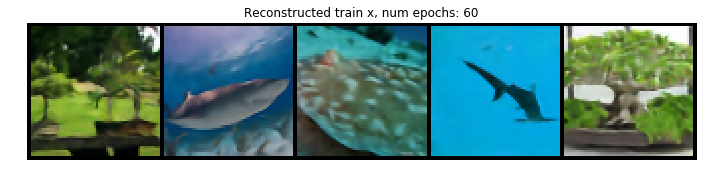

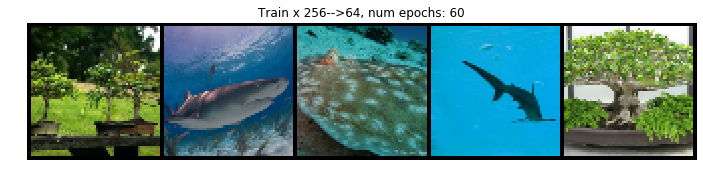

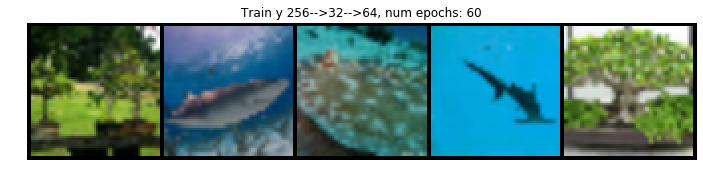

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


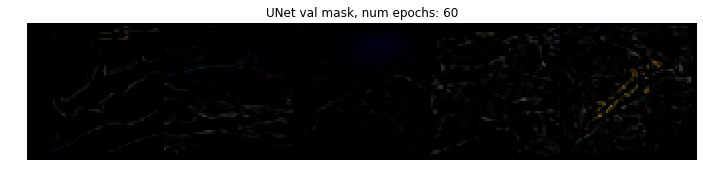

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


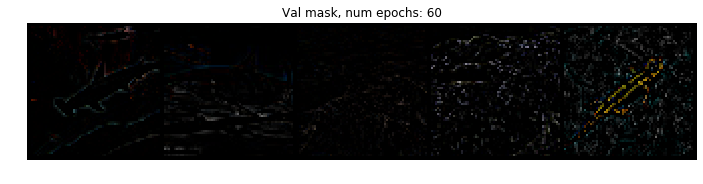

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


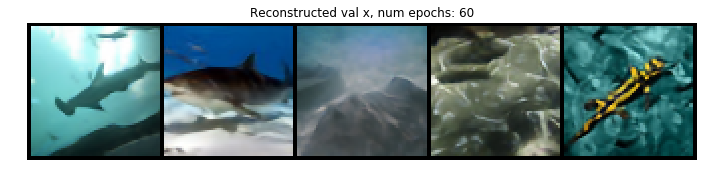

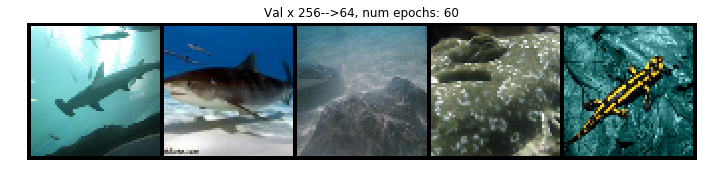

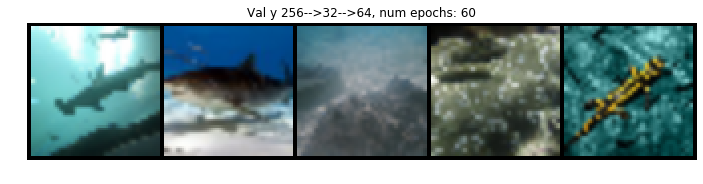

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


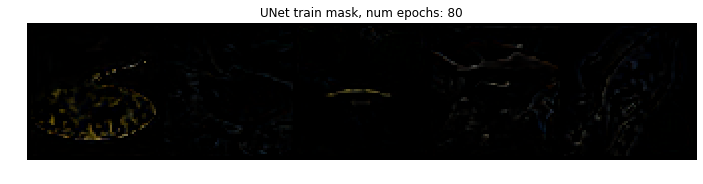

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


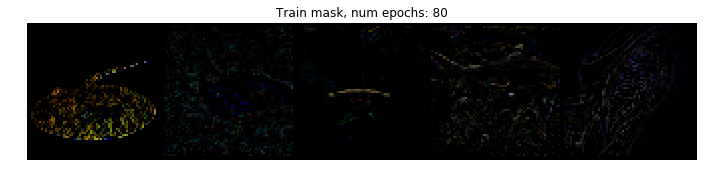

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


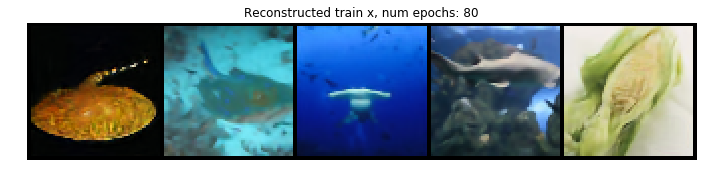

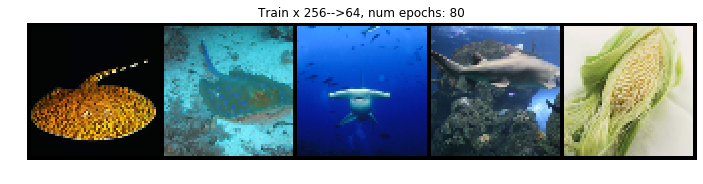

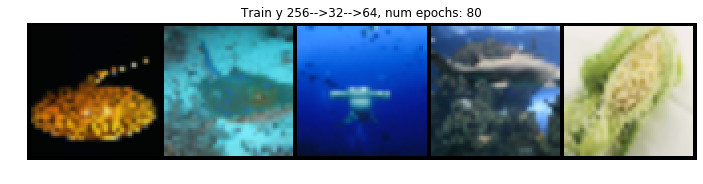

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


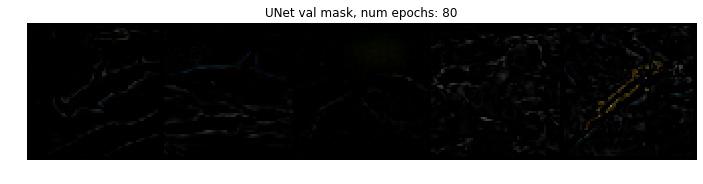

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


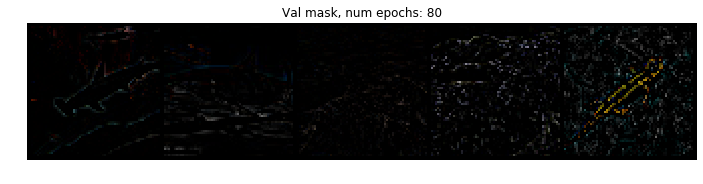

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


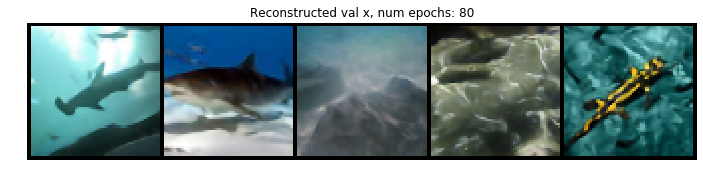

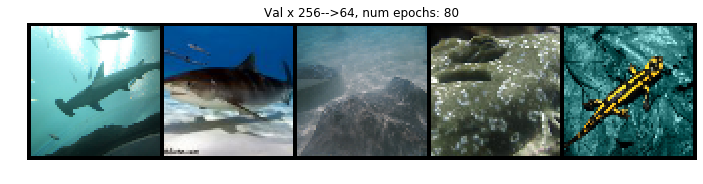

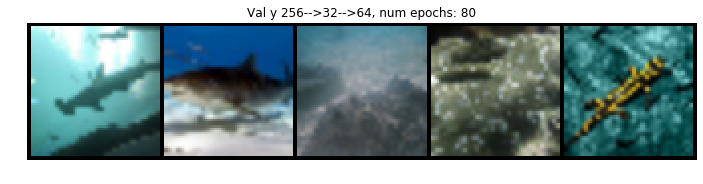

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


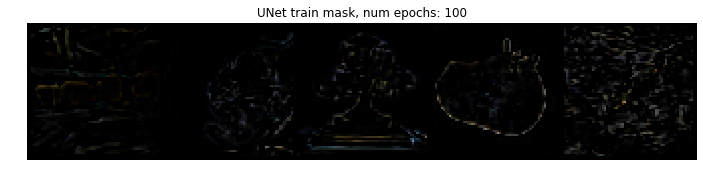

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


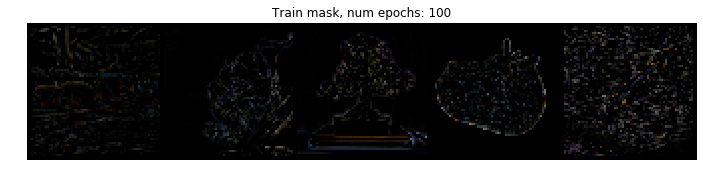

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


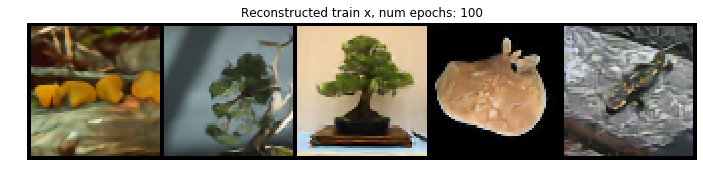

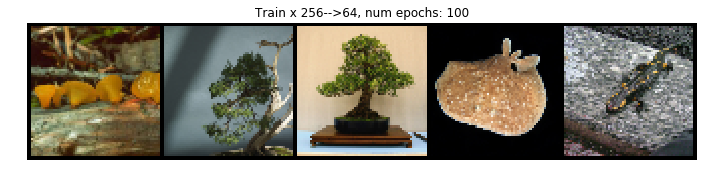

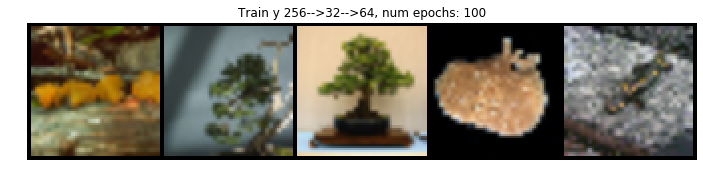

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


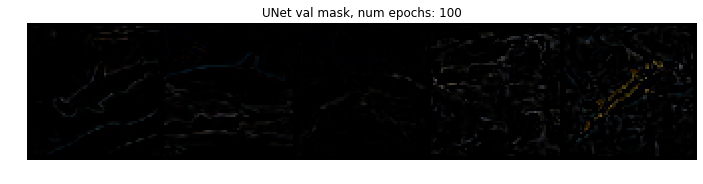

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


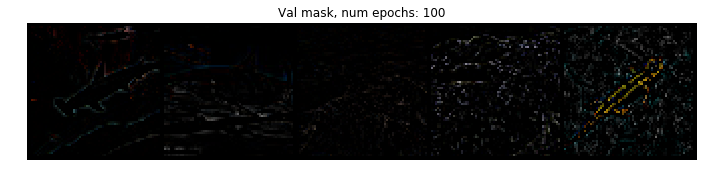

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


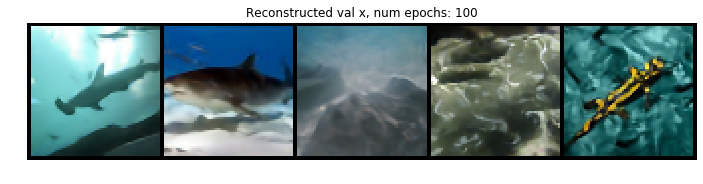

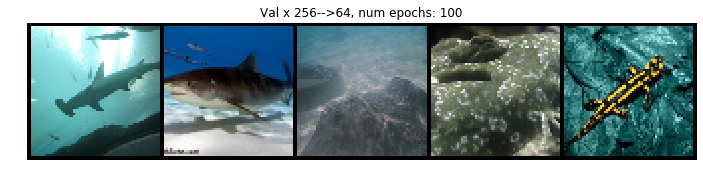

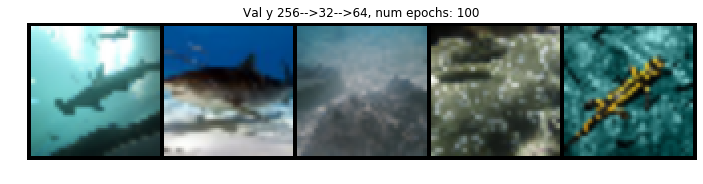

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


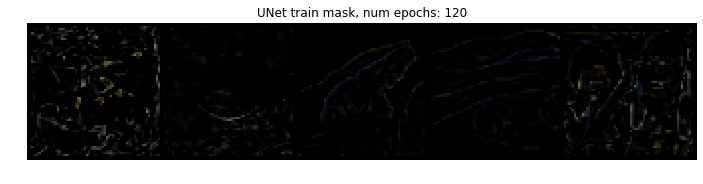

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


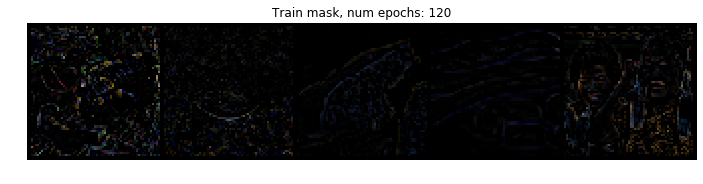

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


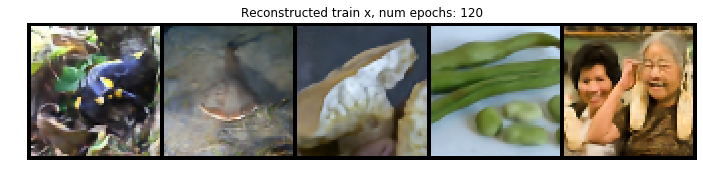

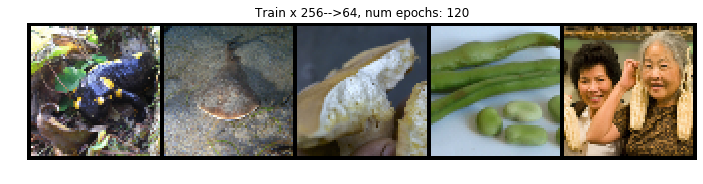

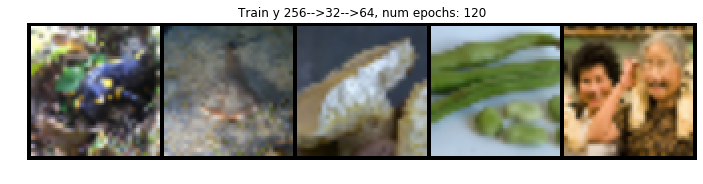

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


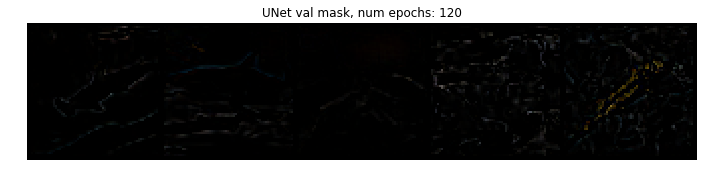

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


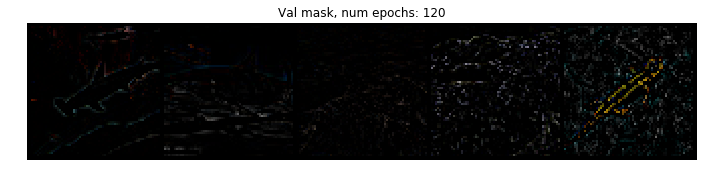

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


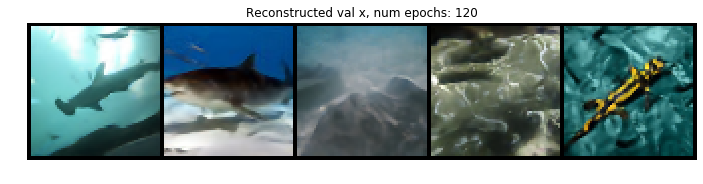

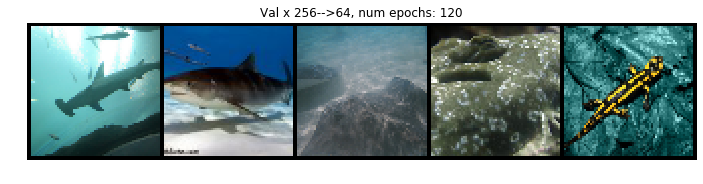

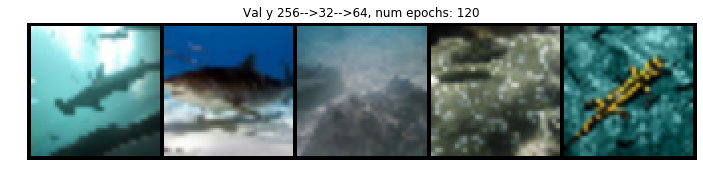

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


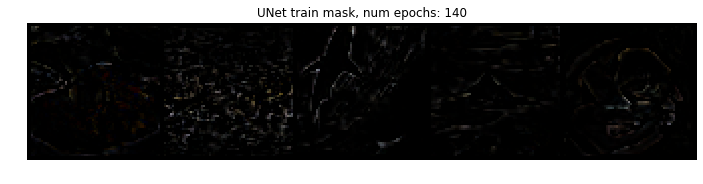

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


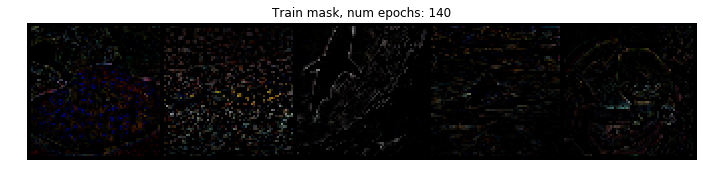

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


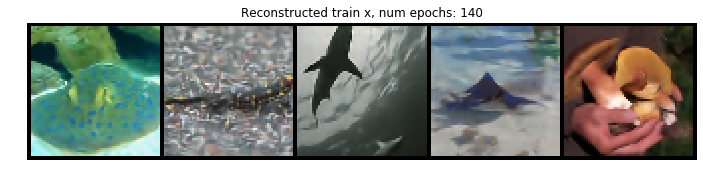

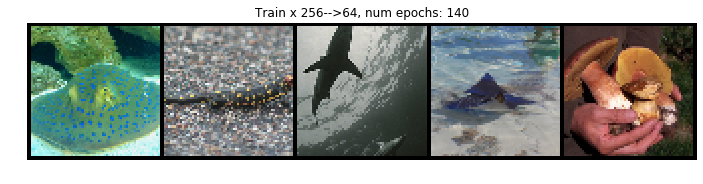

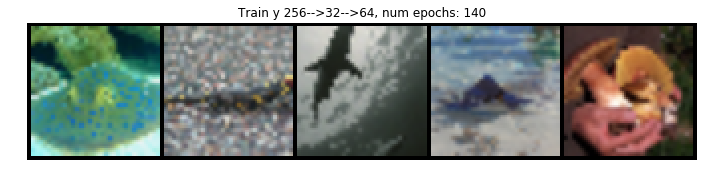

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


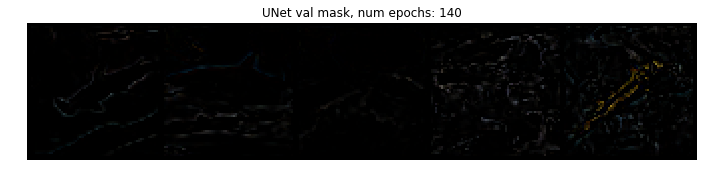

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


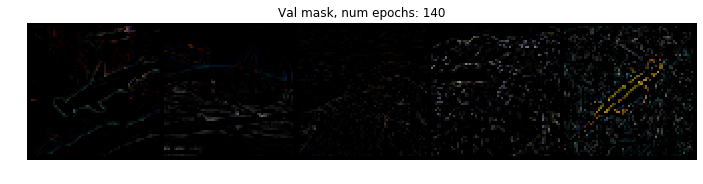

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


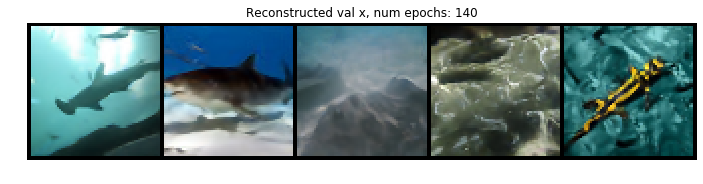

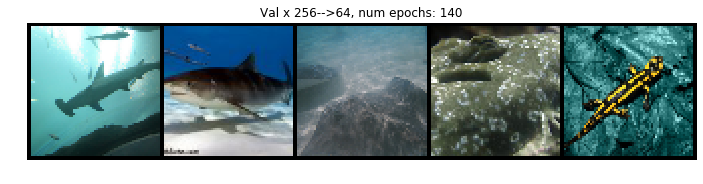

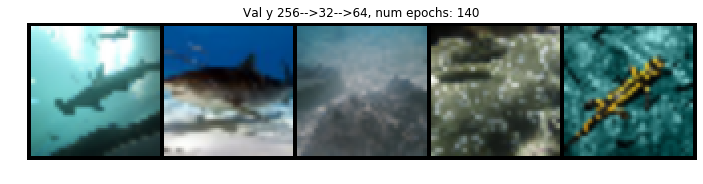

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


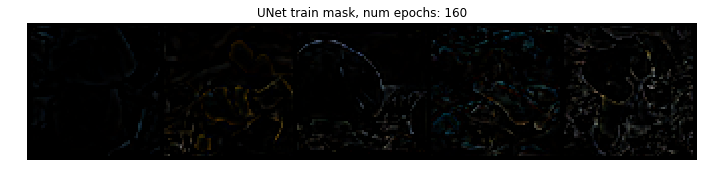

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


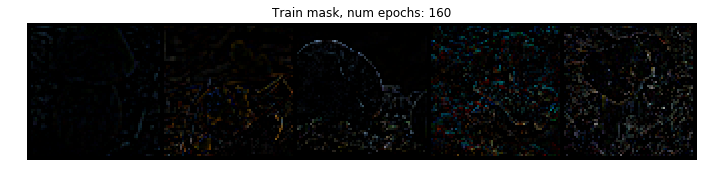

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


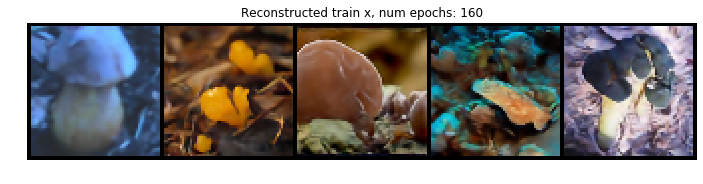

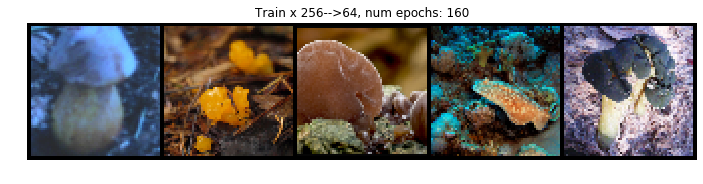

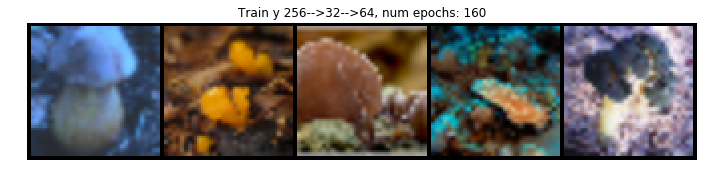

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


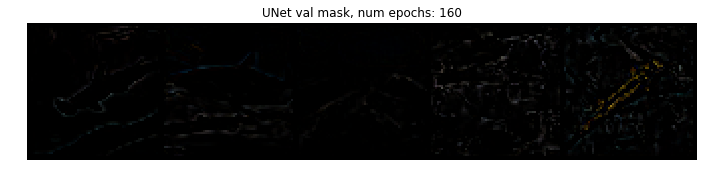

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


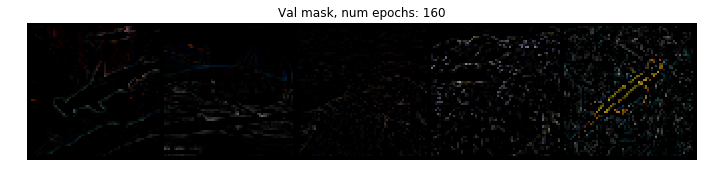

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


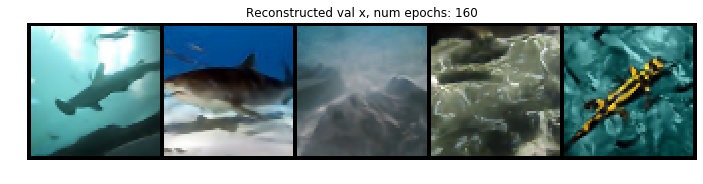

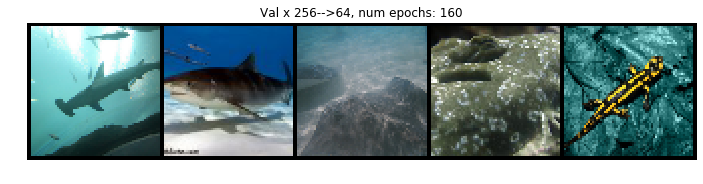

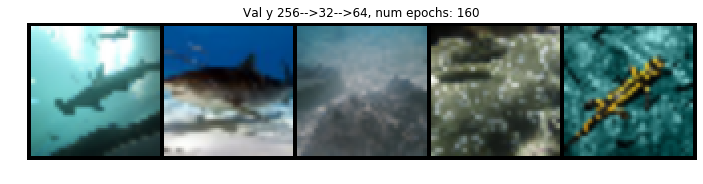

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


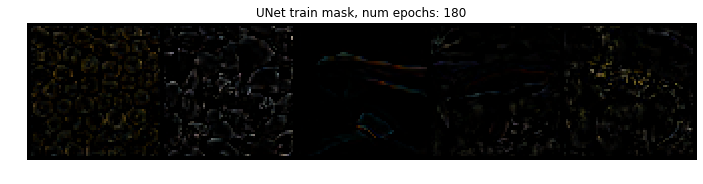

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


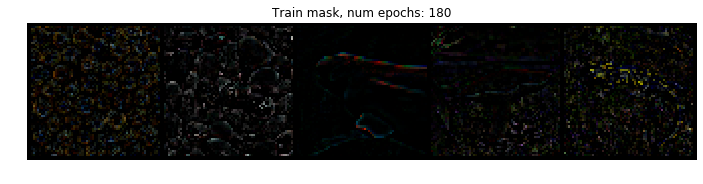

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


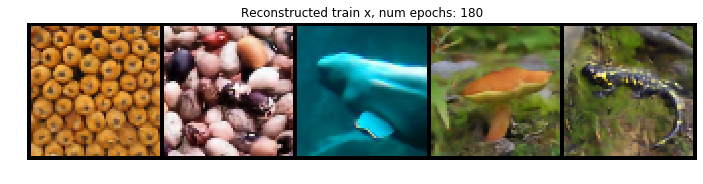

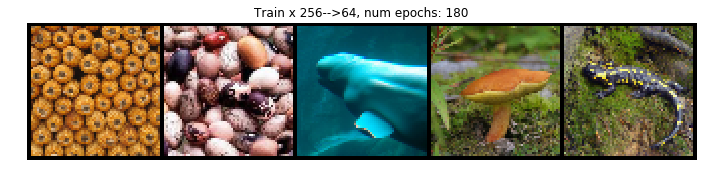

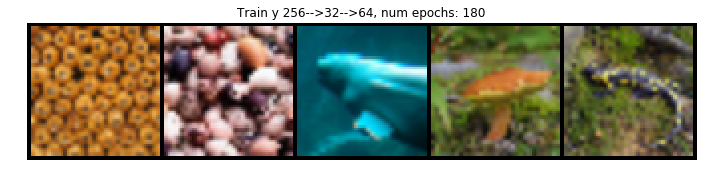

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


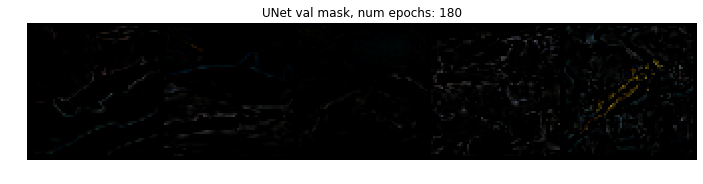

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


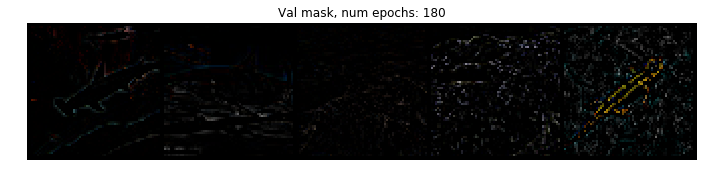

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


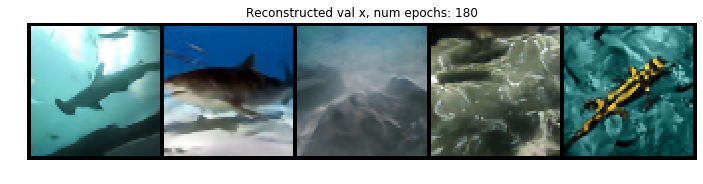

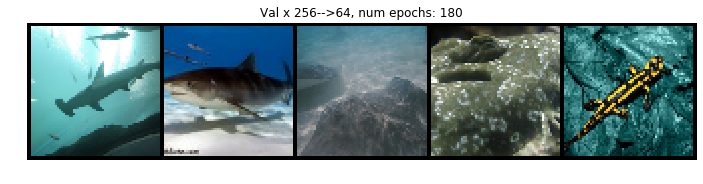

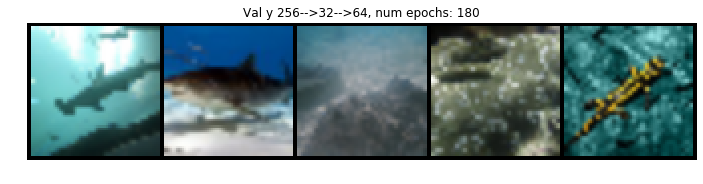

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


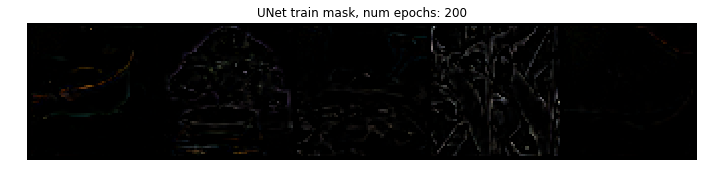

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


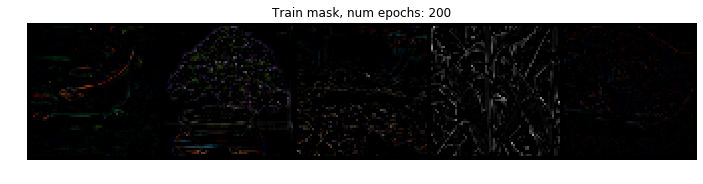

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


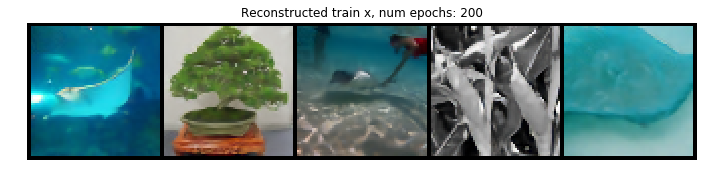

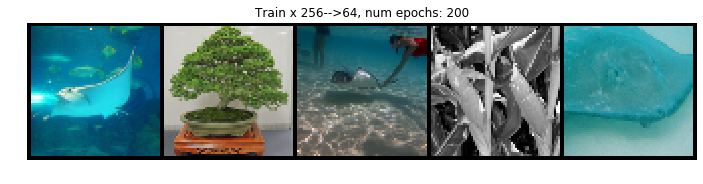

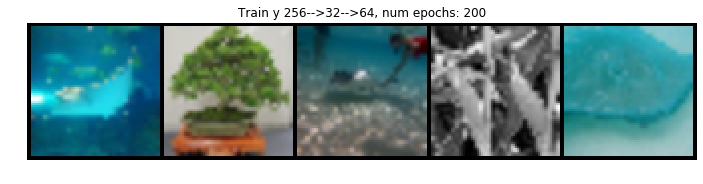

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


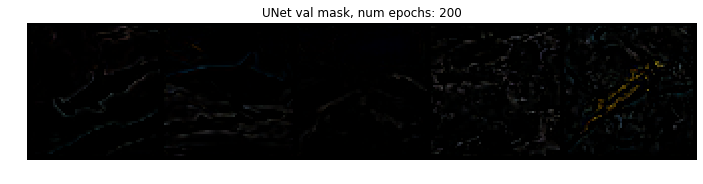

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


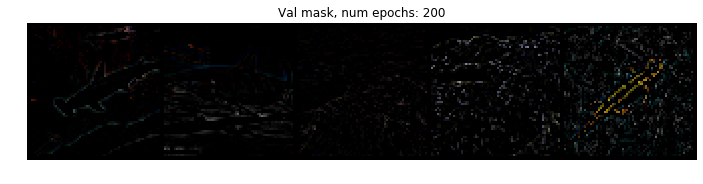

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


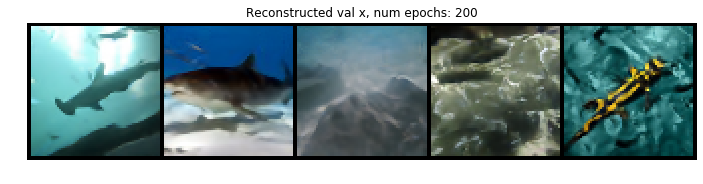

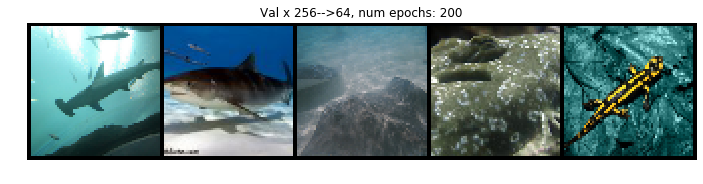

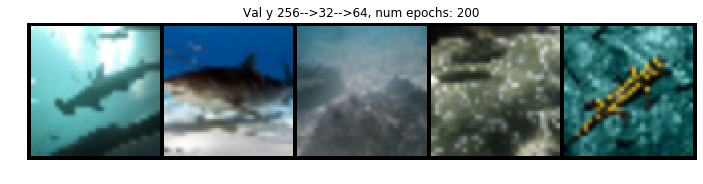

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


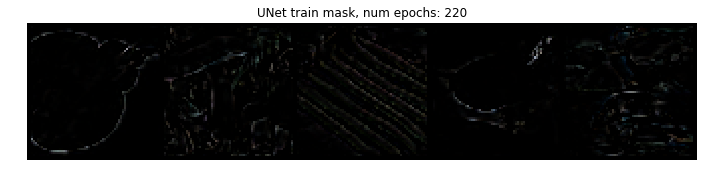

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


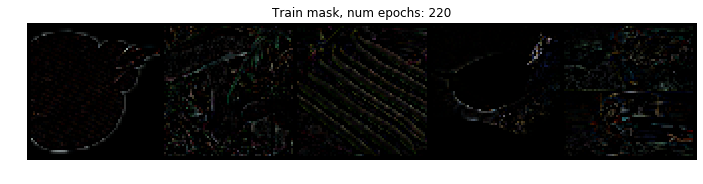

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


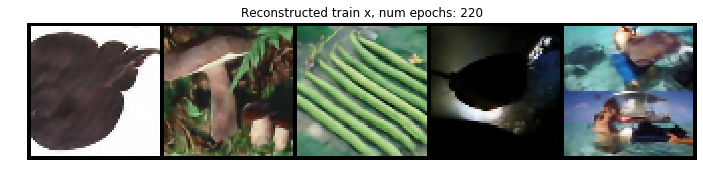

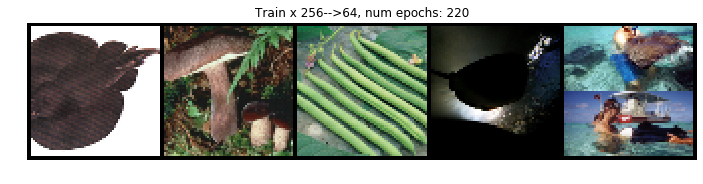

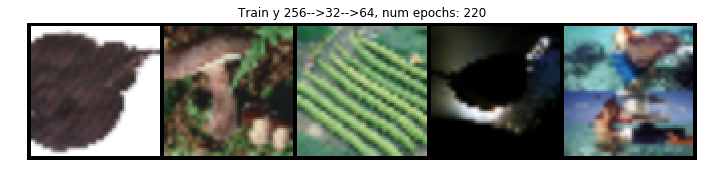

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


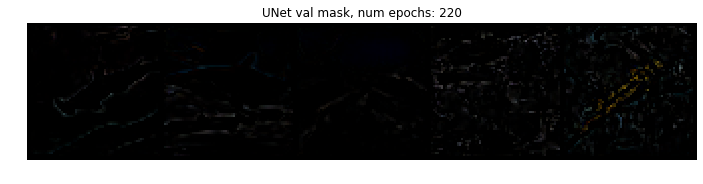

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


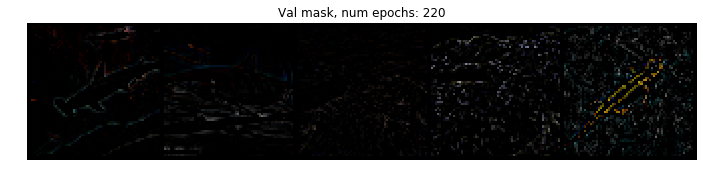

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


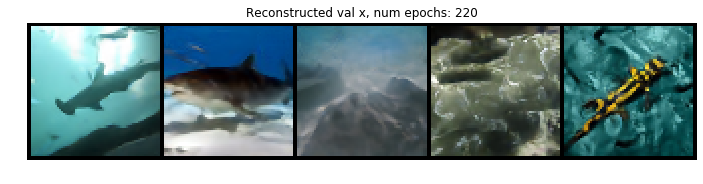

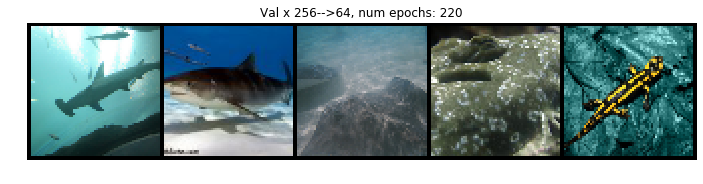

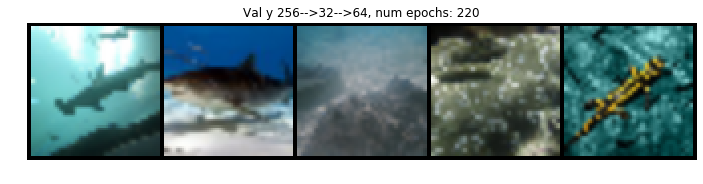

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


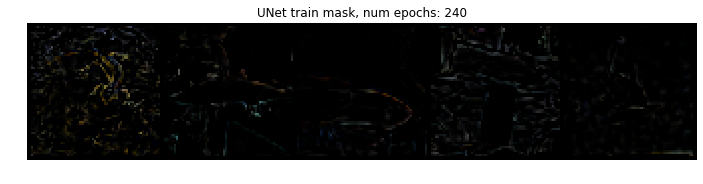

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


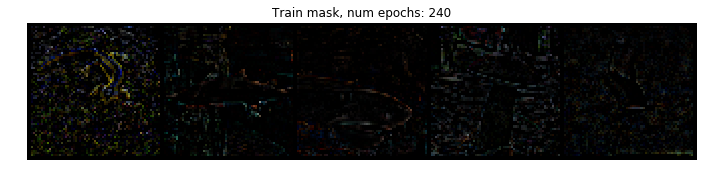

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


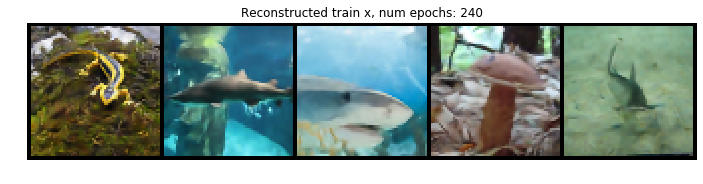

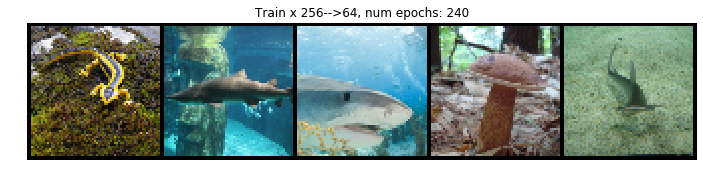

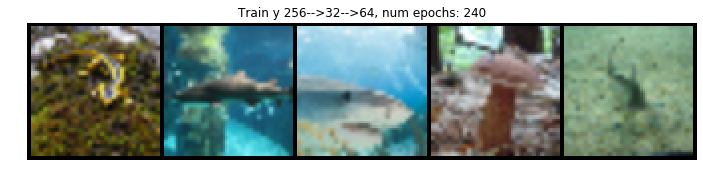

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


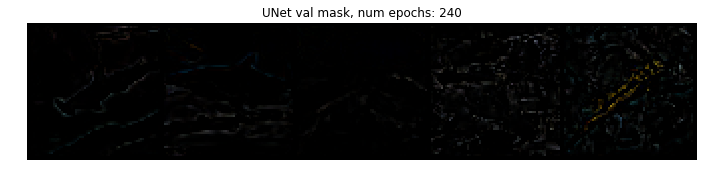

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


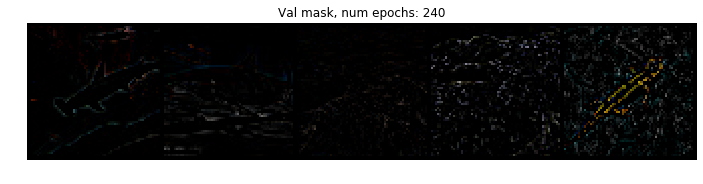

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


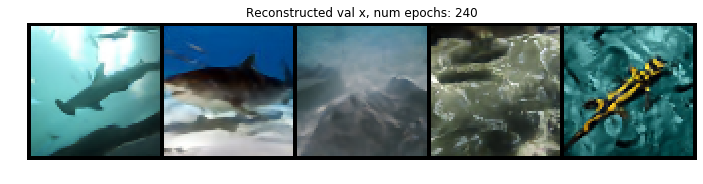

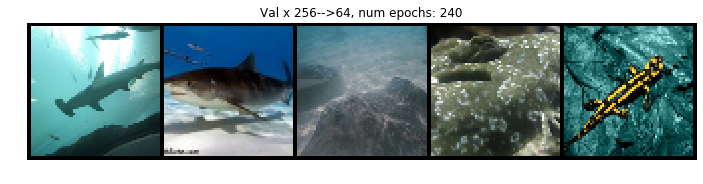

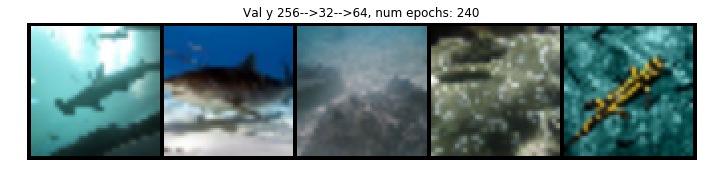

requests_with_retry encountered retryable exception: 500 Server Error: Internal Server Error for url: https://api.wandb.ai/files/churwitz/UNET_imagenet/n1syf3zx/file_stream. args: ('https://api.wandb.ai/files/churwitz/UNET_imagenet/n1syf3zx/file_stream',), kwargs: {'json': {'files': {'wandb-events.jsonl': {'offset': 543, 'content': ['{"system.gpu.0.gpu": 96.4, "system.gpu.0.memory": 37.6, "system.gpu.0.memory_allocated": 70.06, "system.gpu.0.temp": 59.4, "system.gpu.1.gpu": 98.87, "system.gpu.1.memory": 44.67, "system.gpu.1.memory_allocated": 95.81, "system.gpu.1.temp": 65.47, "system.cpu": 98.65, "system.memory": 8.46, "system.disk": 93.9, "system.proc.memory.availableMB": 110661.27, "system.proc.memory.rssMB": 2527.12, "system.proc.memory.percent": 2.09, "system.proc.cpu.threads": 42.33, "system.network.sent": 478922921, "system.network.recv": 261030445, "_wandb": true, "_timestamp": 1588232793, "_runtime": 16461}\n']}, 'wandb-history.jsonl': {'offset': 622, 'content': ['{"train_loss

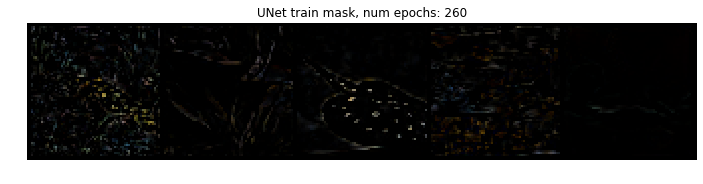

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


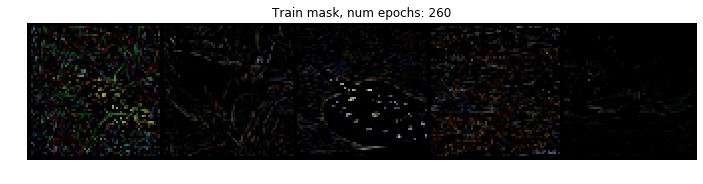

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


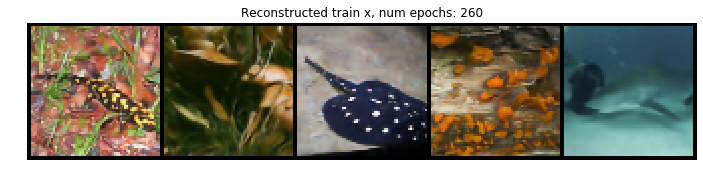

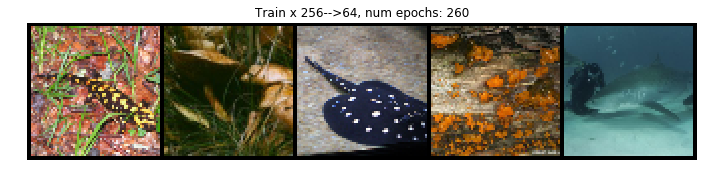

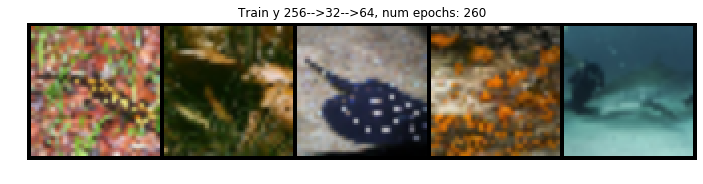

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


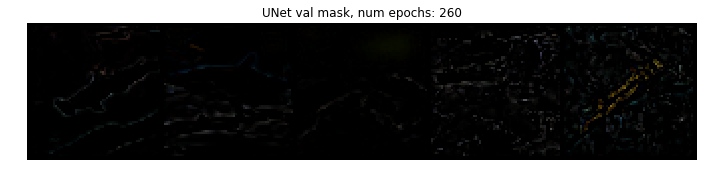

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


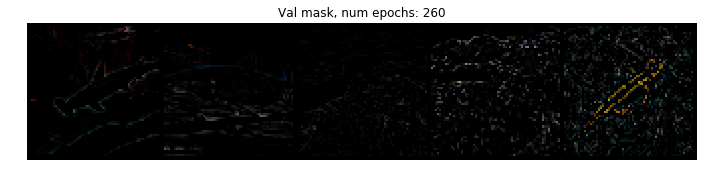

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


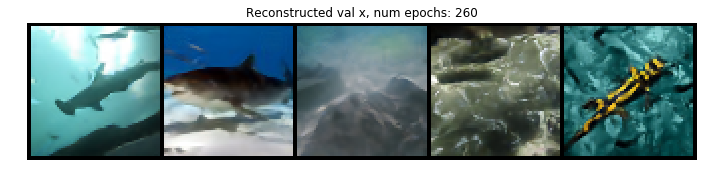

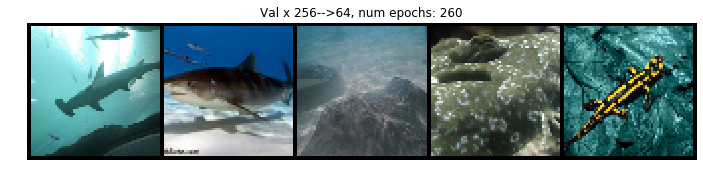

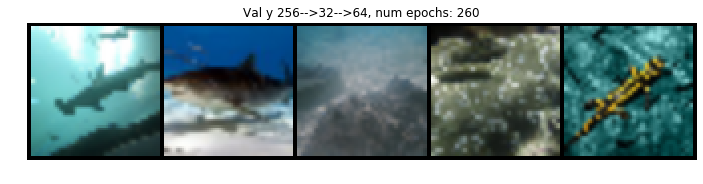

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


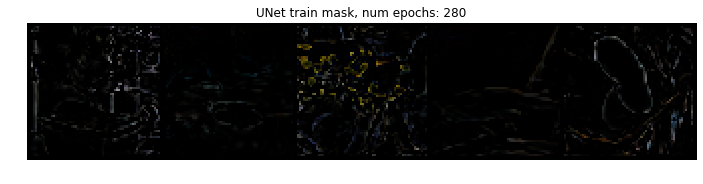

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


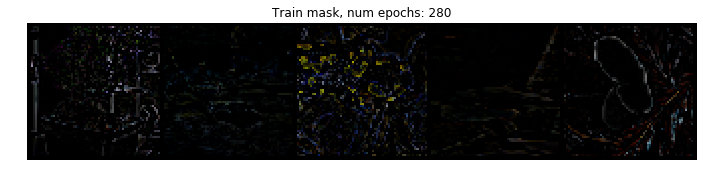

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


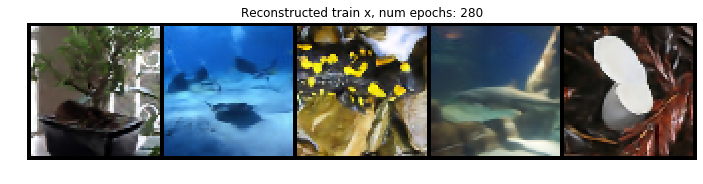

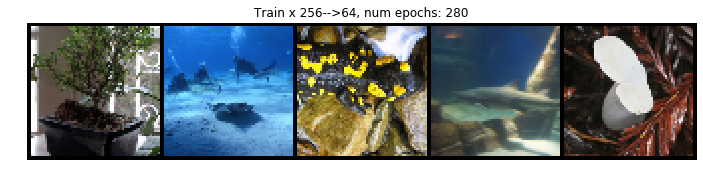

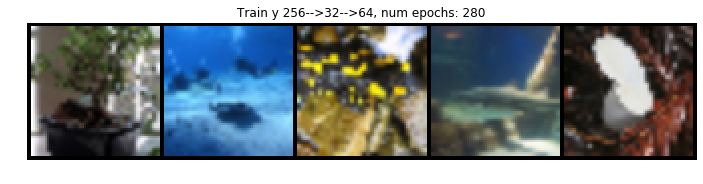

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


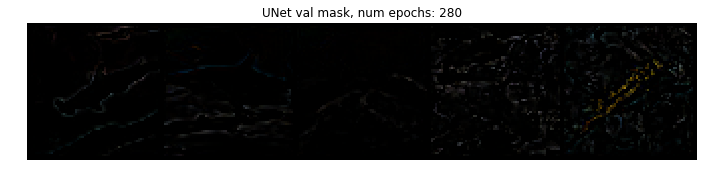

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


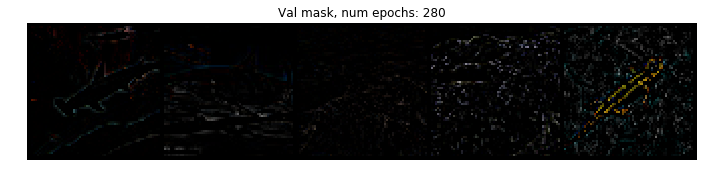

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


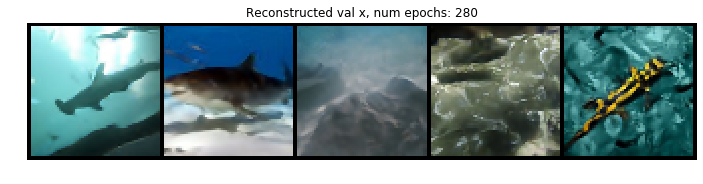

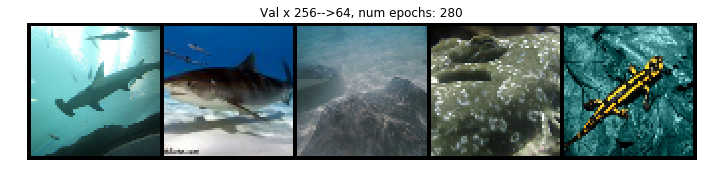

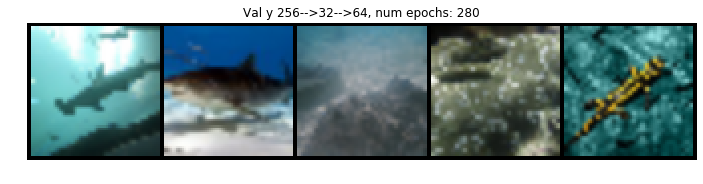

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


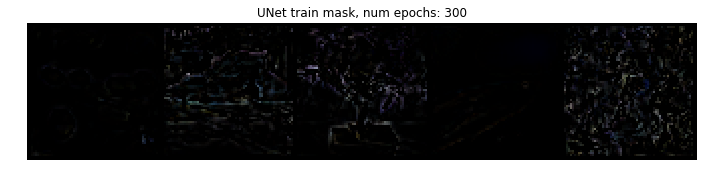

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


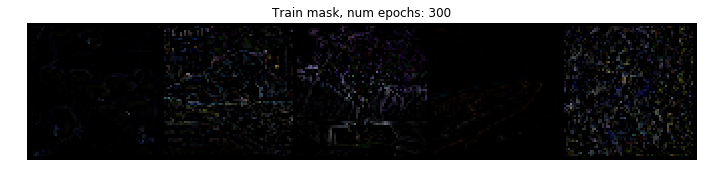

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


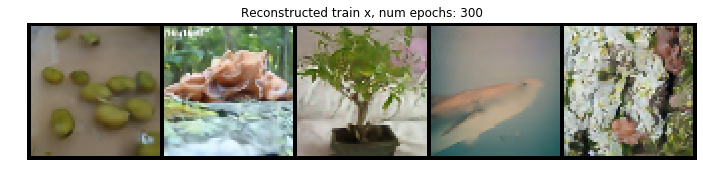

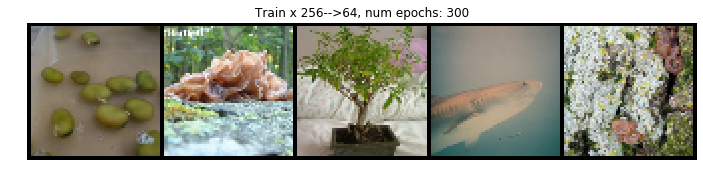

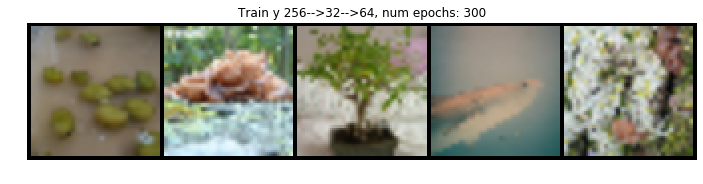

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


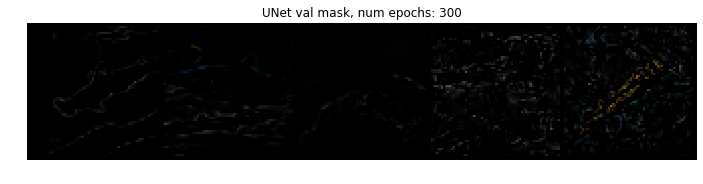

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


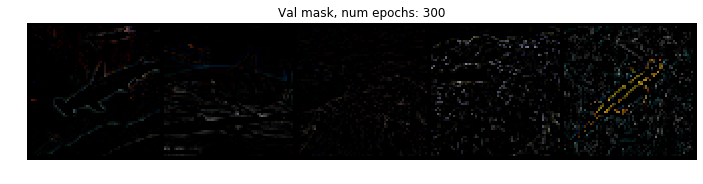

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


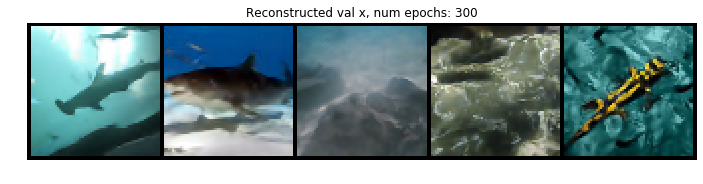

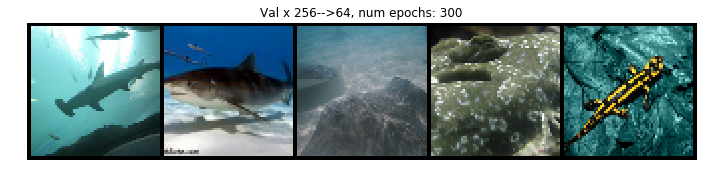

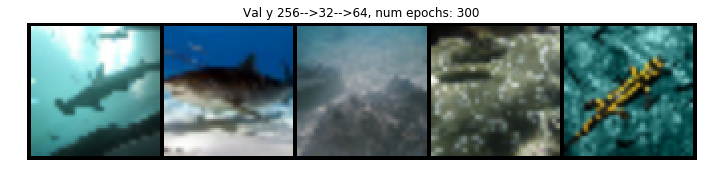

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


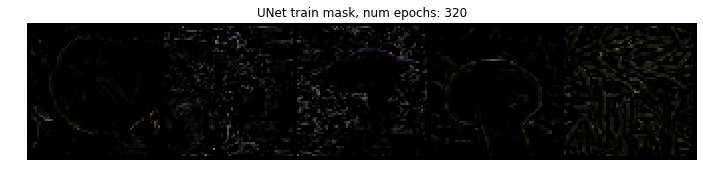

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


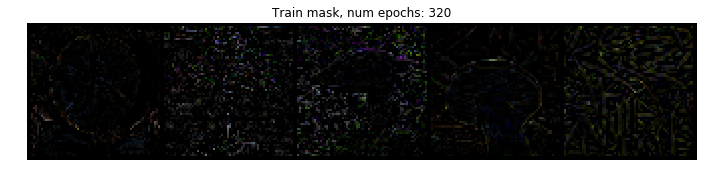

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


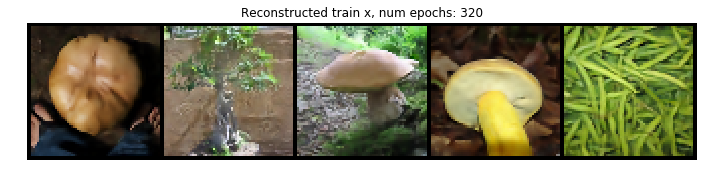

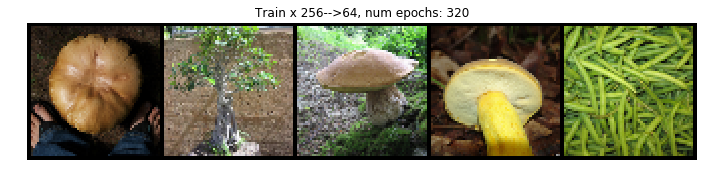

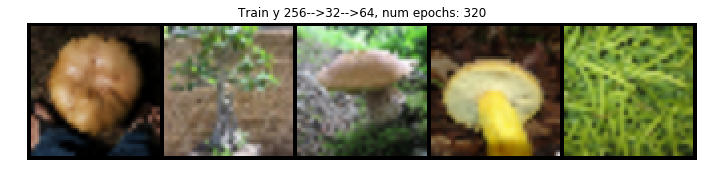

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


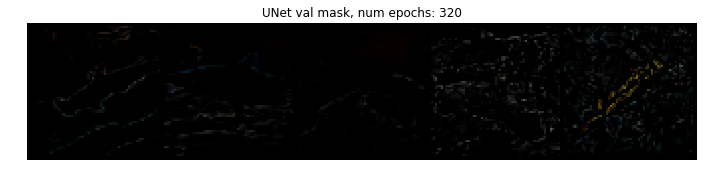

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


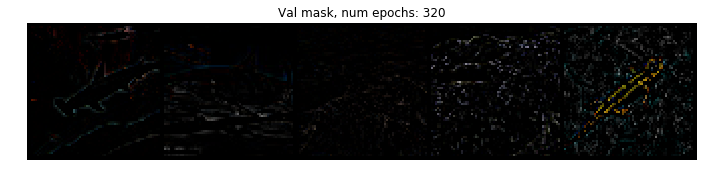

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


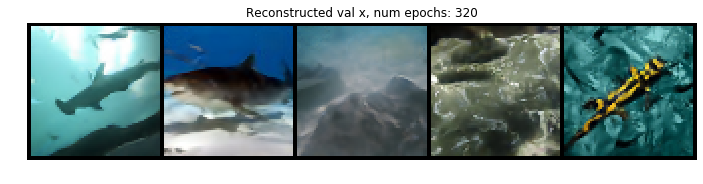

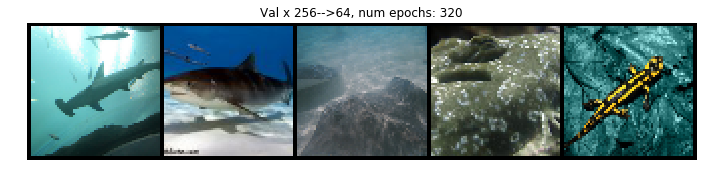

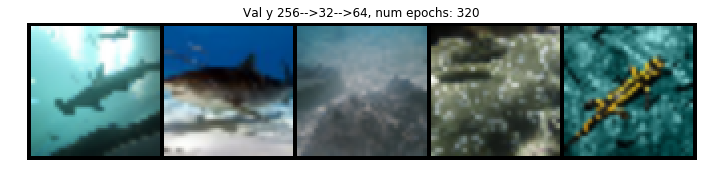

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


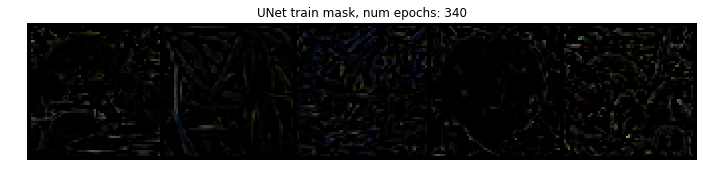

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


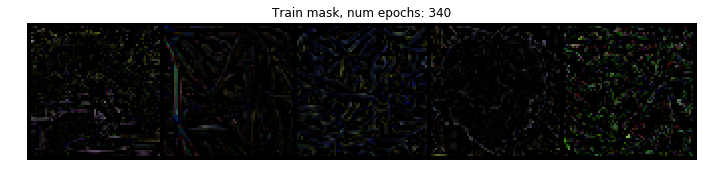

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


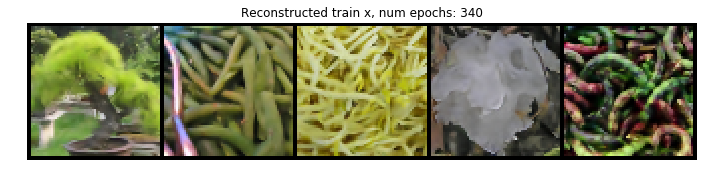

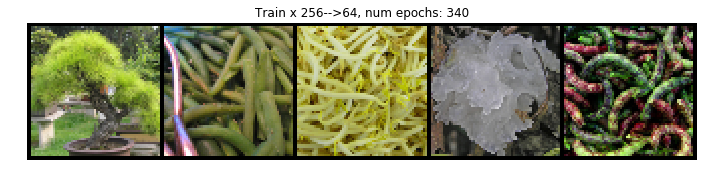

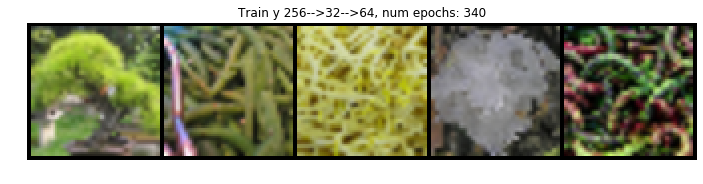

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


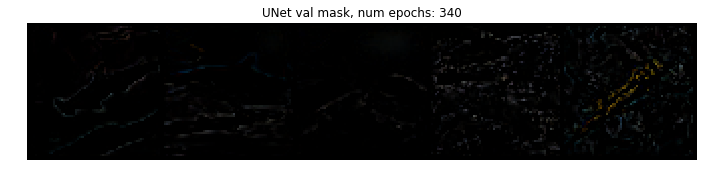

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


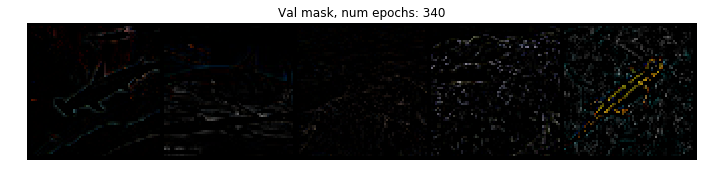

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


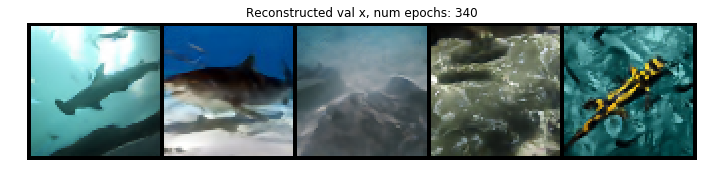

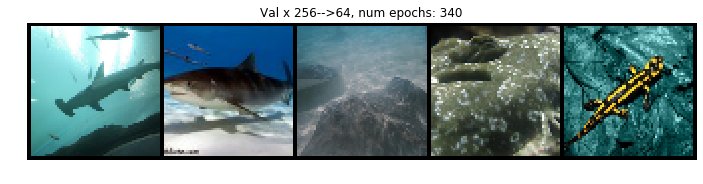

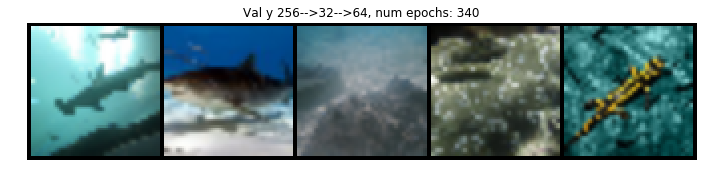

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


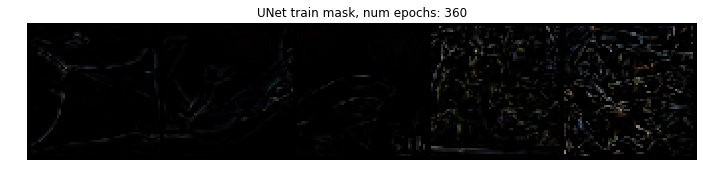

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


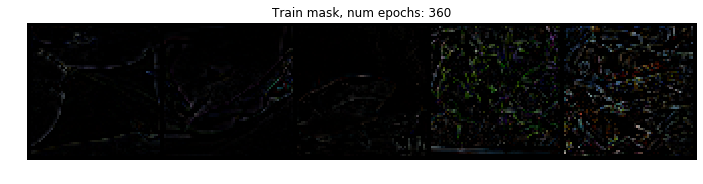

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


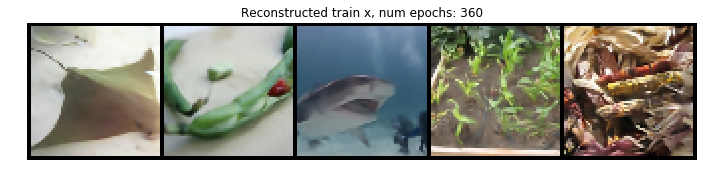

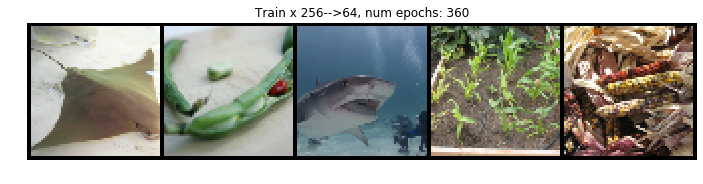

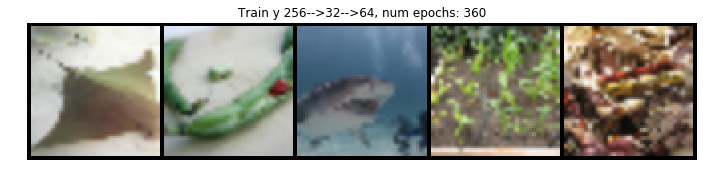

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


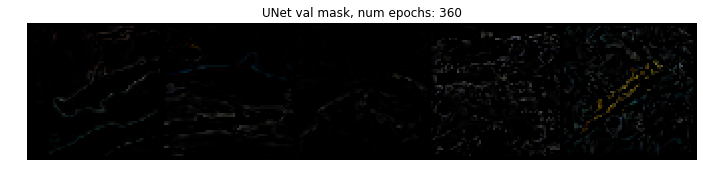

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


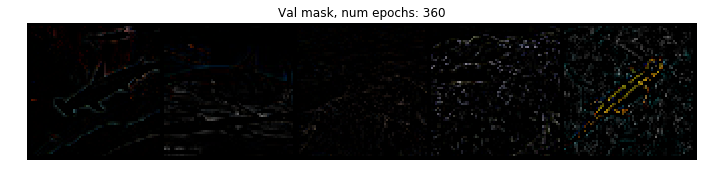

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


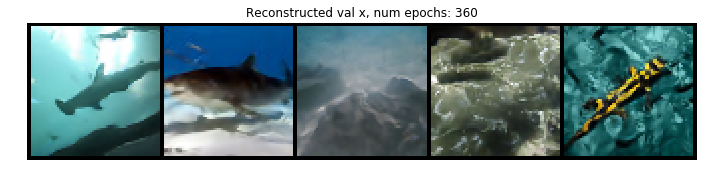

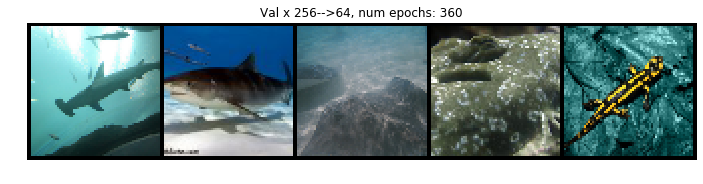

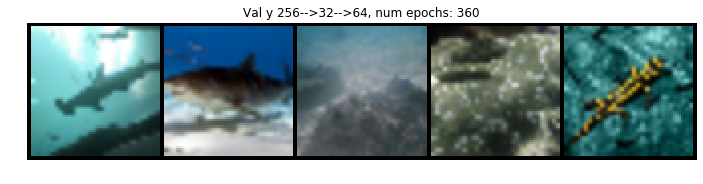

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


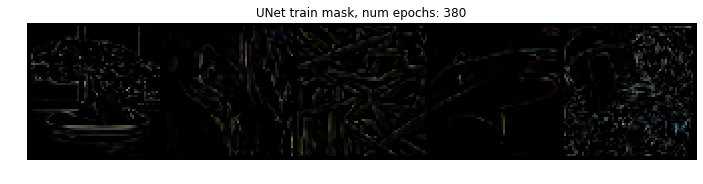

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


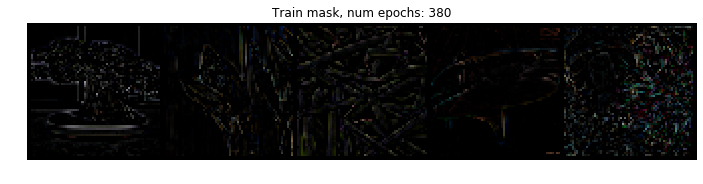

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


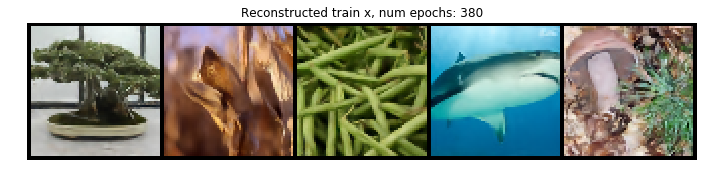

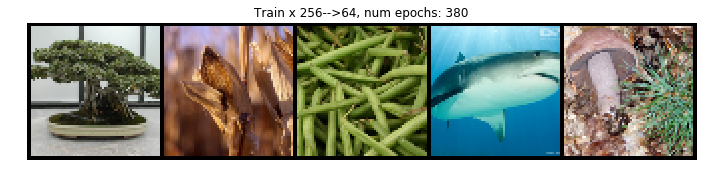

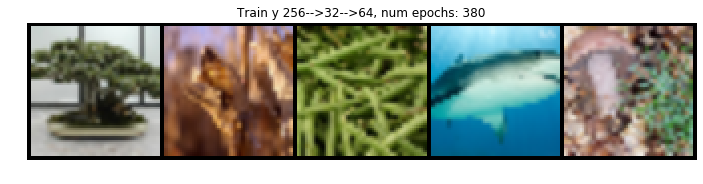

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


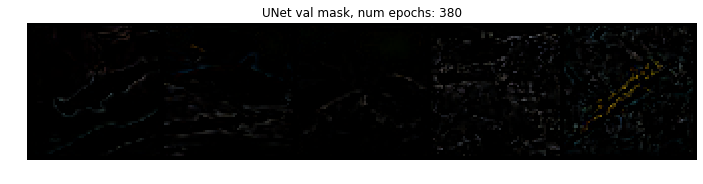

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


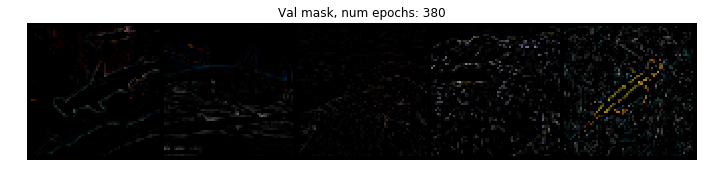

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


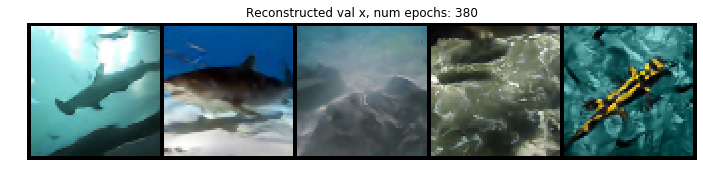

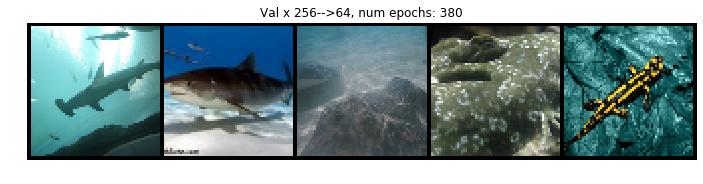

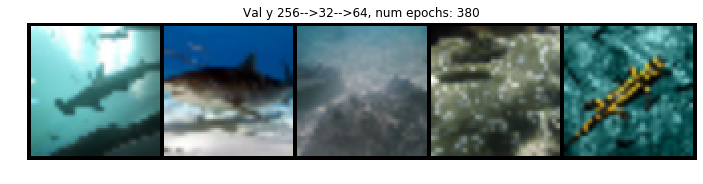

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


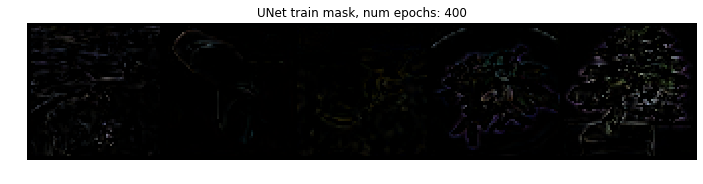

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


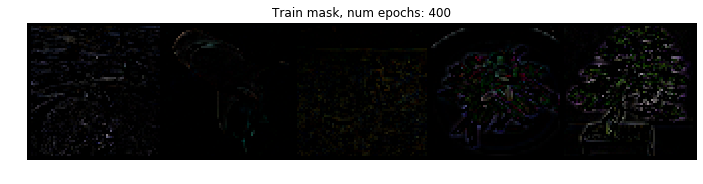

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


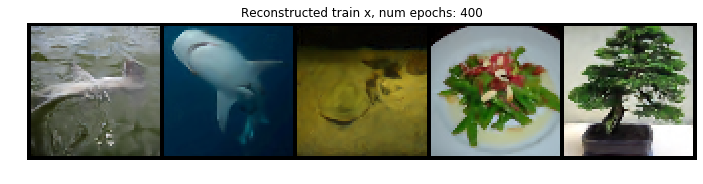

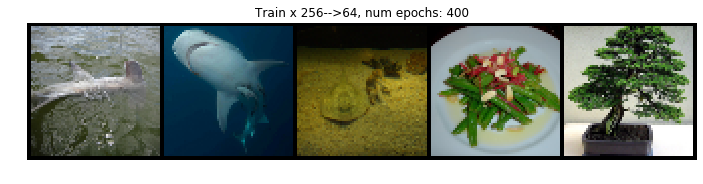

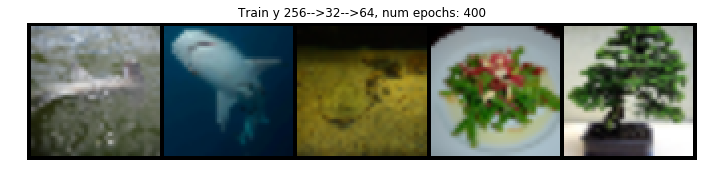

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


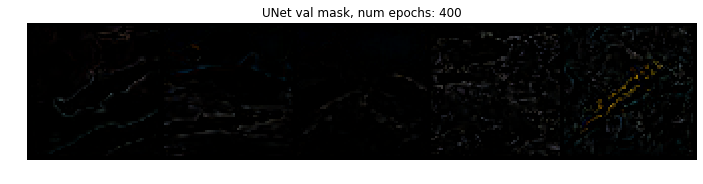

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


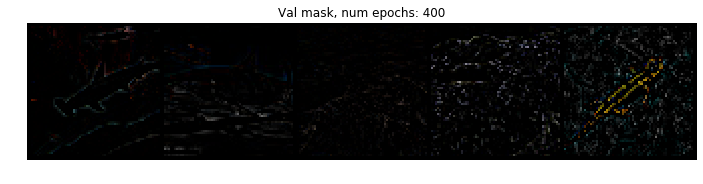

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


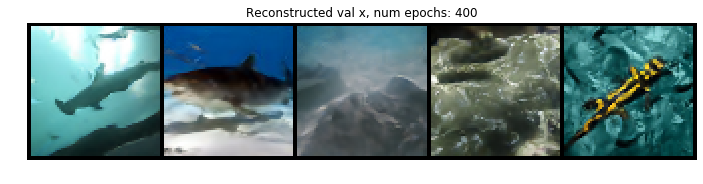

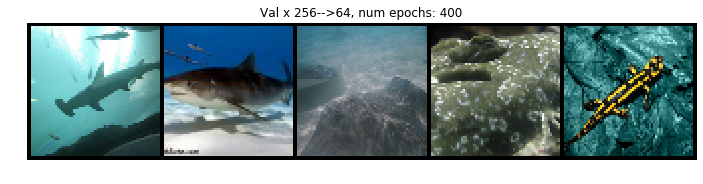

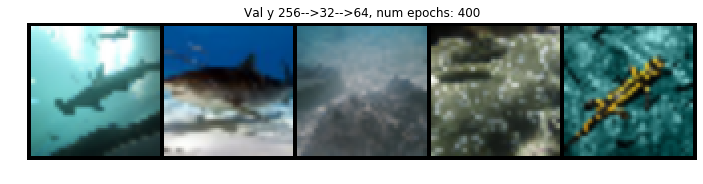

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


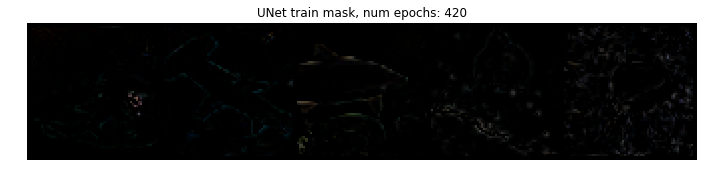

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


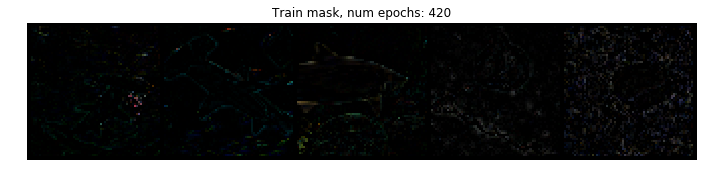

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


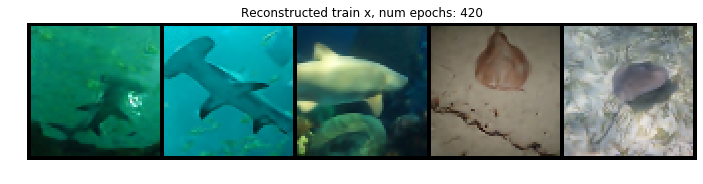

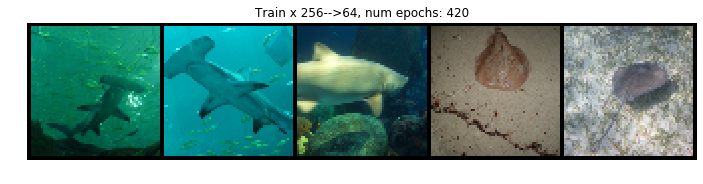

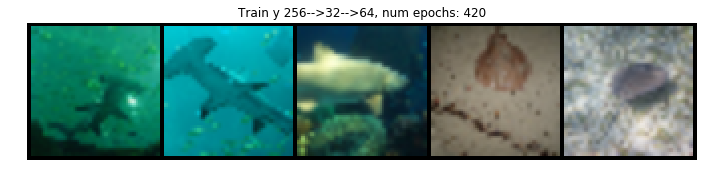

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


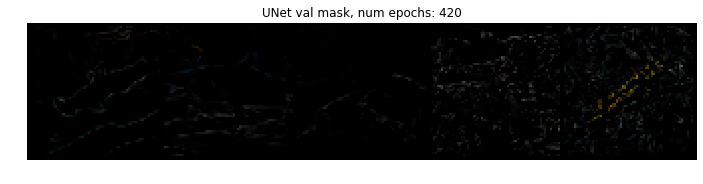

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


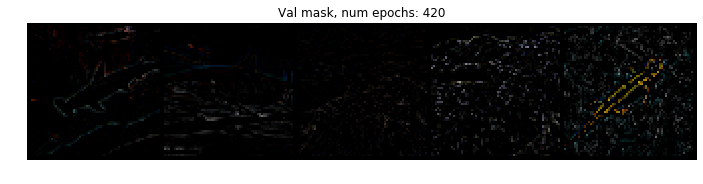

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


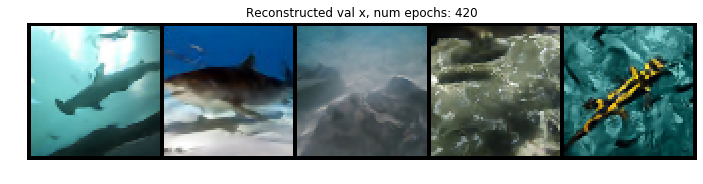

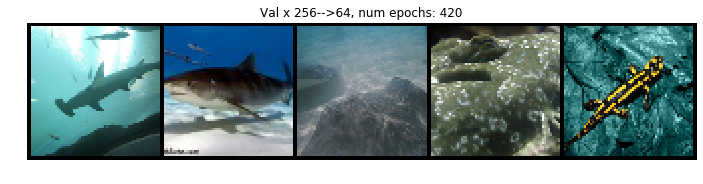

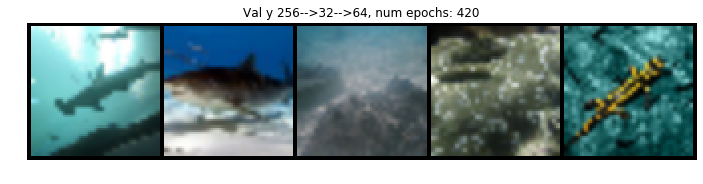

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


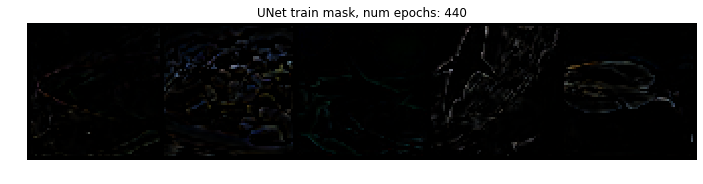

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


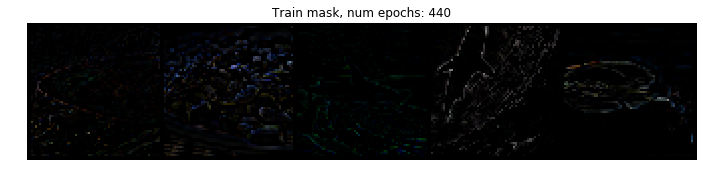

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


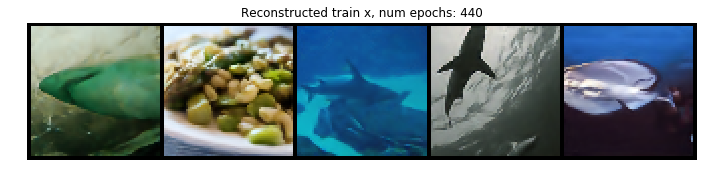

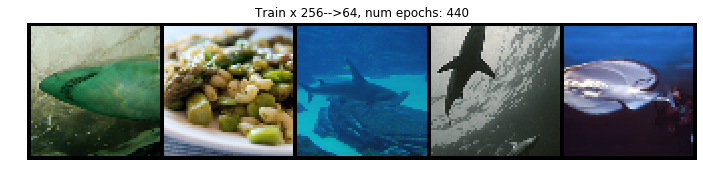

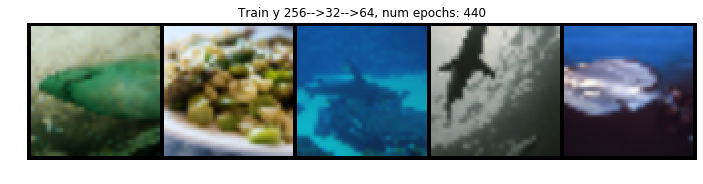

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


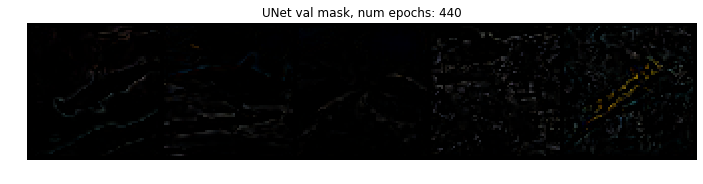

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


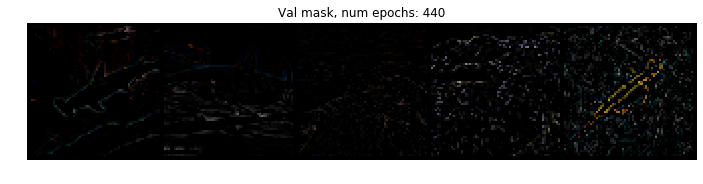

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


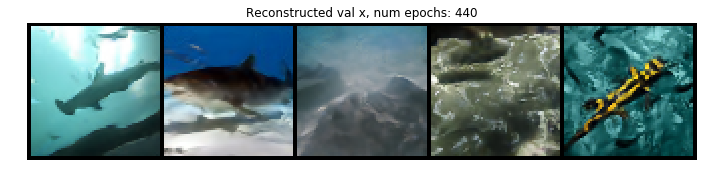

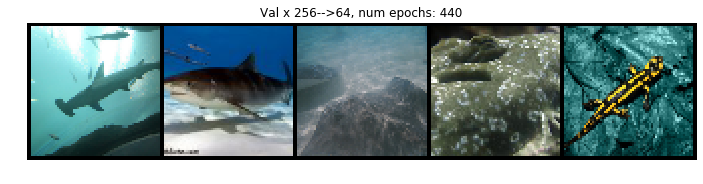

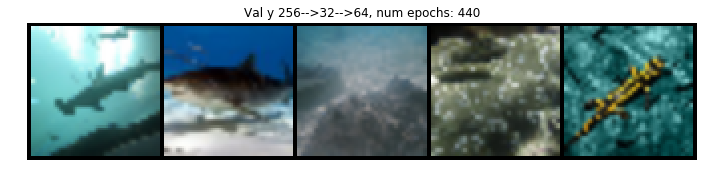

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


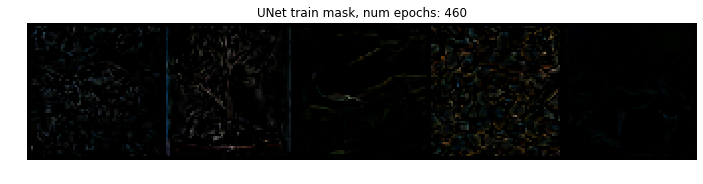

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


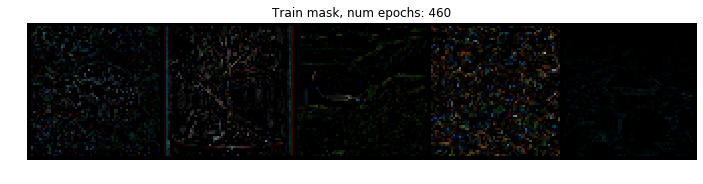

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


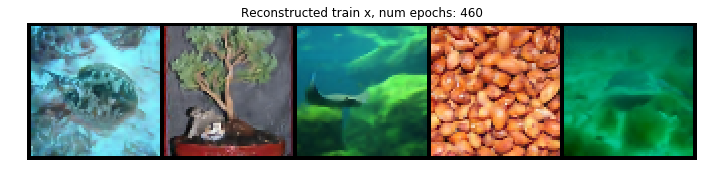

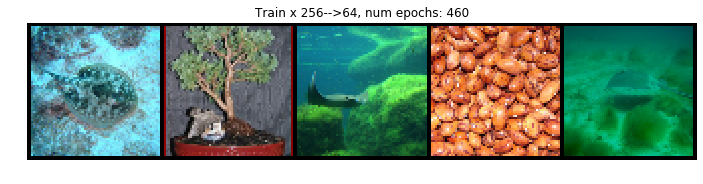

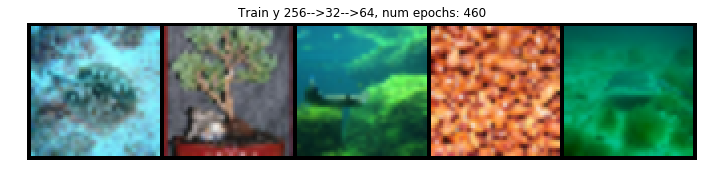

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


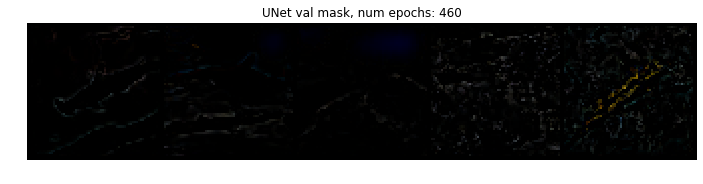

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


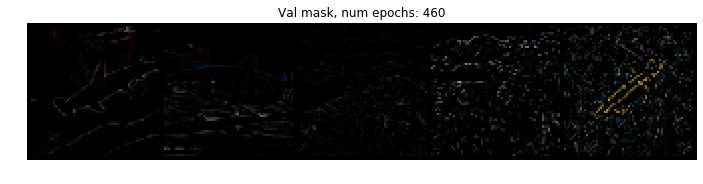

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


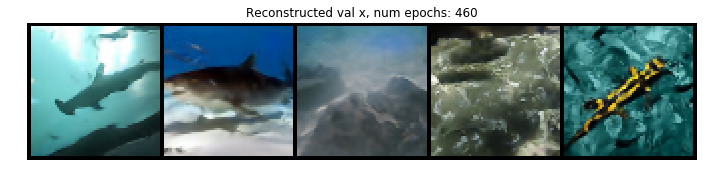

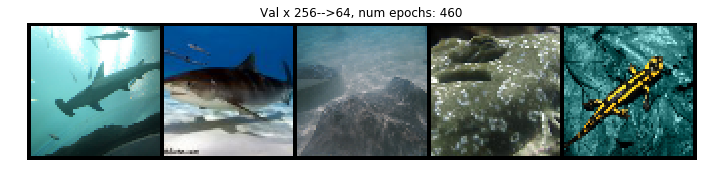

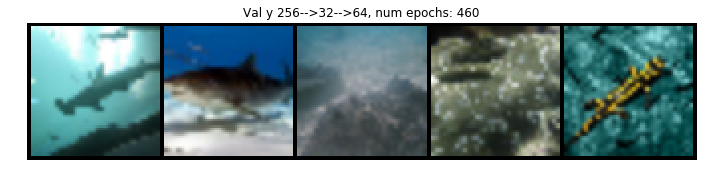

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


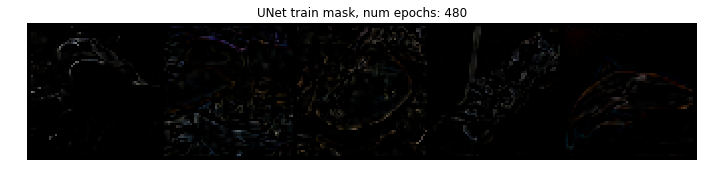

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


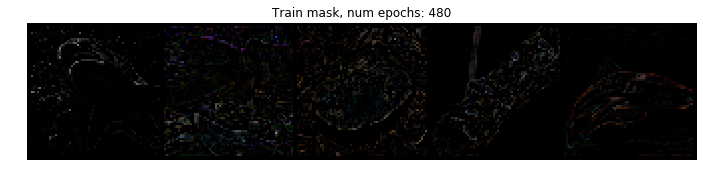

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


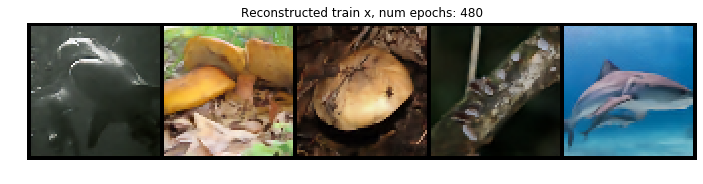

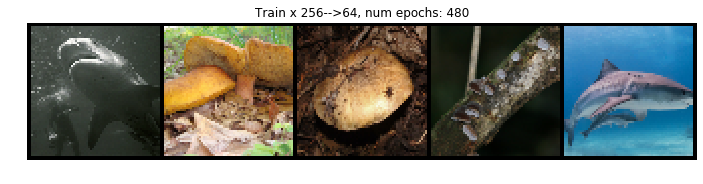

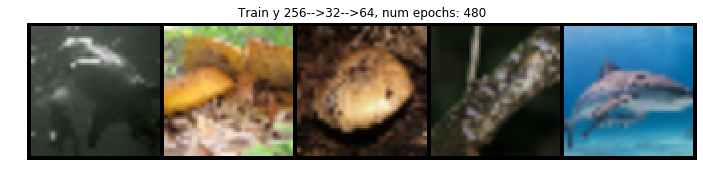

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


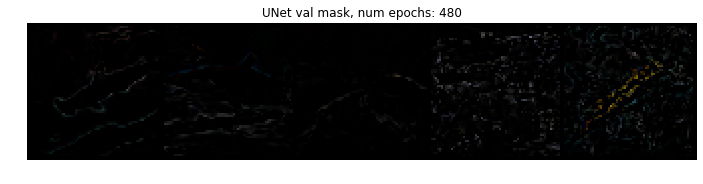

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


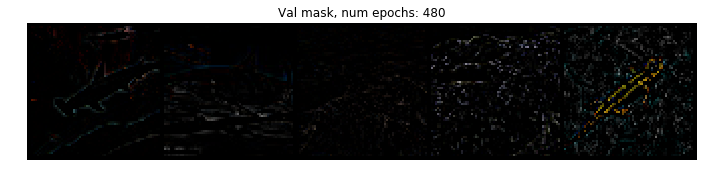

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


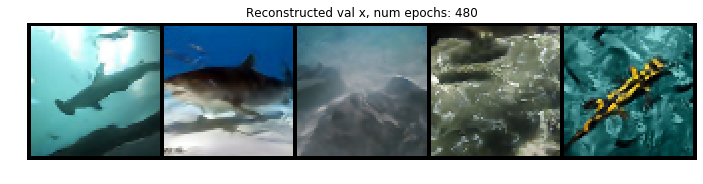

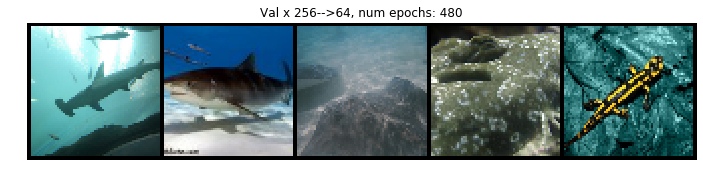

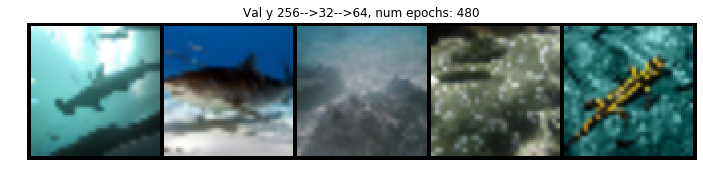

In [20]:
model.train()
model.to(device)
normal = torch.distributions.Normal(0,1)
# reconstruction_function = torch.nn.BCELoss(reduction='sum')
loss_func = torch.nn.MSELoss(reduction='sum')
print("Training for {} epochs...".format(500))
for n in range(0, 500):
    train_loss = 0
    train_recon_loss = 0
    train_kl_loss = 0
    num_examples = 0
    for (i, X) in enumerate(torch_data_loader):
        hr_image = X[0]
        y = F.interpolate(F.interpolate(hr_image, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
        x = F.interpolate(hr_image, args.resolution, mode="bilinear")

        optimizer.zero_grad()
        
        x = x.to(device)
        y = y.to(device)
        x_mask = x - y 
        x_mask_hat = model(y)
        x_hat = y + x_mask_hat
        loss = loss_func(x_mask_hat, x_mask)
        train_loss += loss.item()
#         train_recon_loss += recon_loss.item()
#         train_kl_loss += kl_loss.item()
        num_examples += x_hat.shape[0]
        loss.backward()
        optimizer.step()
    if log:
        wandb.log({'train_loss':train_loss/num_examples})
    
    if args.has_validation:
        model.eval()
        val_loss = 0
        num_examples = 0
        for (i, X) in enumerate(torch_val_data_loader):
            hr_image_val = X[0]
            y_val = F.interpolate(F.interpolate(hr_image_val, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
            x_val = F.interpolate(hr_image_val, args.resolution, mode="bilinear")
            x_val = x_val.to(device)
            y_val = y_val.to(device)
            
            x_mask_val = x_val - y_val
            x_mask_hat_val = model(y_val)
            x_hat_val = y_val + x_mask_hat_val
            loss_val = loss_func(x_mask_hat_val, x_mask_val)
            val_loss += loss_val.item()
            num_examples += x_hat_val.shape[0]
        if log:
            wandb.log({'val_loss':val_loss/num_examples})
        model.train()


    if n%20 ==0:
        model.eval() #evaluate model
                    
        fig = make_grid(x_mask_hat[:5], num_images=5, title='UNet train mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'UNet train mask':fig})
            
        fig = make_grid(x_mask[:5], num_images=5, title='Train mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train mask':fig})   
            
        fig = make_grid(x_hat[:5], num_images=5, title='Reconstructed train x, num epochs: {}'.format(n))
        if log:
            wandb.log({'Reconstructed train x':fig})
            
        fig = make_grid(x[:5], num_images=5, title='Train x 256-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train x 256-->64':fig})
            
        fig = make_grid(y[:5], num_images=5, title='Train y 256-->32-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train y 256-->32-->64':fig})
            
        fig = make_grid(x_mask_hat_val[:5], num_images=5, title='UNet val mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'UNet mask':fig})
            
        fig = make_grid(x_mask_val[:5], num_images=5, title='Val mask, num epochs: {}'.format(n))
        if log:
            wandb.log({'Train mask':fig})   
            
        fig = make_grid(x_hat_val[:5], num_images=5, title='Reconstructed val x, num epochs: {}'.format(n))
        if log:
            wandb.log({'Reconstructed val x':fig})
            
        fig = make_grid(x_val[:5], num_images=5, title='Val x 256-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Val x 256-->64':fig})
            
        fig = make_grid(y_val[:5], num_images=5, title='Val y 256-->32-->64, num epochs: {}'.format(n))
        if log:
            wandb.log({'Val y 256-->32-->64':fig})
        
            
        model.train() #back to training model

In [23]:
torch.save(model, "unet_mask_32_64")

In [5]:
sys.path.insert(0, 'models')
from vae_model_large import VAE, loss_function

In [ ]:
torch.save(model, "unet_mask")

In [6]:
model = torch.load('unet_mask')
model.to(1);

vae = torch.load('VAE_10K_32_HQ')
vae.to(0);

In [9]:
y.shape

torch.Size([5, 3, 256, 256])

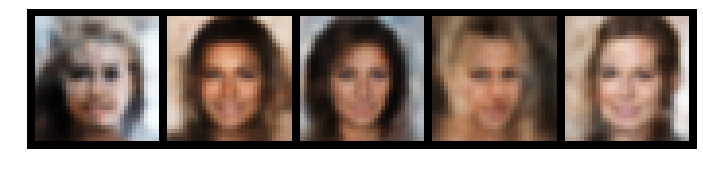

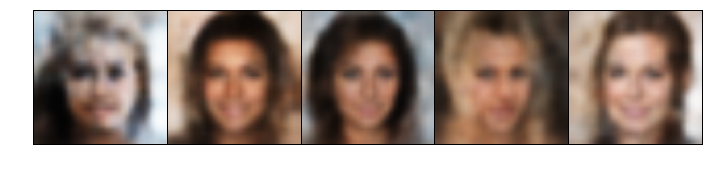

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


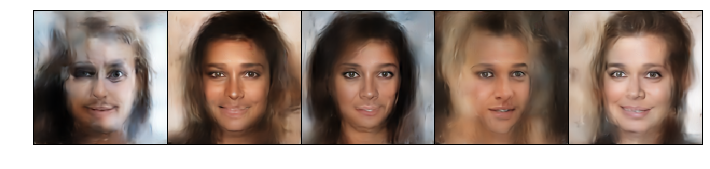

In [10]:
normal = torch.distributions.Normal(0,1)
samples = vae.decode(normal.sample((5,85)).to(0))
make_grid(samples[0:5]);
y = F.interpolate(samples, args.resolution, mode="bilinear")
make_grid(y[0:5]);
y = y.to(1)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);

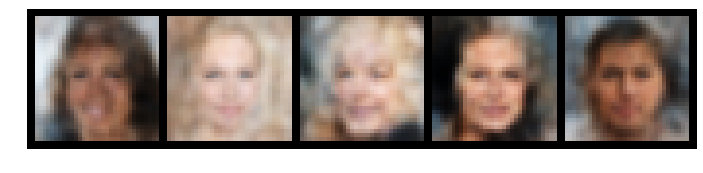

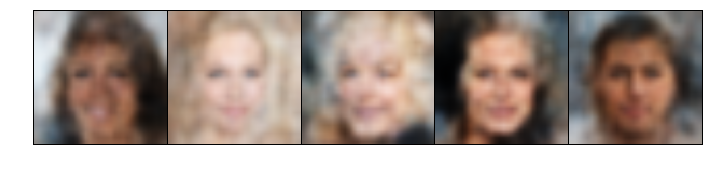

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


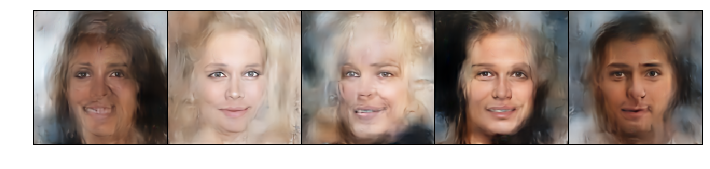

In [11]:
normal = torch.distributions.Normal(0,1)
samples = vae.decode(normal.sample((5,85)).to(0))
make_grid(samples[0:5]);
y = F.interpolate(samples, args.resolution, mode="bilinear")
make_grid(y[0:5]);
y = y.to(1)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);

train real data


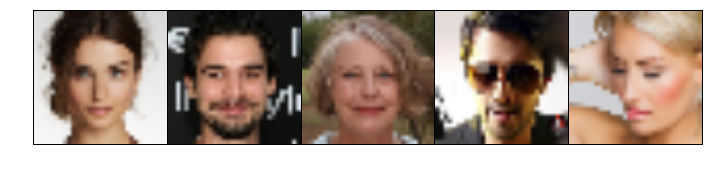

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


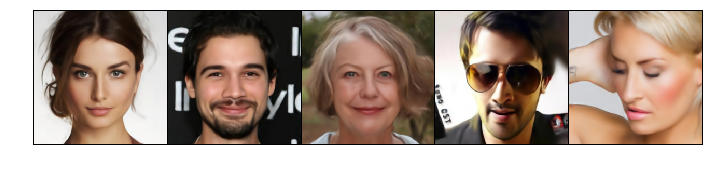

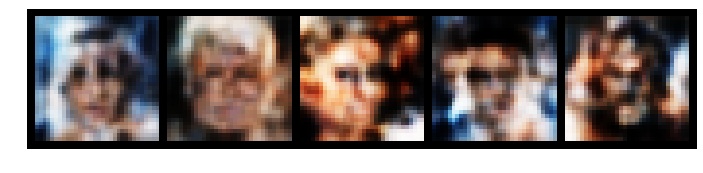

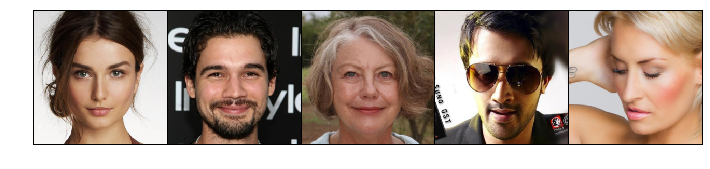

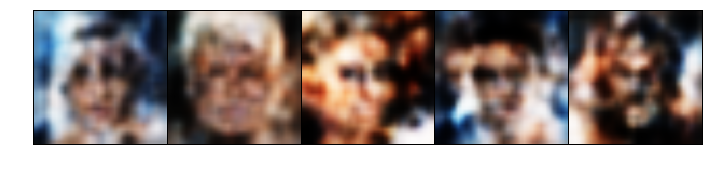

RuntimeError: Expected tensor for argument #1 'input' to have the same device as tensor for argument #2 'weight'; but device 0 does not equal 1 (while checking arguments for cudnn_convolution)

In [39]:
print("train real data")
x = next(iter(torch_data_loader))[0][:5]
y = F.interpolate(F.interpolate(x, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
make_grid(y[0:5]);
y = y.to(1)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);

reconstructions, _, _ = vae(x.to(0))
make_grid(reconstructions[0:5]);
y = F.interpolate(reconstructions, args.resolution, mode="bilinear")
make_grid(x[0:5]);
make_grid(y[0:5]);
y = y.to(0)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);

train real data


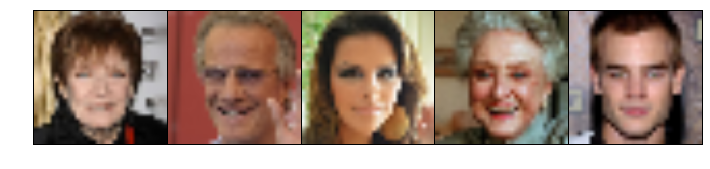

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


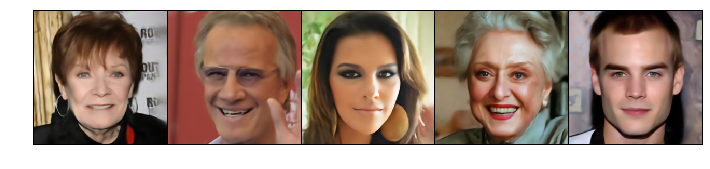

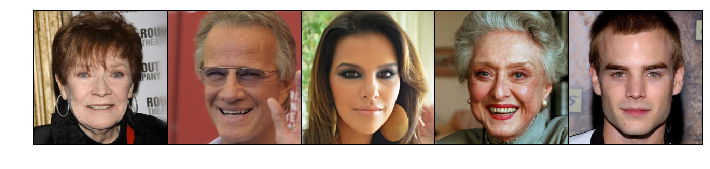

In [34]:
print("train real data")
x = next(iter(torch_data_loader))[0][:5]
y = F.interpolate(F.interpolate(x, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
make_grid(y[0:5]);
y = y.to(1)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);
make_grid(x[0:5]);

Validation real data


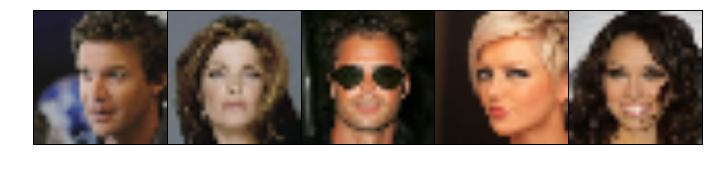

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


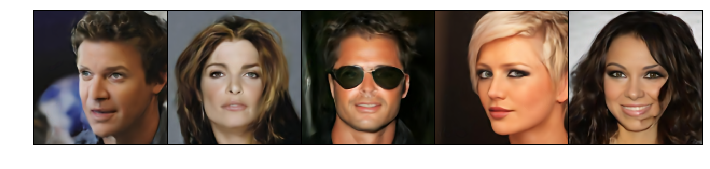

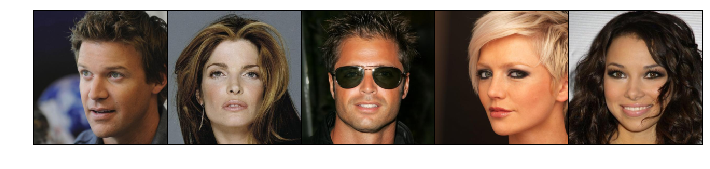

In [33]:
print("Validation real data")
x = next(iter(torch_val_data_loader))[0][:5]
y = F.interpolate(F.interpolate(x, args.low_resolution, mode="bilinear"), args.resolution, mode="bilinear")
make_grid(y[0:5]);
y = y.to(1)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);
make_grid(x[0:5]);

In [ ]:
normal = torch.distributions.Normal(0,1)
samples = vae.decode(normal.sample((5,85)).to(0))
make_grid(samples[0:5]);
y = F.interpolate(samples, args.resolution, mode="bilinear")
make_grid(y[0:5]);
y = y.to(1)
x_mask_hat = model(y)
x_hat = y + x_mask_hat
make_grid(x_hat[0:5]);